In [5]:
import datetime as dt
from concurrent.futures import ProcessPoolExecutor
import numpy as np
import pandas as pd
import xlwings as xw
import pymysql
import calendar
import json
import math
import matplotlib.pyplot as plt
from scipy import optimize
import sys


pd.options.display.float_format = '{:.4f}'.format

In [6]:
class technical_indicator():

    def __init__(self, close_prices, open_prices = None, high_prices = None, low_prices = None, volumes = None) :
        self.close_prices = list(close_prices)
        self.open_prices = list(open_prices) if open_prices is not None else open_prices
        self.high_prices = list(high_prices) if high_prices is not None else high_prices
        self.low_prices = list(low_prices) if low_prices is not None else low_prices
        self.volumes = list(volumes) if volumes is not None else volumes

    def ema(self, n) :
        
        EMA = []
        alpha = 2/(round(n)+1)

        for i in range(len(self.close_prices)):

            ema_denominator = 0
            ema_nominator = 0
            count = 0
            if len(self.close_prices[:i+1]) < n:
                EMA.append(np.nan)
            else :
                while (count < n):
                    ema_denominator += self.close_prices[i-count] * ((1-alpha)**count)
                    ema_nominator += 1*((1-alpha)**count)
                    count += 1
                EMA.append(ema_denominator/ema_nominator)
        
        return EMA

    def dema(self, n):
    
        EMA_t_1 = self.ema(n)
        dEMA = []
        for i in range(len(self.open_prices)):
            if i >= 1:
                dEMA.append(self.open_prices[i]-EMA_t_1[i-1])
            else :
                dEMA.append(np.nan)
        return dEMA

    def hbar(self, m):

        HBar = []

        for i in range(len(self.close_prices)):

            hbar_nominator = 0
            fh_nominator = 0
            count = 0 
            if len(self.close_prices[:i]) < m+1:
                HBar.append(np.nan)
            else :
                num1 = self.close_prices[i-1]-self.open_prices[i-1]
                num2 = self.high_prices[i-1]-self.low_prices[i-1]
                if (num2 == 0):
                    HBar.append(np.nan)
                    continue
                hbar_denominator = abs(num1)
                fh_denominator = num1/num2
                while (count < m):
                    num1 = abs(self.close_prices[i-count-2]-self.open_prices[i-count-2])
                    num2 = (self.high_prices[i-count-2]-self.low_prices[i-count-2])
                    if (num1 == 0) or (num2 == 0):
                        count += 1
                        continue                    
                    hbar_nominator += num1
                    fh_nominator += num1/num2
                    count += 1

                if (hbar_nominator == 0) or (fh_nominator == 0):
                    HBar.append(np.nan)
                    continue
                else:
                    HBar_ = hbar_denominator/(hbar_nominator/m)
                    fH_ = fh_denominator/(fh_nominator/m)
                    if fH_ > 1:
                        fH = 1
                    elif fH_ < -1:
                        fH = -1
                    elif fH_ == 0:
                        fH = 0
                    else : 
                        fH = fH_
                    hbar = HBar_*fH
                    HBar.append(hbar)
        return HBar

    def iv(self, k, d):

        iV = []
        for i in range(len(self.volumes)):

            iV_denominator = 0
            iV_nominator = 0
            count = 0
            if len(self.volumes[:i]) < d:
                iV.append(np.nan)
            else :
                while (count < d):
                    if count < k:
                        iV_nominator += self.volumes[i-1-count]
                        iV_denominator += self.volumes[i-1-count]
                    else :
                        iV_nominator += self.volumes[i-1-count]
                    count += 1
                iV.append((d*iV_denominator)/(k*iV_nominator))
        return iV

    def sma(self, b, fsd):

        SMA = []
        for i in range(len(self.close_prices)):
            count = int(b)
            sma = 0 
            if i >= b-1:
                while (count != 0):
                    sma += self.close_prices[i-count+1]
                    count -= 1
                sma /= b
                SMA.append(sma)
            else :
                SMA.append(np.nan)    
        
        UpLine = []
        DownLine = []
        multiple = []

        for i in range(len(self.close_prices)):
            count = int(b)
            base = 0
            if np.isnan(SMA[i]):
                UpLine.append(np.nan)
                DownLine.append(np.nan)
                multiple.append(np.nan)
            else : 
                while (count > 0):
                    base += (self.close_prices[i-count+1]-SMA[i])**2
                    count -= 1
                upline = SMA[i] + fsd*np.sqrt(base/b)
                downline = SMA[i] - fsd*np.sqrt(base/b)
                square_term = np.sqrt(base/b)
                UpLine.append(upline)
                DownLine.append(downline)
                multiple.append((self.close_prices[i]-SMA[i])/square_term)
        return SMA, UpLine, DownLine, multiple
    
    def period_vol(self):
        
        df_temp = pd.DataFrame(self.close_prices, columns = ['close_prices'])
        df_temp['return'] = np.log(df_temp['close_prices']) - np.log(df_temp['close_prices'].shift(1))
        vol = df_temp['return'].std()

        diff = []
        for i in range(len(self.close_prices)):
            diff.append(abs(self.close_prices[i] - self.open_prices[i])/self.open_prices[i])
        max_diff = np.array(diff).max()
        mean_diff = np.array(diff).mean()
        
        max_price = np.array(self.close_prices).max()
        min_price = np.array(self.close_prices).min()
        min_max_ratio = (max_price - min_price)/min_price

        return vol, max_diff, mean_diff, min_max_ratio





In [7]:
def split_dataframe(df, learning_period_size, testing_period_size):
    learning_period_list = []
    testing_period_list = []
    
    total_rows = len(df)
    start_idx = 0
    
    while start_idx + learning_period_size <= total_rows:
        # 학습 구간 추출
        learning_period = df.iloc[start_idx:start_idx + learning_period_size]
        learning_period_list.append(learning_period)
        
        # 테스트 구간 추출
        end_idx = start_idx + learning_period_size + testing_period_size
        if end_idx > total_rows:
            testing_period = df.iloc[start_idx + learning_period_size:]
        else:
            testing_period = df.iloc[start_idx + learning_period_size:end_idx]
        
        testing_period_list.append(testing_period)
        
        # 다음 윈도우로 이동 (롤링 방식)
        start_idx += testing_period_size
    
    return learning_period_list, testing_period_list

def mem_func(kind, indicator, series):

    if kind in ['dEMA', 'HBar' ,'SMA']:

        return sell_indicator(indicator, series[0], series[2]), hold_indicator(indicator, series[1], series[3], series[4], series[6]), buy_indicator(indicator, series[5], series[7])

    elif kind in ['iV']:

        return buy_indicator(indicator, series[1], series[3]), sell_indicator(indicator, series[0], series[2]), buy_indicator(indicator, series[1], series[3])


def sell_indicator(indicator, N1, N3):
    if indicator <= N1:
        return 1
    elif indicator < N3:
        return 1 - (indicator-N1)*1/abs(N3-N1) 
    elif np.isnan(indicator):
        return np.nan
    else :
        return 0
    
def hold_indicator(indicator, N2, N4, N5, N7):
    if (indicator <= N2) or (indicator >= N7):
        return 0
    elif (indicator < N4):
        return (indicator-N2)*1/abs(N4-N2)
    elif (indicator <= N5):
        return 1
    elif np.isnan(indicator):
        return np.nan  
    else :
        return 1-(indicator-N5)*1/abs(N7-N5)
    
def buy_indicator(indicator, N6, N8):
    if (indicator <= N6):
        return 0
    elif (indicator < N8):
        return (indicator-N6)*1/abs(N8-N6)
    elif np.isnan(indicator):
        return np.nan  
    else :
        return 1
    
def get_boundaries(lst, sort):
    # 리스트 정렬
    sorted_lst = sorted(lst)
    # 리스트 길이
    n = len(sorted_lst)
    # 9등분할 때의 각 경계 인덱스
    boundaries = [sorted_lst[int(n * i / sort)] for i in range(1, sort)]
    return boundaries

def E_H_series_initial(lst):

    initial_list = get_boundaries(lst, 9)
    if (initial_list[3] >= 0) or (pd.isna(initial_list[3])):
        negative_list = [elm for elm in lst if elm < 0]
        negative_list = get_boundaries(negative_list, 5)
        initial_list[:4] = negative_list

    if (initial_list[4] <= 0) or (pd.isna(initial_list[4])):
        positive_list = [elm for elm in lst if elm > 0]
        positive_list = get_boundaries(positive_list, 5)
        initial_list[4:] = positive_list

    return initial_list

def iV_series_initial(lst):

    initial_list = get_boundaries(lst, 5)

    return initial_list
    
def B_series_initial(b, fsd, lst):

    initial_list = np.zeros(8)

    b_upper = [elm for elm in lst if elm >= fsd]
    b_middle = [elm for elm in lst if (elm >= -fsd) & (elm < fsd)]
    b_lower = [elm for elm in lst if elm < -fsd]

    if len(b_upper) < 2:
        if len(b_lower) < 2:
            initial_list = get_boundaries(b_middle, 9)
        else :
            initial_list[:2] = get_boundaries(b_lower, 3)
            initial_list[2:] = get_boundaries(b_middle, 7)
    else : 
        if len(b_lower) < 2:
            initial_list[6:] = get_boundaries(b_upper, 3)
            initial_list[:6] = get_boundaries(b_middle, 7)
        else :
            initial_list[6:] = get_boundaries(b_upper, 3)
            initial_list[2:6] = get_boundaries(b_middle, 5)
            initial_list[:2] = get_boundaries(b_lower, 3)

    return list(initial_list)





In [9]:
# MySQL 서버에 연결
connection = pymysql.connect(
    host="127.0.0.1",  # MySQL 서버의 주소
    user="root",        # MySQL 사용자 이름
    port=3306,
    database='crypto',
    password="cdfha!3579",  # 비밀번호
    charset='utf8'
)
cur = connection.cursor()

query = "SELECT * FROM btcusdt1mf"
df = pd.read_sql(query, connection)

# 데이터 출력 확인
print(df)

# 연결 종료
connection.close()

df['Open time'] = pd.to_datetime(df['Open time'], unit ='ms')
df.set_index('Open time', inplace=True)
df = df[df['Volume'] > 0]



C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\467272929.py:13: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(query, connection)


             Open time       Open       High        Low      Close    Volume  \
0        1577750400000  7240.8000  7240.8000  7211.0000  7213.3700  667.3230   
1        1577750460000  7213.3700  7218.9100  7190.0000  7209.3900 1441.5500   
2        1577750520000  7209.7500  7211.3300  7200.0000  7204.2000  231.4940   
3        1577750580000  7204.0200  7213.1400  7201.7800  7213.1400  168.9620   
4        1577750640000  7213.1400  7215.0000  7203.7200  7204.1600  187.7760   
...                ...        ...        ...        ...        ...       ...   
2563195  1731542100000 90313.6000 90414.4000 90313.6000 90370.0000  103.8760   
2563196  1731542160000 90370.0000 90439.2000 90370.0000 90392.1000   60.4210   
2563197  1731542220000 90392.1000 90450.0000 90372.7000 90436.1000   73.6300   
2563198  1731542280000 90436.0000 90663.6000 90429.1000 90488.3000  535.0820   
2563199  1731542340000 90488.3000 90498.4000 90401.3000 90413.3000   81.7460   

            Close time  Quote asset vol

In [10]:
def profit_optimization(params, df_l):

    n, E1, E2, E3, E4, E5, E6, E7, E8 = round(params[0]), params[1], params[2], params[3], params[4], params[5], params[6], params[7], params[8]
    m, H1, H2, H3, H4, H5, H6, H7, H8 = round(params[9]), params[10], params[11], params[12], params[13], params[14], params[15], params[16], params[17]
    k, d, V1, V2, V3, V4 = round(params[18]), round(params[19]), params[20], params[21], params[22], params[23]
    b, fsd, B1, B2, B3, B4, B5, B6, B7, B8 = round(params[24]), params[25], params[26], params[27], params[28], params[29], params[30], params[31], params[32], params[33]

    E_series = [E1, E2, E3, E4, E5, E6, E7, E8]
    H_series = [H1, H2, H3, H4, H5, H6, H7, H8]
    V_series = [V1, V2, V3, V4]
    B_series = [B1, B2, B3, B4, B5, B6, B7, B8]

    tech = technical_indicator(df_l['Close'], df_l['Open'], df_l['High'], df_l['Low'], df_l['Volume'])
    df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
    df_l['td'] = df_l['m_buy'] = df_l['m_hold'] = df_l['m_sell'] = None
    current_position = None
    entry_price = 0
    pl = 0 
    td = []
    index_list = df_l.index

    for index, row in df_l.iterrows():

        dEMA_memb_func = [mem_func(('dEMA'),row['dema'],E_series)[0], mem_func(('dEMA'),row['dema'],E_series)[1], mem_func(('dEMA'),row['dema'],E_series)[2]]
        HBar_mem_func = [mem_func(('HBar'),row['hbar'],H_series)[0], mem_func(('HBar'),row['hbar'],H_series)[1], mem_func(('HBar'),row['hbar'],H_series)[2]]
        iV_mem_func = [mem_func(('iV'),row['iv'],V_series)[0], mem_func(('iV'),row['iv'],V_series)[1], mem_func(('iV'),row['iv'],V_series)[2]]
        SMA_mem_func = [mem_func(('SMA'),row['Multiple'],B_series)[0], mem_func(('SMA'),row['Multiple'],B_series)[1], mem_func(('SMA'),row['Multiple'],B_series)[2]]

        for num, m in enumerate(['m_buy', 'm_hold', 'm_sell']):
            td_function = []
            for k in [dEMA_memb_func, HBar_mem_func, iV_mem_func, SMA_mem_func]:
                if np.isnan(k[num]):
                    pass
                else :
                    td_function.append(k[num])
            average = np.mean(td_function)
            row[m] = average

        values = {'buy': row['m_buy'], 'hold': row['m_hold'], 'sell': row['m_sell']}
        filtered_values = {k: v for k, v in values.items() if not np.isnan(v)}

        if filtered_values:  # 빈 경우 (모든 값이 NaN) 처리
            max_key = max(filtered_values, key=filtered_values.get)
            row['td'] = max_key 
        else:
            row['td'] = np.nan
        td.append(row['td'])

        current_idx = index_list.get_loc(index)
        if current_idx+1 <len(df_l):
            
            next_index = index_list[current_idx+1]
            next_row = df_l.loc[next_index]
            if row['td'] == 'buy':
                if current_position == 'sell':
                    # 매도 포지션 청산
                    pl += entry_price - next_row['Open']
                    #current_position = None 포지션만 청산
                    current_position = 'buy' #reverse
                    entry_price = next_row['Open']
                elif current_position == 'buy':
                    pass
                elif current_position == None :
                    current_position = 'buy'
                    entry_price = next_row['Open']

                        
            elif row['td'] == 'sell':
                if current_position == 'buy':
                    # 매수 포지션 청산
                    pl += next_row['Open'] - entry_price
                    #current_position = None
                    current_position = 'sell'
                    entry_price = next_row['Open']

                elif current_position == 'sell':

                    pass
                elif current_position == None :
                    current_position = 'sell'

                    entry_price = next_row['Open']
        else:
            if current_position == 'buy':
            # 매수 포지션 청산
                pl += row['Close'] - entry_price
            elif current_position == 'sell':
            # 매도 포지션 청산
                pl += entry_price - row['Close']

            
    """
    df_l['real poisition'] = real_position
    df_l['td'] = td
    plt.figure(figsize=(20, 12))
    plt.plot(df_l['Close'], label='Open Price', color='blue')

    # buy 시점을 빨간색 점으로 표시
    buy_signals = df_l[df_l['real poisition'] == 'buy']
    plt.scatter(buy_signals.index, buy_signals['Close'], color='red', label='Buy', marker='o', s=30)

    # sell 시점을 초록색 점으로 표시
    sell_signals = df_l[df_l['real poisition'] == 'sell']
    plt.scatter(sell_signals.index, sell_signals['Close'], color='green', label='Sell', marker='o', s=30)

    buy_stoploss_signals = df_l[df_l['real poisition'] == 'buy position stoploss']
    plt.scatter(buy_stoploss_signals.index, buy_stoploss_signals['Close'], color='pink', label='Buy', marker='o', s=30)

    sell_stoploss_signals = df_l[df_l['real poisition'] == 'sell position stoploss']
    plt.scatter(sell_stoploss_signals.index, sell_stoploss_signals['Close'], color='blue', label='Buy', marker='o', s=30)
    """
    return -pl


def profit_calculation(params, df_l):

    n, E1, E2, E3, E4, E5, E6, E7, E8 = round(params[0]), params[1], params[2], params[3], params[4], params[5], params[6], params[7], params[8]
    m, H1, H2, H3, H4, H5, H6, H7, H8 = round(params[9]), params[10], params[11], params[12], params[13], params[14], params[15], params[16], params[17]
    k, d, V1, V2, V3, V4 = round(params[18]), round(params[19]), params[20], params[21], params[22], params[23]
    b, fsd, B1, B2, B3, B4, B5, B6, B7, B8 = round(params[24]), params[25], params[26], params[27], params[28], params[29], params[30], params[31], params[32], params[33]

    E_series = [E1, E2, E3, E4, E5, E6, E7, E8]
    H_series = [H1, H2, H3, H4, H5, H6, H7, H8]
    V_series = [V1, V2, V3, V4]
    B_series = [B1, B2, B3, B4, B5, B6, B7, B8]

    tech = technical_indicator(df_l['Close'], df_l['Open'], df_l['High'], df_l['Low'], df_l['Volume'])
    df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
    df_l['td'] = df_l['m_buy'] = df_l['m_hold'] = df_l['m_sell'] = None
    current_position = None
    entry_price = 0
    pl = 0 
    td = []
    real_position = []
    index_list = df_l.index

    for index, row in df_l.iterrows():

        dEMA_memb_func = [mem_func(('dEMA'),row['dema'],E_series)[0], mem_func(('dEMA'),row['dema'],E_series)[1], mem_func(('dEMA'),row['dema'],E_series)[2]]
        HBar_mem_func = [mem_func(('HBar'),row['hbar'],H_series)[0], mem_func(('HBar'),row['hbar'],H_series)[1], mem_func(('HBar'),row['hbar'],H_series)[2]]
        iV_mem_func = [mem_func(('iV'),row['iv'],V_series)[0], mem_func(('iV'),row['iv'],V_series)[1], mem_func(('iV'),row['iv'],V_series)[2]]
        SMA_mem_func = [mem_func(('SMA'),row['Multiple'],B_series)[0], mem_func(('SMA'),row['Multiple'],B_series)[1], mem_func(('SMA'),row['Multiple'],B_series)[2]]

        for num, m in enumerate(['m_buy', 'm_hold', 'm_sell']):
            td_function = []
            for k in [dEMA_memb_func, HBar_mem_func, iV_mem_func, SMA_mem_func]:
                if np.isnan(k[num]):
                    pass
                else :
                    td_function.append(k[num])
            average = np.mean(td_function)
            row[m] = average

        values = {'buy': row['m_buy'], 'hold': row['m_hold'], 'sell': row['m_sell']}
        filtered_values = {k: v for k, v in values.items() if not np.isnan(v)}

        if filtered_values:  # 빈 경우 (모든 값이 NaN) 처리
            max_key = max(filtered_values, key=filtered_values.get)
            row['td'] = max_key 
        else:
            row['td'] = np.nan
        td.append(row['td'])

        current_idx = index_list.get_loc(index)
        if current_idx+1 <len(df_l):
            
            next_index = index_list[current_idx+1]
            next_row = df_l.loc[next_index]
            if row['td'] == 'buy':
                if current_position == 'sell':
                    # 매도 포지션 청산
                    pl += entry_price - next_row['Open']
                    #current_position = None
                    current_position = 'buy'
                    entry_price = next_row['Open']
                    real_position.append('buy')
                elif current_position == 'buy':
                    real_position.append('hold')
                    pass
                elif current_position == None :
                    current_position = 'buy'
                    entry_price = next_row['Open']
                    real_position.append('buy')
                        
            elif row['td'] == 'sell':
                if current_position == 'buy':
                    # 매수 포지션 청산
                    pl += next_row['Open'] - entry_price
                    #current_position = None
                    current_position = 'sell'
                    entry_price = next_row['Open']
                    real_position.append('sell')
                elif current_position == 'sell':
                    real_position.append('hold')
                    pass
                elif current_position == None :
                    current_position = 'sell'
                    real_position.append('sell')
                    entry_price = next_row['Open']
            else:
                real_position.append('hold')

            if (current_position == 'buy') & ((row['Close'] - entry_price) <= -entry_price*0.01):
                pl += next_row['Open'] - entry_price
                current_position = None
                real_position.pop()
                real_position.append('buy position stoploss')

            elif (current_position == 'sell') & ((entry_price - row['Close']) <= -entry_price*0.01):
                pl += entry_price - next_row['Open']
                current_position = None
                real_position.pop()
                real_position.append('sell position stoploss')
            
            #if pl <= -row['Close'] * 0.05: #그날 트레이딩 접어버리기
                #return pl, df_l 
        
        else:
            if current_position == 'buy':
            # 매수 포지션 청산
                pl += row['Close'] - entry_price
                real_position.append('sell')
            elif current_position == 'sell':
            # 매도 포지션 청산
                pl += entry_price - row['Close']
                real_position.append('buy')
            else:
                real_position.append('hold')



        print(index, " : ",next_row['Open'], "current position : ", current_position ," pl : ", pl)
                
    df_l['real position'] = real_position
    df_l['real position'] = df_l['real position'].shift(1)
    df_l['td'] = td
    plt.figure(figsize=(15, 10))
    plt.plot(df_l['Open'], label='Open Price', color='blue')

    # buy 시점을 빨간색 점으로 표시
    buy_signals = df_l[df_l['real position'] == 'buy']
    plt.scatter(buy_signals.index, buy_signals['Open'], color='red', label='Buy', marker='o', s=30)

    # sell 시점을 초록색 점으로 표시
    sell_signals = df_l[df_l['real position'] == 'sell']
    plt.scatter(sell_signals.index, sell_signals['Open'], color='green', label='Sell', marker='o', s=30)

    buy_stoploss_signals = df_l[df_l['real position'] == 'buy position stoploss']
    plt.scatter(buy_stoploss_signals.index, buy_stoploss_signals['Open'], color='orange', label='Buy', marker='o', s=30)

    sell_stoploss_signals = df_l[df_l['real position'] == 'sell position stoploss']
    plt.scatter(sell_stoploss_signals.index, sell_stoploss_signals['Open'], color='black', label='Buy', marker='o', s=30)

    return pl, df_l



In [66]:
def rule_base_trading(dataframe, n_learning_days, n_testing_days, stoploss = None):

    n_learning = n_learning_days * 1440 
    n_testing= n_testing_days * 1440

    learning_period_list = []
    testing_period_list = []

    i = 0
    while i < len(dataframe):
    # n1 크기로 자르기
        if i + n_learning <= len(dataframe):
            learning_period_list.append(dataframe.iloc[i:i + n_learning])
        else :
            break
        i += n_learning
        
        # n2 크기로 자르기
        if i + n_testing <= len(dataframe):
            testing_period_list.append(dataframe.iloc[i:i + n_testing])
        else:
            # 남은 부분이 n2보다 작으면 그대로 추가
            testing_period_list.append(dataframe.iloc[i:])
        i += n_testing

    parameters_dict = dict()
    for count in range(len(learning_period_list)):

        df_learning = learning_period_list[count]
        df_testing = testing_period_list[count]
        print('learning period : ' , df_learning.index[0], ' ~ ', df_learning.index[-1])
        print('testing period : ' , df_testing.index[0], ' ~ ', df_testing.index[-1])

        tech = technical_indicator(df_learning['Close'], df_learning['Open'], df_learning['High'], df_learning['Low'], df_learning['Volume'])

        #n, m, k, d, b, fsd
        init_params = [10, 10, 5, 10, 20, 2]
        dema = tech.dema(init_params[0])
        hbar = tech.hbar(init_params[1])
        iv = tech.iv(init_params[2], init_params[3])
        multiple = tech.sma(init_params[4], init_params[5])[3]

        upper_multiple = [i for i in multiple if i>init_params[5]]
        lower_multiple = [i for i in multiple if i<-init_params[5]]

        if (len(upper_multiple) < 2) or (len(lower_multiple) < 2):
            init_params[6] = (get_boundaries(multiple,8)[6]-get_boundaries(multiple,8)[2])/2

        e_series_initial = E_H_series_initial(dema)
        h_series_initial = E_H_series_initial(hbar)
        iv_series_initial = iV_series_initial(iv)        
        b_series_initial = B_series_initial(init_params[4], init_params[5], multiple)

        initials = [init_params[0]] + e_series_initial + [init_params[1]] + h_series_initial + [init_params[2], init_params[3]] + iv_series_initial + [init_params[4], init_params[5]] + b_series_initial

        cons = [{'type': 'ineq', 'fun': lambda parameters: parameters[8] - parameters[7]}, {'type': 'ineq', 'fun': lambda parameters: parameters[7] - parameters[6]}, {'type': 'ineq', 'fun': lambda parameters: parameters[6] - parameters[5]}, {'type': 'ineq', 'fun': lambda parameters: parameters[4] - parameters[3]},
                {'type': 'ineq', 'fun': lambda parameters: parameters[3] - parameters[2]}, {'type': 'ineq', 'fun': lambda parameters: parameters[2] - parameters[1]}, {'type': 'ineq', 'fun': lambda parameters: parameters[17] - parameters[16]}, {'type': 'ineq', 'fun': lambda parameters: parameters[16] - parameters[15]}, 
                {'type': 'ineq', 'fun': lambda parameters: parameters[15] - parameters[14]}, {'type': 'ineq', 'fun': lambda parameters: parameters[13] - parameters[12]}, {'type': 'ineq', 'fun': lambda parameters: parameters[12] - parameters[11]}, {'type': 'ineq', 'fun': lambda parameters: parameters[11] - parameters[10]},
                {'type': 'ineq', 'fun': lambda parameters: parameters[23] - parameters[22]}, {'type': 'ineq', 'fun': lambda parameters: parameters[22] - parameters[21]}, {'type': 'ineq', 'fun': lambda parameters: parameters[21] - parameters[20]}, {'type': 'ineq', 'fun': lambda parameters: parameters[33] - parameters[32]}, 
                {'type': 'ineq', 'fun': lambda parameters: parameters[32] - parameters[31]}, {'type': 'ineq', 'fun': lambda parameters: parameters[31] - parameters[30]}, {'type': 'ineq', 'fun': lambda parameters: parameters[30] - parameters[29]}, {'type': 'ineq', 'fun': lambda parameters: parameters[29] - parameters[28]}, 
                {'type': 'ineq', 'fun': lambda parameters: parameters[28] - parameters[27]}, {'type': 'ineq', 'fun': lambda parameters: parameters[27] - parameters[26]}, {'type': 'ineq', 'fun': lambda parameters: parameters[19] - parameters[18]}, {'type': 'ineq', 'fun': lambda parameters: parameters[32] - init_params[5]}, 
                {'type': 'ineq', 'fun': lambda parameters: init_params[5] - parameters[31]}, {'type': 'ineq', 'fun': lambda parameters: parameters[28] + init_params[5]}, {'type': 'ineq', 'fun': lambda parameters: - init_params[5] - parameters[27]}]

        bounds = [(0, 30), (None, 0), (None, 0), (None, 0), (None, 0), (0, None), (0, None), (0, None), (0, None),    
                  (0, 30), (None, 0), (None, 0), (None, 0), (None, 0), (0, None), (0, None), (0, None), (0, None),
                  (0, 30), (0, 30), (0.9, 1.1), (0, None), (0, None), (0, None),
                  (0, 30), (1, 3), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None)]
        
        sol = optimize.minimize(lambda x: profit_optimization(x, df_learning), initials, method = 'COBYLA', bounds=bounds, constraints=cons)
        parameters_dict[df_learning.index[0]] = list(sol.x)

    return parameters_dict, learning_period_list, testing_period_list

In [191]:
parameters_dict, learning_period_list, testing_period_list = rule_base_trading(df, 60, 30, stoploss = None)

learning period :  2017-08-17 04:00:00  ~  2017-10-31 16:31:00
testing period :  2017-10-31 16:32:00  ~  2017-12-01 20:19:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_9400\3723746083.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ema'], df['dema'], df['hbar'], df['iv'], df['sma'], df['Upline'], df['Downline'], df['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_9400\3723746083.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ema'], df['dema'], df['h

ValueError: Length of values (86381) does not match length of index (86400)

In [ ]:
learning_period_size = 1 * 1440 #3분봉, 1분봉은 1440
testing_period_size= 1 * 1440 #3분봉, 1분봉은 1440

learning_period_list = []
testing_period_list = []

learning_period_list, testing_period_list = split_dataframe(df, learning_period_size, testing_period_size)

pl_list = []
df_list = []
params_list = []

learning_vol_list = []
learning_max_diff_list = []
learning_mean_diff_list = []
learning_minmax_ratio_list = []

testing_vol_list = []
testing_max_diff_list = []
testing_mean_diff_list = []
testing_minmax_ratio_list = []

index_list = df.index
for i in range(365):
    df_learning = learning_period_list[-365+i]
    df_testing = testing_period_list[-365+i]
    print('learning period : ' , df_learning.index[0], ' ~ ', df_learning.index[-1])
    print('testing period : ' , df_testing.index[0], ' ~ ', df_testing.index[-1])

    tech = technical_indicator(df_learning['Close'], df_learning['Open'], df_learning['High'], df_learning['Low'], df_learning['Volume'])

    learning_vol_list.append(tech.period_vol()[0])
    learning_max_diff_list.append(tech.period_vol()[1])
    learning_mean_diff_list.append(tech.period_vol()[2])
    learning_minmax_ratio_list.append(tech.period_vol()[3])

    tech_test = technical_indicator(df_testing['Close'], df_testing['Open'], df_testing['High'], df_testing['Low'], df_testing['Volume'])

    testing_vol_list.append(tech_test.period_vol()[0])
    testing_max_diff_list.append(tech_test.period_vol()[1])
    testing_mean_diff_list.append(tech_test.period_vol()[2])
    testing_minmax_ratio_list.append(tech_test.period_vol()[3])

    #n, m, k, d, b, fsd
    init_params = [10, 10, 5, 10, 20, 2]
    dema = tech.dema(init_params[0])
    hbar = tech.hbar(init_params[1])
    iv = tech.iv(init_params[2], init_params[3])
    multiple = tech.sma(init_params[4], init_params[5])[3]
    
    upper_multiple = [i for i in multiple if i>init_params[5]]
    lower_multiple = [i for i in multiple if i<-init_params[5]]

    if (len(upper_multiple) < 2) or (len(lower_multiple) < 2):
        init_params[5] = (get_boundaries(multiple,8)[6]-get_boundaries(multiple,8)[2])/2

    e_series_initial = E_H_series_initial(dema)
    h_series_initial = E_H_series_initial(hbar)
    iv_series_initial = iV_series_initial(iv)        
    b_series_initial = B_series_initial(init_params[4], init_params[5], multiple)

    initials = [init_params[0]] + e_series_initial + [init_params[1]] + h_series_initial + [init_params[2], init_params[3]] + iv_series_initial + [init_params[4], init_params[5]] + b_series_initial

    cons = [{'type': 'ineq', 'fun': lambda parameters: parameters[8] - parameters[7]}, {'type': 'ineq', 'fun': lambda parameters: parameters[7] - parameters[6]}, {'type': 'ineq', 'fun': lambda parameters: parameters[6] - parameters[5]}, {'type': 'ineq', 'fun': lambda parameters: parameters[4] - parameters[3]},
            {'type': 'ineq', 'fun': lambda parameters: parameters[3] - parameters[2]}, {'type': 'ineq', 'fun': lambda parameters: parameters[2] - parameters[1]}, {'type': 'ineq', 'fun': lambda parameters: parameters[17] - parameters[16]}, {'type': 'ineq', 'fun': lambda parameters: parameters[16] - parameters[15]}, 
            {'type': 'ineq', 'fun': lambda parameters: parameters[15] - parameters[14]}, {'type': 'ineq', 'fun': lambda parameters: parameters[13] - parameters[12]}, {'type': 'ineq', 'fun': lambda parameters: parameters[12] - parameters[11]}, {'type': 'ineq', 'fun': lambda parameters: parameters[11] - parameters[10]},
            {'type': 'ineq', 'fun': lambda parameters: parameters[23] - parameters[22]}, {'type': 'ineq', 'fun': lambda parameters: parameters[22] - parameters[21]}, {'type': 'ineq', 'fun': lambda parameters: parameters[21] - parameters[20]}, {'type': 'ineq', 'fun': lambda parameters: parameters[33] - parameters[32]}, 
            {'type': 'ineq', 'fun': lambda parameters: parameters[32] - parameters[31]}, {'type': 'ineq', 'fun': lambda parameters: parameters[31] - parameters[30]}, {'type': 'ineq', 'fun': lambda parameters: parameters[30] - parameters[29]}, {'type': 'ineq', 'fun': lambda parameters: parameters[29] - parameters[28]}, 
            {'type': 'ineq', 'fun': lambda parameters: parameters[28] - parameters[27]}, {'type': 'ineq', 'fun': lambda parameters: parameters[27] - parameters[26]}, {'type': 'ineq', 'fun': lambda parameters: parameters[19] - parameters[18]}, {'type': 'ineq', 'fun': lambda parameters: parameters[32] - init_params[5]}, 
            {'type': 'ineq', 'fun': lambda parameters: init_params[5] - parameters[31]}, {'type': 'ineq', 'fun': lambda parameters: parameters[28] + init_params[5]}, {'type': 'ineq', 'fun': lambda parameters: - init_params[5] - parameters[27]}]

    bounds = [(0, 30), (None, 0), (None, 0), (None, 0), (None, 0), (0, None), (0, None), (0, None), (0, None),    
                (0, 30), (None, 0), (None, 0), (None, 0), (None, 0), (0, None), (0, None), (0, None), (0, None),
                (0, 30), (0, 30), (0.9, 1.1), (0, None), (0, None), (0, None),
                (0, 30), (0.9, 3.1), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None)]

    sol = optimize.minimize(lambda x: profit_optimization(x, df_learning), initials, method = 'COBYLA', bounds=bounds, constraints=cons)
    max_period = round(min([sol.x[0], sol.x[9], sol.x[19], sol.x[24]]))
    idx_num = index_list.get_loc(df_testing.index[0])
    prior_index = index_list[idx_num-max_period]
    df_extend_testing = df.loc[prior_index:df_testing.index[-1]]
    
    pnl, df_temp = profit_calculation(list(sol.x), df_extend_testing)
    pl_list.append(pnl)
    df_list.append(df_temp)
    params_list.append(list(sol.x))
    

    


learning period :  2023-11-14 02:24:00  ~  2023-11-15 02:26:00
testing period :  2023-11-15 02:27:00  ~  2023-11-16 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'

2023-11-15 02:17:00  :  35451.1 current position :  None  pl :  0
2023-11-15 02:18:00  :  35421.0 current position :  None  pl :  0
2023-11-15 02:19:00  :  35422.3 current position :  None  pl :  0
2023-11-15 02:20:00  :  35421.3 current position :  None  pl :  0
2023-11-15 02:21:00  :  35433.3 current position :  None  pl :  0
2023-11-15 02:22:00  :  35450.0 current position :  None  pl :  0
2023-11-15 02:23:00  :  35454.9 current position :  None  pl :  0
2023-11-15 02:24:00  :  35452.2 current position :  None  pl :  0
2023-11-15 02:25:00  :  35463.4 current position :  None  pl :  0
2023-11-15 02:26:00  :  35474.6 current position :  None  pl :  0
2023-11-15 02:27:00  :  35468.7 current position :  None  pl :  0
2023-11-15 02:28:00  :  35459.1 current position :  None  pl :  0
2023-11-15 02:29:00  :  35451.0 current position :  None  pl :  0
2023-11-15 02:30:00  :  35472.4 current position :  None  pl :  0
2023-11-15 02:31:00  :  35487.5 current position :  sell  pl :  0
2023-11-15

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-15 02:27:00  ~  2023-11-16 02:26:00
testing period :  2023-11-16 02:27:00  ~  2023-11-17 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'

2023-11-16 02:17:00  :  37505.6 current position :  None  pl :  0
2023-11-16 02:18:00  :  37484.0 current position :  None  pl :  0
2023-11-16 02:19:00  :  37514.0 current position :  None  pl :  0
2023-11-16 02:20:00  :  37534.3 current position :  None  pl :  0
2023-11-16 02:21:00  :  37529.1 current position :  None  pl :  0
2023-11-16 02:22:00  :  37514.8 current position :  None  pl :  0
2023-11-16 02:23:00  :  37496.1 current position :  None  pl :  0
2023-11-16 02:24:00  :  37493.4 current position :  None  pl :  0
2023-11-16 02:25:00  :  37481.9 current position :  None  pl :  0
2023-11-16 02:26:00  :  37487.9 current position :  None  pl :  0
2023-11-16 02:27:00  :  37471.5 current position :  None  pl :  0
2023-11-16 02:28:00  :  37460.0 current position :  None  pl :  0
2023-11-16 02:29:00  :  37456.2 current position :  buy  pl :  0
2023-11-16 02:30:00  :  37482.0 current position :  buy  pl :  0
2023-11-16 02:31:00  :  37489.1 current position :  buy  pl :  0
2023-11-16 02

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-17 02:17:00  :  36502.8 current position :  None  pl :  0
2023-11-17 02:18:00  :  36502.9 current position :  None  pl :  0
2023-11-17 02:19:00  :  36510.2 current position :  None  pl :  0
2023-11-17 02:20:00  :  36492.1 current position :  None  pl :  0
2023-11-17 02:21:00  :  36487.0 current position :  None  pl :  0
2023-11-17 02:22:00  :  36508.1 current position :  None  pl :  0
2023-11-17 02:23:00  :  36564.7 current position :  None  pl :  0
2023-11-17 02:24:00  :  36554.0 current position :  None  pl :  0
2023-11-17 02:25:00  :  36580.0 current position :  None  pl :  0
2023-11-17 02:26:00  :  36602.0 current position :  None  pl :  0
2023-11-17 02:27:00  :  36605.9 current position :  buy  pl :  0
2023-11-17 02:28:00  :  36638.0 current position :  buy  pl :  0
2023-11-17 02:29:00  :  36649.9 current position :  sell  pl :  44.0
2023-11-17 02:30:00  :  36616.5 current position :  sell  pl :  44.0
2023-11-17 02:31:00  :  36594.8 current position :  buy  pl :  99.099999

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-17 02:27:00  ~  2023-11-18 02:26:00
testing period :  2023-11-18 02:27:00  ~  2023-11-19 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-11-18 02:17:00  :  36452.9 current position :  None  pl :  0
2023-11-18 02:18:00  :  36453.7 current position :  None  pl :  0
2023-11-18 02:19:00  :  36428.5 current position :  None  pl :  0
2023-11-18 02:20:00  :  36428.5 current position :  None  pl :  0
2023-11-18 02:21:00  :  36440.0 current position :  None  pl :  0
2023-11-18 02:22:00  :  36445.3 current position :  None  pl :  0
2023-11-18 02:23:00  :  36447.0 current position :  None  pl :  0
2023-11-18 02:24:00  :  36449.9 current position :  None  pl :  0
2023-11-18 02:25:00  :  36456.7 current position :  None  pl :  0
2023-11-18 02:26:00  :  36444.7 current position :  None  pl :  0
2023-11-18 02:27:00  :  36444.7 current position :  None  pl :  0
2023-11-18 02:28:00  :  36429.9 current position :  None  pl :  0
2023-11-18 02:29:00  :  36433.9 current position :  None  pl :  0
2023-11-18 02:30:00  :  36450.1 current position :  None  pl :  0
2023-11-18 02:31:00  :  36432.9 current position :  sell  pl :  0
2023-11-18

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-19 02:17:00  :  36436.1 current position :  None  pl :  0
2023-11-19 02:18:00  :  36415.3 current position :  None  pl :  0
2023-11-19 02:19:00  :  36414.2 current position :  None  pl :  0
2023-11-19 02:20:00  :  36442.9 current position :  None  pl :  0
2023-11-19 02:21:00  :  36445.1 current position :  None  pl :  0
2023-11-19 02:22:00  :  36432.5 current position :  None  pl :  0
2023-11-19 02:23:00  :  36430.1 current position :  None  pl :  0
2023-11-19 02:24:00  :  36441.0 current position :  None  pl :  0
2023-11-19 02:25:00  :  36452.0 current position :  None  pl :  0
2023-11-19 02:26:00  :  36446.3 current position :  None  pl :  0
2023-11-19 02:27:00  :  36442.1 current position :  None  pl :  0
2023-11-19 02:28:00  :  36450.0 current position :  None  pl :  0
2023-11-19 02:29:00  :  36443.5 current position :  None  pl :  0
2023-11-19 02:30:00  :  36442.1 current position :  None  pl :  0
2023-11-19 02:31:00  :  36459.7 current position :  None  pl :  0
2023-11-19

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-20 02:17:00  :  37246.7 current position :  None  pl :  0
2023-11-20 02:18:00  :  37242.7 current position :  None  pl :  0
2023-11-20 02:19:00  :  37248.0 current position :  None  pl :  0
2023-11-20 02:20:00  :  37249.9 current position :  None  pl :  0
2023-11-20 02:21:00  :  37262.2 current position :  None  pl :  0
2023-11-20 02:22:00  :  37270.7 current position :  None  pl :  0
2023-11-20 02:23:00  :  37303.1 current position :  None  pl :  0
2023-11-20 02:24:00  :  37293.6 current position :  None  pl :  0
2023-11-20 02:25:00  :  37308.3 current position :  None  pl :  0
2023-11-20 02:26:00  :  37299.9 current position :  None  pl :  0
2023-11-20 02:27:00  :  37309.2 current position :  sell  pl :  0
2023-11-20 02:28:00  :  37305.9 current position :  sell  pl :  0
2023-11-20 02:29:00  :  37296.1 current position :  sell  pl :  0
2023-11-20 02:30:00  :  37296.3 current position :  sell  pl :  0
2023-11-20 02:31:00  :  37276.2 current position :  sell  pl :  0
2023-11-20

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-21 02:17:00  :  37593.1 current position :  None  pl :  0
2023-11-21 02:18:00  :  37566.3 current position :  None  pl :  0
2023-11-21 02:19:00  :  37588.5 current position :  None  pl :  0
2023-11-21 02:20:00  :  37620.7 current position :  None  pl :  0
2023-11-21 02:21:00  :  37596.8 current position :  None  pl :  0
2023-11-21 02:22:00  :  37580.5 current position :  None  pl :  0
2023-11-21 02:23:00  :  37544.1 current position :  None  pl :  0
2023-11-21 02:24:00  :  37544.7 current position :  None  pl :  0
2023-11-21 02:25:00  :  37542.4 current position :  None  pl :  0
2023-11-21 02:26:00  :  37537.1 current position :  None  pl :  0
2023-11-21 02:27:00  :  37515.5 current position :  buy  pl :  0
2023-11-21 02:28:00  :  37510.5 current position :  buy  pl :  0
2023-11-21 02:29:00  :  37529.4 current position :  buy  pl :  0
2023-11-21 02:30:00  :  37537.1 current position :  buy  pl :  0
2023-11-21 02:31:00  :  37564.0 current position :  buy  pl :  0
2023-11-21 02:3

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-21 02:27:00  ~  2023-11-22 02:26:00
testing period :  2023-11-22 02:27:00  ~  2023-11-23 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-11-22 02:18:00  :  36081.9 current position :  None  pl :  0
2023-11-22 02:19:00  :  36074.5 current position :  None  pl :  0
2023-11-22 02:20:00  :  36093.3 current position :  None  pl :  0
2023-11-22 02:21:00  :  36096.0 current position :  None  pl :  0
2023-11-22 02:22:00  :  36072.4 current position :  None  pl :  0
2023-11-22 02:23:00  :  36080.0 current position :  None  pl :  0
2023-11-22 02:24:00  :  36083.4 current position :  None  pl :  0
2023-11-22 02:25:00  :  36084.2 current position :  None  pl :  0
2023-11-22 02:26:00  :  36073.5 current position :  None  pl :  0
2023-11-22 02:27:00  :  36073.6 current position :  None  pl :  0
2023-11-22 02:28:00  :  36093.1 current position :  None  pl :  0
2023-11-22 02:29:00  :  36112.8 current position :  sell  pl :  0
2023-11-22 02:30:00  :  36130.0 current position :  sell  pl :  0
2023-11-22 02:31:00  :  36147.0 current position :  sell  pl :  0
2023-11-22 02:32:00  :  36158.7 current position :  sell  pl :  0
2023-11-22

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-22 02:27:00  ~  2023-11-23 02:26:00
testing period :  2023-11-23 02:27:00  ~  2023-11-24 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-11-23 02:18:00  :  37388.4 current position :  None  pl :  0
2023-11-23 02:19:00  :  37389.8 current position :  None  pl :  0
2023-11-23 02:20:00  :  37375.8 current position :  None  pl :  0
2023-11-23 02:21:00  :  37394.9 current position :  None  pl :  0
2023-11-23 02:22:00  :  37402.7 current position :  None  pl :  0
2023-11-23 02:23:00  :  37356.7 current position :  None  pl :  0
2023-11-23 02:24:00  :  37355.8 current position :  None  pl :  0
2023-11-23 02:25:00  :  37333.0 current position :  None  pl :  0
2023-11-23 02:26:00  :  37339.2 current position :  None  pl :  0
2023-11-23 02:27:00  :  37346.4 current position :  buy  pl :  0
2023-11-23 02:28:00  :  37332.9 current position :  buy  pl :  0
2023-11-23 02:29:00  :  37352.2 current position :  buy  pl :  0
2023-11-23 02:30:00  :  37357.9 current position :  buy  pl :  0
2023-11-23 02:31:00  :  37370.6 current position :  buy  pl :  0
2023-11-23 02:32:00  :  37381.8 current position :  buy  pl :  0
2023-11-23 02:33

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-24 02:17:00  :  37404.6 current position :  None  pl :  0
2023-11-24 02:18:00  :  37408.3 current position :  None  pl :  0
2023-11-24 02:19:00  :  37401.9 current position :  None  pl :  0
2023-11-24 02:20:00  :  37405.9 current position :  None  pl :  0
2023-11-24 02:21:00  :  37409.9 current position :  None  pl :  0
2023-11-24 02:22:00  :  37412.1 current position :  None  pl :  0
2023-11-24 02:23:00  :  37409.6 current position :  None  pl :  0
2023-11-24 02:24:00  :  37409.3 current position :  None  pl :  0
2023-11-24 02:25:00  :  37419.9 current position :  None  pl :  0
2023-11-24 02:26:00  :  37408.1 current position :  None  pl :  0
2023-11-24 02:27:00  :  37406.8 current position :  None  pl :  0
2023-11-24 02:28:00  :  37405.1 current position :  None  pl :  0
2023-11-24 02:29:00  :  37404.3 current position :  None  pl :  0
2023-11-24 02:30:00  :  37406.2 current position :  None  pl :  0
2023-11-24 02:31:00  :  37406.1 current position :  None  pl :  0
2023-11-24

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-25 02:18:00  :  37737.4 current position :  None  pl :  0
2023-11-25 02:19:00  :  37741.6 current position :  None  pl :  0
2023-11-25 02:20:00  :  37735.0 current position :  None  pl :  0
2023-11-25 02:21:00  :  37743.6 current position :  None  pl :  0
2023-11-25 02:22:00  :  37756.6 current position :  None  pl :  0
2023-11-25 02:23:00  :  37730.0 current position :  None  pl :  0
2023-11-25 02:24:00  :  37730.0 current position :  None  pl :  0
2023-11-25 02:25:00  :  37723.8 current position :  None  pl :  0
2023-11-25 02:26:00  :  37737.7 current position :  None  pl :  0
2023-11-25 02:27:00  :  37752.1 current position :  buy  pl :  0
2023-11-25 02:28:00  :  37728.6 current position :  sell  pl :  -23.5
2023-11-25 02:29:00  :  37709.9 current position :  sell  pl :  -23.5
2023-11-25 02:30:00  :  37731.5 current position :  buy  pl :  -26.400000000001455
2023-11-25 02:31:00  :  37761.6 current position :  sell  pl :  3.6999999999970896
2023-11-25 02:32:00  :  37759.5 cur

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-25 02:27:00  ~  2023-11-26 02:26:00
testing period :  2023-11-26 02:27:00  ~  2023-11-27 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-11-26 02:17:00  :  37701.2 current position :  None  pl :  0
2023-11-26 02:18:00  :  37701.1 current position :  None  pl :  0
2023-11-26 02:19:00  :  37701.5 current position :  None  pl :  0
2023-11-26 02:20:00  :  37703.0 current position :  None  pl :  0
2023-11-26 02:21:00  :  37706.8 current position :  None  pl :  0
2023-11-26 02:22:00  :  37710.0 current position :  None  pl :  0
2023-11-26 02:23:00  :  37717.3 current position :  None  pl :  0
2023-11-26 02:24:00  :  37710.8 current position :  None  pl :  0
2023-11-26 02:25:00  :  37713.5 current position :  None  pl :  0
2023-11-26 02:26:00  :  37713.5 current position :  None  pl :  0
2023-11-26 02:27:00  :  37710.6 current position :  None  pl :  0
2023-11-26 02:28:00  :  37710.1 current position :  None  pl :  0
2023-11-26 02:29:00  :  37703.6 current position :  None  pl :  0
2023-11-26 02:30:00  :  37710.1 current position :  buy  pl :  0
2023-11-26 02:31:00  :  37705.9 current position :  buy  pl :  0
2023-11-26 0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-26 02:27:00  ~  2023-11-27 02:26:00
testing period :  2023-11-27 02:27:00  ~  2023-11-28 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-11-27 02:17:00  :  37380.8 current position :  None  pl :  0
2023-11-27 02:18:00  :  37372.9 current position :  None  pl :  0
2023-11-27 02:19:00  :  37390.1 current position :  None  pl :  0
2023-11-27 02:20:00  :  37404.9 current position :  None  pl :  0
2023-11-27 02:21:00  :  37410.0 current position :  None  pl :  0
2023-11-27 02:22:00  :  37390.8 current position :  None  pl :  0
2023-11-27 02:23:00  :  37389.9 current position :  None  pl :  0
2023-11-27 02:24:00  :  37380.6 current position :  None  pl :  0
2023-11-27 02:25:00  :  37360.0 current position :  None  pl :  0
2023-11-27 02:26:00  :  37384.5 current position :  None  pl :  0
2023-11-27 02:27:00  :  37380.1 current position :  None  pl :  0
2023-11-27 02:28:00  :  37373.9 current position :  None  pl :  0
2023-11-27 02:29:00  :  37372.0 current position :  buy  pl :  0
2023-11-27 02:30:00  :  37356.5 current position :  buy  pl :  0
2023-11-27 02:31:00  :  37367.2 current position :  buy  pl :  0
2023-11-27 02

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-11-27 02:27:00  ~  2023-11-28 02:26:00
testing period :  2023-11-28 02:27:00  ~  2023-11-29 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-11-28 02:17:00  :  37145.6 current position :  None  pl :  0
2023-11-28 02:18:00  :  37152.0 current position :  None  pl :  0
2023-11-28 02:19:00  :  37156.0 current position :  None  pl :  0
2023-11-28 02:20:00  :  37152.3 current position :  None  pl :  0
2023-11-28 02:21:00  :  37154.0 current position :  None  pl :  0
2023-11-28 02:22:00  :  37153.4 current position :  None  pl :  0
2023-11-28 02:23:00  :  37123.0 current position :  None  pl :  0
2023-11-28 02:24:00  :  37132.0 current position :  None  pl :  0
2023-11-28 02:25:00  :  37137.3 current position :  None  pl :  0
2023-11-28 02:26:00  :  37130.1 current position :  None  pl :  0
2023-11-28 02:27:00  :  37130.9 current position :  None  pl :  0
2023-11-28 02:28:00  :  37146.0 current position :  None  pl :  0
2023-11-28 02:29:00  :  37135.8 current position :  None  pl :  0
2023-11-28 02:30:00  :  37127.3 current position :  None  pl :  0
2023-11-28 02:31:00  :  37125.0 current position :  None  pl :  0
2023-11-28

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-29 02:17:00  :  37931.7 current position :  None  pl :  0
2023-11-29 02:18:00  :  37938.4 current position :  None  pl :  0
2023-11-29 02:19:00  :  37935.9 current position :  None  pl :  0
2023-11-29 02:20:00  :  37920.0 current position :  None  pl :  0
2023-11-29 02:21:00  :  37902.1 current position :  None  pl :  0
2023-11-29 02:22:00  :  37891.3 current position :  None  pl :  0
2023-11-29 02:23:00  :  37875.8 current position :  None  pl :  0
2023-11-29 02:24:00  :  37896.3 current position :  None  pl :  0
2023-11-29 02:25:00  :  37903.0 current position :  None  pl :  0
2023-11-29 02:26:00  :  37905.9 current position :  None  pl :  0
2023-11-29 02:27:00  :  37910.0 current position :  None  pl :  0
2023-11-29 02:28:00  :  37896.6 current position :  None  pl :  0
2023-11-29 02:29:00  :  37888.1 current position :  None  pl :  0
2023-11-29 02:30:00  :  37879.3 current position :  None  pl :  0
2023-11-29 02:31:00  :  37871.9 current position :  buy  pl :  0
2023-11-29 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-11-30 02:16:00  :  37727.7 current position :  None  pl :  0
2023-11-30 02:17:00  :  37723.8 current position :  None  pl :  0
2023-11-30 02:18:00  :  37725.7 current position :  None  pl :  0
2023-11-30 02:19:00  :  37725.5 current position :  None  pl :  0
2023-11-30 02:20:00  :  37728.0 current position :  None  pl :  0
2023-11-30 02:21:00  :  37721.9 current position :  None  pl :  0
2023-11-30 02:22:00  :  37695.4 current position :  None  pl :  0
2023-11-30 02:23:00  :  37717.1 current position :  None  pl :  0
2023-11-30 02:24:00  :  37725.6 current position :  None  pl :  0
2023-11-30 02:25:00  :  37740.0 current position :  None  pl :  0
2023-11-30 02:26:00  :  37764.9 current position :  None  pl :  0
2023-11-30 02:27:00  :  37776.0 current position :  sell  pl :  0
2023-11-30 02:28:00  :  37776.5 current position :  sell  pl :  0
2023-11-30 02:29:00  :  37810.0 current position :  sell  pl :  0
2023-11-30 02:30:00  :  37805.4 current position :  sell  pl :  0
2023-11-30

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-01 02:16:00  :  37864.9 current position :  None  pl :  0
2023-12-01 02:17:00  :  37857.3 current position :  None  pl :  0
2023-12-01 02:18:00  :  37855.1 current position :  None  pl :  0
2023-12-01 02:19:00  :  37857.7 current position :  None  pl :  0
2023-12-01 02:20:00  :  37877.6 current position :  None  pl :  0
2023-12-01 02:21:00  :  37861.3 current position :  None  pl :  0
2023-12-01 02:22:00  :  37890.9 current position :  None  pl :  0
2023-12-01 02:23:00  :  37886.5 current position :  None  pl :  0
2023-12-01 02:24:00  :  37855.0 current position :  None  pl :  0
2023-12-01 02:25:00  :  37857.5 current position :  None  pl :  0
2023-12-01 02:26:00  :  37873.8 current position :  None  pl :  0
2023-12-01 02:27:00  :  37881.1 current position :  buy  pl :  0
2023-12-01 02:28:00  :  37865.5 current position :  sell  pl :  -15.599999999998545
2023-12-01 02:29:00  :  37865.6 current position :  buy  pl :  -15.69999999999709
2023-12-01 02:30:00  :  37864.5 current pos

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-02 02:18:00  :  38696.0 current position :  None  pl :  0
2023-12-02 02:19:00  :  38696.0 current position :  None  pl :  0
2023-12-02 02:20:00  :  38695.7 current position :  None  pl :  0
2023-12-02 02:21:00  :  38694.2 current position :  None  pl :  0
2023-12-02 02:22:00  :  38692.0 current position :  None  pl :  0
2023-12-02 02:23:00  :  38677.1 current position :  None  pl :  0
2023-12-02 02:24:00  :  38668.1 current position :  None  pl :  0
2023-12-02 02:25:00  :  38662.0 current position :  None  pl :  0
2023-12-02 02:26:00  :  38654.8 current position :  None  pl :  0
2023-12-02 02:27:00  :  38673.3 current position :  buy  pl :  0
2023-12-02 02:28:00  :  38673.3 current position :  buy  pl :  0
2023-12-02 02:29:00  :  38673.2 current position :  buy  pl :  0
2023-12-02 02:30:00  :  38667.9 current position :  buy  pl :  0
2023-12-02 02:31:00  :  38669.2 current position :  buy  pl :  0
2023-12-02 02:32:00  :  38666.0 current position :  buy  pl :  0
2023-12-02 02:33

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-12-02 02:27:00  ~  2023-12-03 02:26:00
testing period :  2023-12-03 02:27:00  ~  2023-12-04 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-12-03 02:17:00  :  39528.6 current position :  None  pl :  0
2023-12-03 02:18:00  :  39528.1 current position :  None  pl :  0
2023-12-03 02:19:00  :  39534.0 current position :  None  pl :  0
2023-12-03 02:20:00  :  39511.0 current position :  None  pl :  0
2023-12-03 02:21:00  :  39503.2 current position :  None  pl :  0
2023-12-03 02:22:00  :  39486.1 current position :  None  pl :  0
2023-12-03 02:23:00  :  39486.2 current position :  None  pl :  0
2023-12-03 02:24:00  :  39496.8 current position :  None  pl :  0
2023-12-03 02:25:00  :  39486.7 current position :  None  pl :  0
2023-12-03 02:26:00  :  39481.2 current position :  None  pl :  0
2023-12-03 02:27:00  :  39432.5 current position :  None  pl :  0
2023-12-03 02:28:00  :  39409.0 current position :  buy  pl :  0
2023-12-03 02:29:00  :  39404.5 current position :  buy  pl :  0
2023-12-03 02:30:00  :  39395.0 current position :  buy  pl :  0
2023-12-03 02:31:00  :  39408.4 current position :  buy  pl :  0
2023-12-03 02:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-04 02:17:00  :  40584.9 current position :  None  pl :  0
2023-12-04 02:18:00  :  40554.4 current position :  None  pl :  0
2023-12-04 02:19:00  :  40553.0 current position :  None  pl :  0
2023-12-04 02:20:00  :  40551.7 current position :  None  pl :  0
2023-12-04 02:21:00  :  40532.0 current position :  None  pl :  0
2023-12-04 02:22:00  :  40521.0 current position :  None  pl :  0
2023-12-04 02:23:00  :  40496.6 current position :  None  pl :  0
2023-12-04 02:24:00  :  40489.3 current position :  None  pl :  0
2023-12-04 02:25:00  :  40538.0 current position :  None  pl :  0
2023-12-04 02:26:00  :  40554.2 current position :  None  pl :  0
2023-12-04 02:27:00  :  40569.9 current position :  buy  pl :  0
2023-12-04 02:28:00  :  40596.9 current position :  buy  pl :  0
2023-12-04 02:29:00  :  40616.1 current position :  sell  pl :  46.19999999999709
2023-12-04 02:30:00  :  40627.2 current position :  sell  pl :  46.19999999999709
2023-12-04 02:31:00  :  40616.9 current positi

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-05 02:17:00  :  41693.8 current position :  None  pl :  0
2023-12-05 02:18:00  :  41700.1 current position :  None  pl :  0
2023-12-05 02:19:00  :  41700.9 current position :  None  pl :  0
2023-12-05 02:20:00  :  41697.5 current position :  None  pl :  0
2023-12-05 02:21:00  :  41684.9 current position :  None  pl :  0
2023-12-05 02:22:00  :  41670.5 current position :  None  pl :  0
2023-12-05 02:23:00  :  41706.3 current position :  None  pl :  0
2023-12-05 02:24:00  :  41735.4 current position :  None  pl :  0
2023-12-05 02:25:00  :  41747.5 current position :  None  pl :  0
2023-12-05 02:26:00  :  41722.4 current position :  None  pl :  0
2023-12-05 02:27:00  :  41732.9 current position :  None  pl :  0
2023-12-05 02:28:00  :  41746.8 current position :  None  pl :  0
2023-12-05 02:29:00  :  41744.5 current position :  None  pl :  0
2023-12-05 02:30:00  :  41739.2 current position :  None  pl :  0
2023-12-05 02:31:00  :  41717.7 current position :  None  pl :  0
2023-12-05

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-06 02:17:00  :  43798.4 current position :  None  pl :  0
2023-12-06 02:18:00  :  43796.1 current position :  None  pl :  0
2023-12-06 02:19:00  :  43808.0 current position :  None  pl :  0
2023-12-06 02:20:00  :  43790.0 current position :  None  pl :  0
2023-12-06 02:21:00  :  43767.9 current position :  None  pl :  0
2023-12-06 02:22:00  :  43751.8 current position :  None  pl :  0
2023-12-06 02:23:00  :  43740.0 current position :  None  pl :  0
2023-12-06 02:24:00  :  43712.0 current position :  None  pl :  0
2023-12-06 02:25:00  :  43728.7 current position :  None  pl :  0
2023-12-06 02:26:00  :  43713.3 current position :  None  pl :  0
2023-12-06 02:27:00  :  43754.5 current position :  buy  pl :  0
2023-12-06 02:28:00  :  43720.0 current position :  buy  pl :  0
2023-12-06 02:29:00  :  43707.8 current position :  buy  pl :  0
2023-12-06 02:30:00  :  43700.0 current position :  buy  pl :  0
2023-12-06 02:31:00  :  43733.4 current position :  buy  pl :  0
2023-12-06 02:3

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-12-06 02:27:00  ~  2023-12-07 02:26:00
testing period :  2023-12-07 02:27:00  ~  2023-12-08 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-12-07 02:17:00  :  43947.2 current position :  None  pl :  0
2023-12-07 02:18:00  :  43946.7 current position :  None  pl :  0
2023-12-07 02:19:00  :  43955.0 current position :  None  pl :  0
2023-12-07 02:20:00  :  43955.1 current position :  None  pl :  0
2023-12-07 02:21:00  :  43953.6 current position :  None  pl :  0
2023-12-07 02:22:00  :  43940.0 current position :  None  pl :  0
2023-12-07 02:23:00  :  43948.3 current position :  None  pl :  0
2023-12-07 02:24:00  :  43953.1 current position :  None  pl :  0
2023-12-07 02:25:00  :  43950.1 current position :  None  pl :  0
2023-12-07 02:26:00  :  43942.4 current position :  None  pl :  0
2023-12-07 02:27:00  :  43952.8 current position :  None  pl :  0
2023-12-07 02:28:00  :  43953.2 current position :  None  pl :  0
2023-12-07 02:29:00  :  43958.2 current position :  None  pl :  0
2023-12-07 02:30:00  :  43960.1 current position :  None  pl :  0
2023-12-07 02:31:00  :  43977.9 current position :  None  pl :  0
2023-12-07

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-08 02:17:00  :  43466.7 current position :  None  pl :  0
2023-12-08 02:18:00  :  43456.4 current position :  None  pl :  0
2023-12-08 02:19:00  :  43467.6 current position :  None  pl :  0
2023-12-08 02:20:00  :  43462.2 current position :  None  pl :  0
2023-12-08 02:21:00  :  43468.8 current position :  None  pl :  0
2023-12-08 02:22:00  :  43505.0 current position :  None  pl :  0
2023-12-08 02:23:00  :  43484.3 current position :  None  pl :  0
2023-12-08 02:24:00  :  43505.0 current position :  None  pl :  0
2023-12-08 02:25:00  :  43498.7 current position :  None  pl :  0
2023-12-08 02:26:00  :  43505.0 current position :  None  pl :  0
2023-12-08 02:27:00  :  43505.0 current position :  buy  pl :  0
2023-12-08 02:28:00  :  43504.3 current position :  buy  pl :  0
2023-12-08 02:29:00  :  43502.3 current position :  buy  pl :  0
2023-12-08 02:30:00  :  43506.4 current position :  buy  pl :  0
2023-12-08 02:31:00  :  43476.3 current position :  buy  pl :  0
2023-12-08 02:3

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-09 02:17:00  :  44136.8 current position :  None  pl :  0
2023-12-09 02:18:00  :  44158.6 current position :  None  pl :  0
2023-12-09 02:19:00  :  44170.0 current position :  None  pl :  0
2023-12-09 02:20:00  :  44185.0 current position :  None  pl :  0
2023-12-09 02:21:00  :  44178.0 current position :  None  pl :  0
2023-12-09 02:22:00  :  44148.4 current position :  None  pl :  0
2023-12-09 02:23:00  :  44163.3 current position :  None  pl :  0
2023-12-09 02:24:00  :  44163.6 current position :  None  pl :  0
2023-12-09 02:25:00  :  44155.6 current position :  None  pl :  0
2023-12-09 02:26:00  :  44132.8 current position :  None  pl :  0
2023-12-09 02:27:00  :  44154.9 current position :  buy  pl :  0
2023-12-09 02:28:00  :  44152.3 current position :  sell  pl :  -2.599999999998545
2023-12-09 02:29:00  :  44161.9 current position :  sell  pl :  -2.599999999998545
2023-12-09 02:30:00  :  44156.8 current position :  sell  pl :  -2.599999999998545
2023-12-09 02:31:00  :  44

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-10 02:18:00  :  43789.9 current position :  None  pl :  0
2023-12-10 02:19:00  :  43772.2 current position :  None  pl :  0
2023-12-10 02:20:00  :  43749.9 current position :  None  pl :  0
2023-12-10 02:21:00  :  43751.4 current position :  None  pl :  0
2023-12-10 02:22:00  :  43777.0 current position :  None  pl :  0
2023-12-10 02:23:00  :  43779.6 current position :  None  pl :  0
2023-12-10 02:24:00  :  43779.5 current position :  None  pl :  0
2023-12-10 02:25:00  :  43784.4 current position :  None  pl :  0
2023-12-10 02:26:00  :  43773.0 current position :  None  pl :  0
2023-12-10 02:27:00  :  43773.1 current position :  None  pl :  0
2023-12-10 02:28:00  :  43773.0 current position :  None  pl :  0
2023-12-10 02:29:00  :  43762.5 current position :  None  pl :  0
2023-12-10 02:30:00  :  43762.0 current position :  None  pl :  0
2023-12-10 02:31:00  :  43753.4 current position :  None  pl :  0
2023-12-10 02:32:00  :  43746.0 current position :  buy  pl :  0
2023-12-10 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-11 02:17:00  :  41795.4 current position :  None  pl :  0
2023-12-11 02:18:00  :  41985.9 current position :  None  pl :  0
2023-12-11 02:19:00  :  42041.9 current position :  None  pl :  0
2023-12-11 02:20:00  :  41841.1 current position :  None  pl :  0
2023-12-11 02:21:00  :  41888.6 current position :  None  pl :  0
2023-12-11 02:22:00  :  41926.1 current position :  None  pl :  0
2023-12-11 02:23:00  :  42000.0 current position :  None  pl :  0
2023-12-11 02:24:00  :  41978.8 current position :  None  pl :  0
2023-12-11 02:25:00  :  41900.5 current position :  None  pl :  0
2023-12-11 02:26:00  :  41857.0 current position :  None  pl :  0
2023-12-11 02:27:00  :  42022.0 current position :  None  pl :  0
2023-12-11 02:28:00  :  42146.0 current position :  sell  pl :  0
2023-12-11 02:29:00  :  42233.9 current position :  sell  pl :  0
2023-12-11 02:30:00  :  42192.8 current position :  sell  pl :  0
2023-12-11 02:31:00  :  42119.2 current position :  sell  pl :  0
2023-12-11

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-12-11 02:27:00  ~  2023-12-12 02:26:00
testing period :  2023-12-12 02:27:00  ~  2023-12-13 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:128: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema

2023-12-12 02:17:00  :  41873.3 current position :  None  pl :  0
2023-12-12 02:18:00  :  41901.1 current position :  None  pl :  0
2023-12-12 02:19:00  :  41898.7 current position :  None  pl :  0
2023-12-12 02:20:00  :  41850.5 current position :  None  pl :  0
2023-12-12 02:21:00  :  41894.6 current position :  None  pl :  0
2023-12-12 02:22:00  :  41944.8 current position :  None  pl :  0
2023-12-12 02:23:00  :  41904.7 current position :  None  pl :  0
2023-12-12 02:24:00  :  41856.0 current position :  None  pl :  0
2023-12-12 02:25:00  :  41881.4 current position :  None  pl :  0
2023-12-12 02:26:00  :  41919.1 current position :  None  pl :  0
2023-12-12 02:27:00  :  41915.5 current position :  None  pl :  0
2023-12-12 02:28:00  :  41887.7 current position :  None  pl :  0
2023-12-12 02:29:00  :  41908.0 current position :  None  pl :  0
2023-12-12 02:30:00  :  41906.9 current position :  None  pl :  0
2023-12-12 02:31:00  :  41902.1 current position :  None  pl :  0
2023-12-12

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-13 02:18:00  :  41007.2 current position :  None  pl :  0
2023-12-13 02:19:00  :  40993.7 current position :  None  pl :  0
2023-12-13 02:20:00  :  40911.1 current position :  None  pl :  0
2023-12-13 02:21:00  :  40898.7 current position :  None  pl :  0
2023-12-13 02:22:00  :  40879.0 current position :  None  pl :  0
2023-12-13 02:23:00  :  40894.9 current position :  None  pl :  0
2023-12-13 02:24:00  :  40833.4 current position :  None  pl :  0
2023-12-13 02:25:00  :  40878.1 current position :  None  pl :  0
2023-12-13 02:26:00  :  40835.1 current position :  None  pl :  0
2023-12-13 02:27:00  :  40775.4 current position :  buy  pl :  0
2023-12-13 02:28:00  :  40849.2 current position :  buy  pl :  0
2023-12-13 02:29:00  :  40892.8 current position :  buy  pl :  0
2023-12-13 02:30:00  :  40886.3 current position :  sell  pl :  110.90000000000146
2023-12-13 02:31:00  :  40892.5 current position :  sell  pl :  110.90000000000146
2023-12-13 02:32:00  :  40935.0 current posit

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-14 02:17:00  :  42801.2 current position :  None  pl :  0
2023-12-14 02:18:00  :  42797.0 current position :  None  pl :  0
2023-12-14 02:19:00  :  42780.2 current position :  None  pl :  0
2023-12-14 02:20:00  :  42773.2 current position :  None  pl :  0
2023-12-14 02:21:00  :  42784.4 current position :  None  pl :  0
2023-12-14 02:22:00  :  42781.9 current position :  None  pl :  0
2023-12-14 02:23:00  :  42816.1 current position :  None  pl :  0
2023-12-14 02:24:00  :  42830.2 current position :  None  pl :  0
2023-12-14 02:25:00  :  42808.1 current position :  None  pl :  0
2023-12-14 02:26:00  :  42792.7 current position :  None  pl :  0
2023-12-14 02:27:00  :  42796.9 current position :  None  pl :  0
2023-12-14 02:28:00  :  42797.7 current position :  None  pl :  0
2023-12-14 02:29:00  :  42792.3 current position :  None  pl :  0
2023-12-14 02:30:00  :  42799.6 current position :  None  pl :  0
2023-12-14 02:31:00  :  42782.9 current position :  None  pl :  0
2023-12-14

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-15 02:17:00  :  42916.1 current position :  None  pl :  0
2023-12-15 02:18:00  :  42872.0 current position :  None  pl :  0
2023-12-15 02:19:00  :  42915.8 current position :  None  pl :  0
2023-12-15 02:20:00  :  42908.4 current position :  None  pl :  0
2023-12-15 02:21:00  :  42896.3 current position :  None  pl :  0
2023-12-15 02:22:00  :  42897.9 current position :  None  pl :  0
2023-12-15 02:23:00  :  42869.3 current position :  None  pl :  0
2023-12-15 02:24:00  :  42866.4 current position :  None  pl :  0
2023-12-15 02:25:00  :  42882.5 current position :  None  pl :  0
2023-12-15 02:26:00  :  42908.3 current position :  None  pl :  0
2023-12-15 02:27:00  :  42902.7 current position :  buy  pl :  0
2023-12-15 02:28:00  :  42903.1 current position :  buy  pl :  0
2023-12-15 02:29:00  :  42899.2 current position :  buy  pl :  0
2023-12-15 02:30:00  :  42878.5 current position :  buy  pl :  0
2023-12-15 02:31:00  :  42927.0 current position :  buy  pl :  0
2023-12-15 02:3

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-16 02:18:00  :  42159.9 current position :  None  pl :  0
2023-12-16 02:19:00  :  42163.3 current position :  None  pl :  0
2023-12-16 02:20:00  :  42156.5 current position :  None  pl :  0
2023-12-16 02:21:00  :  42139.9 current position :  None  pl :  0
2023-12-16 02:22:00  :  42127.0 current position :  None  pl :  0
2023-12-16 02:23:00  :  42127.1 current position :  None  pl :  0
2023-12-16 02:24:00  :  42120.3 current position :  None  pl :  0
2023-12-16 02:25:00  :  42125.4 current position :  None  pl :  0
2023-12-16 02:26:00  :  42143.8 current position :  None  pl :  0
2023-12-16 02:27:00  :  42153.5 current position :  None  pl :  0
2023-12-16 02:28:00  :  42209.2 current position :  sell  pl :  0
2023-12-16 02:29:00  :  42185.6 current position :  sell  pl :  0
2023-12-16 02:30:00  :  42156.0 current position :  buy  pl :  53.19999999999709
2023-12-16 02:31:00  :  42134.9 current position :  buy  pl :  53.19999999999709
2023-12-16 02:32:00  :  42137.7 current positi

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-17 02:17:00  :  42114.7 current position :  None  pl :  0
2023-12-17 02:18:00  :  42122.7 current position :  None  pl :  0
2023-12-17 02:19:00  :  42099.0 current position :  None  pl :  0
2023-12-17 02:20:00  :  42120.0 current position :  None  pl :  0
2023-12-17 02:21:00  :  42103.4 current position :  None  pl :  0
2023-12-17 02:22:00  :  42087.3 current position :  None  pl :  0
2023-12-17 02:23:00  :  42084.7 current position :  None  pl :  0
2023-12-17 02:24:00  :  42090.5 current position :  None  pl :  0
2023-12-17 02:25:00  :  42076.1 current position :  None  pl :  0
2023-12-17 02:26:00  :  42068.2 current position :  None  pl :  0
2023-12-17 02:27:00  :  42069.5 current position :  None  pl :  0
2023-12-17 02:28:00  :  42069.9 current position :  None  pl :  0
2023-12-17 02:29:00  :  42076.0 current position :  None  pl :  0
2023-12-17 02:30:00  :  42063.9 current position :  None  pl :  0
2023-12-17 02:31:00  :  42053.4 current position :  None  pl :  0
2023-12-17

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-18 02:17:00  :  41107.4 current position :  None  pl :  0
2023-12-18 02:18:00  :  41129.0 current position :  None  pl :  0
2023-12-18 02:19:00  :  41135.4 current position :  None  pl :  0
2023-12-18 02:20:00  :  41119.4 current position :  None  pl :  0
2023-12-18 02:21:00  :  41122.0 current position :  None  pl :  0
2023-12-18 02:22:00  :  41130.8 current position :  None  pl :  0
2023-12-18 02:23:00  :  41103.2 current position :  None  pl :  0
2023-12-18 02:24:00  :  41083.4 current position :  None  pl :  0
2023-12-18 02:25:00  :  41053.2 current position :  None  pl :  0
2023-12-18 02:26:00  :  41058.0 current position :  None  pl :  0
2023-12-18 02:27:00  :  41022.6 current position :  buy  pl :  0
2023-12-18 02:28:00  :  41030.0 current position :  buy  pl :  0
2023-12-18 02:29:00  :  41013.1 current position :  buy  pl :  0
2023-12-18 02:30:00  :  40999.9 current position :  buy  pl :  0
2023-12-18 02:31:00  :  41004.3 current position :  buy  pl :  0
2023-12-18 02:3

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-19 02:18:00  :  43191.2 current position :  None  pl :  0
2023-12-19 02:19:00  :  43175.5 current position :  None  pl :  0
2023-12-19 02:20:00  :  43167.3 current position :  None  pl :  0
2023-12-19 02:21:00  :  43137.2 current position :  None  pl :  0
2023-12-19 02:22:00  :  43127.8 current position :  None  pl :  0
2023-12-19 02:23:00  :  43096.6 current position :  None  pl :  0
2023-12-19 02:24:00  :  43082.6 current position :  None  pl :  0
2023-12-19 02:25:00  :  43135.9 current position :  None  pl :  0
2023-12-19 02:26:00  :  43097.2 current position :  None  pl :  0
2023-12-19 02:27:00  :  43109.0 current position :  buy  pl :  0
2023-12-19 02:28:00  :  43094.1 current position :  buy  pl :  0
2023-12-19 02:29:00  :  43064.2 current position :  buy  pl :  0
2023-12-19 02:30:00  :  43094.0 current position :  buy  pl :  0
2023-12-19 02:31:00  :  43106.5 current position :  buy  pl :  0
2023-12-19 02:32:00  :  43130.0 current position :  buy  pl :  0
2023-12-19 02:33

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

2023-12-20 02:17:00  :  42334.5 current position :  None  pl :  0
2023-12-20 02:18:00  :  42342.7 current position :  None  pl :  0
2023-12-20 02:19:00  :  42307.7 current position :  None  pl :  0
2023-12-20 02:20:00  :  42361.0 current position :  None  pl :  0
2023-12-20 02:21:00  :  42376.7 current position :  None  pl :  0
2023-12-20 02:22:00  :  42386.2 current position :  None  pl :  0
2023-12-20 02:23:00  :  42377.6 current position :  None  pl :  0
2023-12-20 02:24:00  :  42396.9 current position :  None  pl :  0
2023-12-20 02:25:00  :  42374.8 current position :  None  pl :  0
2023-12-20 02:26:00  :  42356.5 current position :  None  pl :  0
2023-12-20 02:27:00  :  42394.3 current position :  None  pl :  0
2023-12-20 02:28:00  :  42395.6 current position :  None  pl :  0
2023-12-20 02:29:00  :  42400.0 current position :  None  pl :  0
2023-12-20 02:30:00  :  42453.6 current position :  None  pl :  0
2023-12-20 02:31:00  :  42443.7 current position :  sell  pl :  0
2023-12-20

C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:235: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:236: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

learning period :  2023-12-20 02:27:00  ~  2023-12-21 02:26:00
testing period :  2023-12-21 02:27:00  ~  2023-12-22 02:26:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_10856\3903037782.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]


In [22]:
pll = 0
for i in pl_list:
    pll += i
print(pll)

97103.60000000059


In [21]:
pl_list

[736.6000000000058,
 -305.20000000000437,
 1583.6999999999753,
 758.6999999999753,
 -481.99999999998545,
 -196.50000000000728,
 210.79999999999563,
 -295.49999999995634,
 -30.399999999965075,
 527.3999999999724,
 3.1000000000130967,
 65.59999999998399,
 283.8000000000029,
 649.5000000000364,
 845.2999999999374,
 -298.4000000000233,
 172.70000000003347,
 952.7999999999884,
 -32.79999999996653,
 -219.9000000000524,
 2255.200000000048,
 1865.6999999999753,
 884.8000000000175,
 629.0999999999913,
 240.400000000016,
 -535.5000000000146,
 -49.19999999992433,
 -340.5000000000218,
 -154.3999999999869,
 880.1000000000204,
 -728.2000000000044,
 1137.599999999984,
 -1034.3000000000247,
 -1056.399999999965,
 332.1000000000131,
 324.80000000002474,
 201.599999999984,
 740.8000000000102,
 1386.4000000000015,
 378.30000000002474,
 401.3999999999869,
 401.20000000001164,
 -8.799999999995634,
 341.0000000000073,
 -480.59999999999127,
 -86.20000000001892,
 -226.00000000002183,
 -20.100000000013097,
 101

learning period :  2019-12-31 00:00:00  ~  2019-12-31 23:59:00
testing period :  2020-01-01 00:00:00  ~  2020-01-01 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2019-12-31 23:49:00  :  7188.56 current position :  None  pl :  0
2019-12-31 23:50:00  :  7190.07 current position :  None  pl :  0
2019-12-31 23:51:00  :  7193.99 current position :  None  pl :  0
2019-12-31 23:52:00  :  7198.13 current position :  None  pl :  0
2019-12-31 23:53:00  :  7195.54 current position :  None  pl :  0
2019-12-31 23:54:00  :  7198.55 current position :  None  pl :  0
2019-12-31 23:55:00  :  7199.69 current position :  None  pl :  0
2019-12-31 23:56:00  :  7187.4 current position :  None  pl :  0
2019-12-31 23:57:00  :  7186.89 current position :  None  pl :  0
2019-12-31 23:58:00  :  7189.0 current position :  None  pl :  0
2019-12-31 23:59:00  :  7189.43 current position :  None  pl :  0
2020-01-01 00:00:00  :  7182.43 current position :  buy  pl :  0
2020-01-01 00:01:00  :  7179.01 current position :  buy  pl :  0
2020-01-01 00:02:00  :  7177.77 current position :  buy  pl :  0
2020-01-01 00:03:00  :  7179.1 current position :  buy  pl :  0
2020-01-01 00:04:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-01 23:51:00  :  7195.56 current position :  None  pl :  0
2020-01-01 23:52:00  :  7196.61 current position :  None  pl :  0
2020-01-01 23:53:00  :  7198.0 current position :  None  pl :  0
2020-01-01 23:54:00  :  7199.08 current position :  None  pl :  0
2020-01-01 23:55:00  :  7196.51 current position :  None  pl :  0
2020-01-01 23:56:00  :  7193.68 current position :  None  pl :  0
2020-01-01 23:57:00  :  7193.99 current position :  None  pl :  0
2020-01-01 23:58:00  :  7195.72 current position :  None  pl :  0
2020-01-01 23:59:00  :  7197.57 current position :  None  pl :  0
2020-01-02 00:00:00  :  7191.41 current position :  None  pl :  0
2020-01-02 00:01:00  :  7192.0 current position :  buy  pl :  0
2020-01-02 00:02:00  :  7190.42 current position :  buy  pl :  0
2020-01-02 00:03:00  :  7190.16 current position :  buy  pl :  0
2020-01-02 00:04:00  :  7190.18 current position :  buy  pl :  0
2020-01-02 00:05:00  :  7186.42 current position :  buy  pl :  0
2020-01-02 00:06:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-02 23:51:00  :  6961.99 current position :  None  pl :  0
2020-01-02 23:52:00  :  6963.0 current position :  None  pl :  0
2020-01-02 23:53:00  :  6962.99 current position :  None  pl :  0
2020-01-02 23:54:00  :  6961.4 current position :  None  pl :  0
2020-01-02 23:55:00  :  6961.5 current position :  None  pl :  0
2020-01-02 23:56:00  :  6961.12 current position :  None  pl :  0
2020-01-02 23:57:00  :  6960.06 current position :  None  pl :  0
2020-01-02 23:58:00  :  6959.26 current position :  None  pl :  0
2020-01-02 23:59:00  :  6962.34 current position :  None  pl :  0
2020-01-03 00:00:00  :  6959.33 current position :  None  pl :  0
2020-01-03 00:01:00  :  6958.01 current position :  buy  pl :  0
2020-01-03 00:02:00  :  6953.0 current position :  buy  pl :  0
2020-01-03 00:03:00  :  6954.05 current position :  buy  pl :  0
2020-01-03 00:04:00  :  6953.0 current position :  buy  pl :  0
2020-01-03 00:05:00  :  6951.38 current position :  buy  pl :  0
2020-01-03 00:06:00 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-03 00:00:00  ~  2020-01-03 23:59:00
testing period :  2020-01-04 00:00:00  ~  2020-01-04 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-03 23:51:00  :  7317.01 current position :  None  pl :  0
2020-01-03 23:52:00  :  7311.36 current position :  None  pl :  0
2020-01-03 23:53:00  :  7310.77 current position :  None  pl :  0
2020-01-03 23:54:00  :  7310.24 current position :  None  pl :  0
2020-01-03 23:55:00  :  7314.7 current position :  None  pl :  0
2020-01-03 23:56:00  :  7311.73 current position :  None  pl :  0
2020-01-03 23:57:00  :  7312.43 current position :  None  pl :  0
2020-01-03 23:58:00  :  7312.14 current position :  None  pl :  0
2020-01-03 23:59:00  :  7341.6 current position :  None  pl :  0
2020-01-04 00:00:00  :  7334.2 current position :  buy  pl :  0
2020-01-04 00:01:00  :  7333.53 current position :  None  pl :  -0.6700000000000728
2020-01-04 00:02:00  :  7342.96 current position :  sell  pl :  -0.6700000000000728
2020-01-04 00:03:00  :  7337.91 current position :  sell  pl :  -0.6700000000000728
2020-01-04 00:04:00  :  7335.68 current position :  sell  pl :  -0.6700000000000728
2020-01-

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-04 23:50:00  :  7353.22 current position :  None  pl :  0
2020-01-04 23:51:00  :  7354.89 current position :  None  pl :  0
2020-01-04 23:52:00  :  7354.35 current position :  None  pl :  0
2020-01-04 23:53:00  :  7356.72 current position :  None  pl :  0
2020-01-04 23:54:00  :  7353.27 current position :  None  pl :  0
2020-01-04 23:55:00  :  7356.66 current position :  None  pl :  0
2020-01-04 23:56:00  :  7356.63 current position :  None  pl :  0
2020-01-04 23:57:00  :  7355.16 current position :  None  pl :  0
2020-01-04 23:58:00  :  7351.7 current position :  None  pl :  0
2020-01-04 23:59:00  :  7350.54 current position :  None  pl :  0
2020-01-05 00:00:00  :  7360.96 current position :  None  pl :  0
2020-01-05 00:01:00  :  7368.56 current position :  sell  pl :  0
2020-01-05 00:02:00  :  7375.15 current position :  sell  pl :  0
2020-01-05 00:03:00  :  7378.99 current position :  sell  pl :  0
2020-01-05 00:04:00  :  7367.95 current position :  sell  pl :  0
2020-01-05 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-05 23:50:00  :  7345.55 current position :  None  pl :  0
2020-01-05 23:51:00  :  7343.14 current position :  None  pl :  0
2020-01-05 23:52:00  :  7346.49 current position :  None  pl :  0
2020-01-05 23:53:00  :  7342.4 current position :  None  pl :  0
2020-01-05 23:54:00  :  7345.0 current position :  None  pl :  0
2020-01-05 23:55:00  :  7346.57 current position :  None  pl :  0
2020-01-05 23:56:00  :  7347.4 current position :  None  pl :  0
2020-01-05 23:57:00  :  7356.49 current position :  None  pl :  0
2020-01-05 23:58:00  :  7355.3 current position :  None  pl :  0
2020-01-05 23:59:00  :  7354.36 current position :  None  pl :  0
2020-01-06 00:00:00  :  7350.07 current position :  sell  pl :  0
2020-01-06 00:01:00  :  7345.6 current position :  None  pl :  4.469999999999345
2020-01-06 00:02:00  :  7345.85 current position :  buy  pl :  4.469999999999345
2020-01-06 00:03:00  :  7346.9 current position :  buy  pl :  4.469999999999345
2020-01-06 00:04:00  :  7355.66 curr

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-06 00:00:00  ~  2020-01-06 23:59:00
testing period :  2020-01-07 00:00:00  ~  2020-01-07 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-06 23:50:00  :  7783.26 current position :  None  pl :  0
2020-01-06 23:51:00  :  7775.37 current position :  None  pl :  0
2020-01-06 23:52:00  :  7781.99 current position :  None  pl :  0
2020-01-06 23:53:00  :  7771.41 current position :  None  pl :  0
2020-01-06 23:54:00  :  7765.29 current position :  None  pl :  0
2020-01-06 23:55:00  :  7758.41 current position :  None  pl :  0
2020-01-06 23:56:00  :  7760.31 current position :  None  pl :  0
2020-01-06 23:57:00  :  7758.99 current position :  None  pl :  0
2020-01-06 23:58:00  :  7756.79 current position :  None  pl :  0
2020-01-06 23:59:00  :  7757.74 current position :  None  pl :  0
2020-01-07 00:00:00  :  7772.78 current position :  buy  pl :  0
2020-01-07 00:01:00  :  7777.25 current position :  None  pl :  4.470000000000255
2020-01-07 00:02:00  :  7785.16 current position :  sell  pl :  4.470000000000255
2020-01-07 00:03:00  :  7790.61 current position :  sell  pl :  4.470000000000255
2020-01-07 00:04:00  :  7791.

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-07 23:50:00  :  8140.26 current position :  None  pl :  0
2020-01-07 23:51:00  :  8165.0 current position :  None  pl :  0
2020-01-07 23:52:00  :  8159.82 current position :  None  pl :  0
2020-01-07 23:53:00  :  8168.58 current position :  None  pl :  0
2020-01-07 23:54:00  :  8166.82 current position :  None  pl :  0
2020-01-07 23:55:00  :  8179.14 current position :  None  pl :  0
2020-01-07 23:56:00  :  8172.62 current position :  None  pl :  0
2020-01-07 23:57:00  :  8161.01 current position :  None  pl :  0
2020-01-07 23:58:00  :  8166.09 current position :  None  pl :  0
2020-01-07 23:59:00  :  8150.9 current position :  None  pl :  0
2020-01-08 00:00:00  :  8170.03 current position :  buy  pl :  0
2020-01-08 00:01:00  :  8180.0 current position :  buy  pl :  0
2020-01-08 00:02:00  :  8186.9 current position :  None  pl :  16.86999999999989
2020-01-08 00:03:00  :  8224.05 current position :  sell  pl :  16.86999999999989
2020-01-08 00:04:00  :  8226.13 current position :

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-08 23:50:00  :  8060.22 current position :  None  pl :  0
2020-01-08 23:51:00  :  8068.0 current position :  None  pl :  0
2020-01-08 23:52:00  :  8072.96 current position :  None  pl :  0
2020-01-08 23:53:00  :  8058.61 current position :  None  pl :  0
2020-01-08 23:54:00  :  8046.65 current position :  None  pl :  0
2020-01-08 23:55:00  :  8041.05 current position :  None  pl :  0
2020-01-08 23:56:00  :  8036.14 current position :  None  pl :  0
2020-01-08 23:57:00  :  8044.21 current position :  None  pl :  0
2020-01-08 23:58:00  :  8048.78 current position :  None  pl :  0
2020-01-08 23:59:00  :  8059.77 current position :  None  pl :  0
2020-01-09 00:00:00  :  8044.62 current position :  buy  pl :  0
2020-01-09 00:01:00  :  8030.5 current position :  buy  pl :  0
2020-01-09 00:02:00  :  8032.81 current position :  buy  pl :  0
2020-01-09 00:03:00  :  8019.21 current position :  buy  pl :  0
2020-01-09 00:04:00  :  8017.45 current position :  buy  pl :  0
2020-01-09 00:05:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-09 23:50:00  :  7826.05 current position :  None  pl :  0
2020-01-09 23:51:00  :  7832.74 current position :  None  pl :  0
2020-01-09 23:52:00  :  7830.45 current position :  None  pl :  0
2020-01-09 23:53:00  :  7833.76 current position :  None  pl :  0
2020-01-09 23:54:00  :  7831.61 current position :  None  pl :  0
2020-01-09 23:55:00  :  7821.02 current position :  None  pl :  0
2020-01-09 23:56:00  :  7823.76 current position :  None  pl :  0
2020-01-09 23:57:00  :  7832.02 current position :  None  pl :  0
2020-01-09 23:58:00  :  7822.41 current position :  None  pl :  0
2020-01-09 23:59:00  :  7817.91 current position :  None  pl :  0
2020-01-10 00:00:00  :  7820.84 current position :  buy  pl :  0
2020-01-10 00:01:00  :  7824.03 current position :  buy  pl :  0
2020-01-10 00:02:00  :  7827.65 current position :  None  pl :  6.809999999999491
2020-01-10 00:03:00  :  7834.56 current position :  None  pl :  6.809999999999491
2020-01-10 00:04:00  :  7836.7 current positio

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-10 23:50:00  :  8176.55 current position :  None  pl :  0
2020-01-10 23:51:00  :  8172.12 current position :  None  pl :  0
2020-01-10 23:52:00  :  8168.89 current position :  None  pl :  0
2020-01-10 23:53:00  :  8181.5 current position :  None  pl :  0
2020-01-10 23:54:00  :  8179.98 current position :  None  pl :  0
2020-01-10 23:55:00  :  8193.76 current position :  None  pl :  0
2020-01-10 23:56:00  :  8194.26 current position :  None  pl :  0
2020-01-10 23:57:00  :  8182.72 current position :  None  pl :  0
2020-01-10 23:58:00  :  8208.01 current position :  None  pl :  0
2020-01-10 23:59:00  :  8207.2 current position :  None  pl :  0
2020-01-11 00:00:00  :  8188.0 current position :  sell  pl :  0
2020-01-11 00:01:00  :  8185.66 current position :  None  pl :  2.3400000000001455
2020-01-11 00:02:00  :  8175.91 current position :  buy  pl :  2.3400000000001455
2020-01-11 00:03:00  :  8166.34 current position :  buy  pl :  2.3400000000001455
2020-01-11 00:04:00  :  8164.7

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-11 23:50:00  :  8022.69 current position :  None  pl :  0
2020-01-11 23:51:00  :  8012.22 current position :  None  pl :  0
2020-01-11 23:52:00  :  8008.44 current position :  None  pl :  0
2020-01-11 23:53:00  :  8021.77 current position :  None  pl :  0
2020-01-11 23:54:00  :  8026.6 current position :  None  pl :  0
2020-01-11 23:55:00  :  8027.01 current position :  None  pl :  0
2020-01-11 23:56:00  :  8021.54 current position :  None  pl :  0
2020-01-11 23:57:00  :  8029.16 current position :  None  pl :  0
2020-01-11 23:58:00  :  8029.16 current position :  None  pl :  0
2020-01-11 23:59:00  :  8020.58 current position :  None  pl :  0
2020-01-12 00:00:00  :  8010.0 current position :  None  pl :  0
2020-01-12 00:01:00  :  7987.29 current position :  buy  pl :  0
2020-01-12 00:02:00  :  7991.06 current position :  buy  pl :  0
2020-01-12 00:03:00  :  7987.67 current position :  buy  pl :  0
2020-01-12 00:04:00  :  7994.96 current position :  buy  pl :  0
2020-01-12 00:05

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-12 23:50:00  :  8163.6 current position :  None  pl :  0
2020-01-12 23:51:00  :  8165.0 current position :  None  pl :  0
2020-01-12 23:52:00  :  8163.18 current position :  None  pl :  0
2020-01-12 23:53:00  :  8166.14 current position :  None  pl :  0
2020-01-12 23:54:00  :  8168.57 current position :  None  pl :  0
2020-01-12 23:55:00  :  8171.01 current position :  None  pl :  0
2020-01-12 23:56:00  :  8179.64 current position :  None  pl :  0
2020-01-12 23:57:00  :  8182.41 current position :  None  pl :  0
2020-01-12 23:58:00  :  8179.87 current position :  None  pl :  0
2020-01-12 23:59:00  :  8186.22 current position :  None  pl :  0
2020-01-13 00:00:00  :  8191.62 current position :  buy  pl :  0
2020-01-13 00:01:00  :  8189.25 current position :  None  pl :  -2.369999999999891
2020-01-13 00:02:00  :  8179.99 current position :  sell  pl :  -2.369999999999891
2020-01-13 00:03:00  :  8172.9 current position :  None  pl :  4.720000000000255
2020-01-13 00:04:00  :  8156.7

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-13 23:50:00  :  8123.0 current position :  None  pl :  0
2020-01-13 23:51:00  :  8122.2 current position :  None  pl :  0
2020-01-13 23:52:00  :  8117.88 current position :  None  pl :  0
2020-01-13 23:53:00  :  8118.75 current position :  None  pl :  0
2020-01-13 23:54:00  :  8117.73 current position :  None  pl :  0
2020-01-13 23:55:00  :  8118.42 current position :  None  pl :  0
2020-01-13 23:56:00  :  8113.37 current position :  None  pl :  0
2020-01-13 23:57:00  :  8108.3 current position :  None  pl :  0
2020-01-13 23:58:00  :  8104.1 current position :  None  pl :  0
2020-01-13 23:59:00  :  8112.99 current position :  None  pl :  0
2020-01-14 00:00:00  :  8115.32 current position :  None  pl :  0
2020-01-14 00:01:00  :  8120.55 current position :  sell  pl :  0
2020-01-14 00:02:00  :  8119.54 current position :  sell  pl :  0
2020-01-14 00:03:00  :  8122.99 current position :  sell  pl :  0
2020-01-14 00:04:00  :  8124.97 current position :  sell  pl :  0
2020-01-14 00:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-14 23:50:00  :  8844.78 current position :  None  pl :  0
2020-01-14 23:51:00  :  8854.8 current position :  None  pl :  0
2020-01-14 23:52:00  :  8873.37 current position :  None  pl :  0
2020-01-14 23:53:00  :  8872.91 current position :  None  pl :  0
2020-01-14 23:54:00  :  8860.0 current position :  None  pl :  0
2020-01-14 23:55:00  :  8846.59 current position :  None  pl :  0
2020-01-14 23:56:00  :  8838.6 current position :  None  pl :  0
2020-01-14 23:57:00  :  8833.28 current position :  None  pl :  0
2020-01-14 23:58:00  :  8837.82 current position :  None  pl :  0
2020-01-14 23:59:00  :  8825.0 current position :  None  pl :  0
2020-01-15 00:00:00  :  8768.0 current position :  buy  pl :  0
2020-01-15 00:01:00  :  8760.43 current position :  buy  pl :  0
2020-01-15 00:02:00  :  8770.75 current position :  buy  pl :  0
2020-01-15 00:03:00  :  8770.43 current position :  buy  pl :  0
2020-01-15 00:04:00  :  8749.0 current position :  buy  pl :  0
2020-01-15 00:05:00  

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-15 00:00:00  ~  2020-01-15 23:59:00
testing period :  2020-01-16 00:00:00  ~  2020-01-16 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-15 23:51:00  :  8817.35 current position :  None  pl :  0
2020-01-15 23:52:00  :  8825.96 current position :  None  pl :  0
2020-01-15 23:53:00  :  8821.42 current position :  None  pl :  0
2020-01-15 23:54:00  :  8827.17 current position :  None  pl :  0
2020-01-15 23:55:00  :  8834.37 current position :  None  pl :  0
2020-01-15 23:56:00  :  8836.21 current position :  None  pl :  0
2020-01-15 23:57:00  :  8830.13 current position :  None  pl :  0
2020-01-15 23:58:00  :  8829.39 current position :  None  pl :  0
2020-01-15 23:59:00  :  8825.35 current position :  None  pl :  0
2020-01-16 00:00:00  :  8853.3 current position :  buy  pl :  0
2020-01-16 00:01:00  :  8849.3 current position :  buy  pl :  0
2020-01-16 00:02:00  :  8849.22 current position :  buy  pl :  0
2020-01-16 00:03:00  :  8860.43 current position :  None  pl :  7.130000000001019
2020-01-16 00:04:00  :  8861.98 current position :  sell  pl :  7.130000000001019
2020-01-16 00:05:00  :  8864.49 current position 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-16 23:50:00  :  8734.7 current position :  None  pl :  0
2020-01-16 23:51:00  :  8735.01 current position :  None  pl :  0
2020-01-16 23:52:00  :  8734.4 current position :  None  pl :  0
2020-01-16 23:53:00  :  8734.79 current position :  None  pl :  0
2020-01-16 23:54:00  :  8734.74 current position :  None  pl :  0
2020-01-16 23:55:00  :  8737.1 current position :  None  pl :  0
2020-01-16 23:56:00  :  8740.59 current position :  None  pl :  0
2020-01-16 23:57:00  :  8744.9 current position :  None  pl :  0
2020-01-16 23:58:00  :  8735.99 current position :  None  pl :  0
2020-01-16 23:59:00  :  8724.99 current position :  None  pl :  0
2020-01-17 00:00:00  :  8748.26 current position :  buy  pl :  0
2020-01-17 00:01:00  :  8741.7 current position :  None  pl :  -6.559999999999491
2020-01-17 00:02:00  :  8745.59 current position :  buy  pl :  -6.559999999999491
2020-01-17 00:03:00  :  8742.0 current position :  None  pl :  -10.149999999999636
2020-01-17 00:04:00  :  8739.0 c

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-17 00:00:00  ~  2020-01-17 23:59:00
testing period :  2020-01-18 00:00:00  ~  2020-01-18 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-17 23:50:00  :  8924.41 current position :  None  pl :  0
2020-01-17 23:51:00  :  8934.01 current position :  None  pl :  0
2020-01-17 23:52:00  :  8927.68 current position :  None  pl :  0
2020-01-17 23:53:00  :  8930.0 current position :  None  pl :  0
2020-01-17 23:54:00  :  8935.65 current position :  None  pl :  0
2020-01-17 23:55:00  :  8925.0 current position :  None  pl :  0
2020-01-17 23:56:00  :  8915.07 current position :  None  pl :  0
2020-01-17 23:57:00  :  8919.99 current position :  None  pl :  0
2020-01-17 23:58:00  :  8919.56 current position :  None  pl :  0
2020-01-17 23:59:00  :  8918.73 current position :  None  pl :  0
2020-01-18 00:00:00  :  8900.74 current position :  buy  pl :  0
2020-01-18 00:01:00  :  8885.1 current position :  buy  pl :  0
2020-01-18 00:02:00  :  8893.99 current position :  buy  pl :  0
2020-01-18 00:03:00  :  8895.77 current position :  buy  pl :  0
2020-01-18 00:04:00  :  8894.73 current position :  buy  pl :  0
2020-01-18 00:05:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-18 00:00:00  ~  2020-01-18 23:59:00
testing period :  2020-01-19 00:00:00  ~  2020-01-19 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-18 23:50:00  :  8944.72 current position :  None  pl :  0
2020-01-18 23:51:00  :  8935.59 current position :  None  pl :  0
2020-01-18 23:52:00  :  8937.04 current position :  None  pl :  0
2020-01-18 23:53:00  :  8934.32 current position :  None  pl :  0
2020-01-18 23:54:00  :  8936.8 current position :  None  pl :  0
2020-01-18 23:55:00  :  8935.3 current position :  None  pl :  0
2020-01-18 23:56:00  :  8930.02 current position :  None  pl :  0
2020-01-18 23:57:00  :  8923.74 current position :  None  pl :  0
2020-01-18 23:58:00  :  8930.64 current position :  None  pl :  0
2020-01-18 23:59:00  :  8925.0 current position :  None  pl :  0
2020-01-19 00:00:00  :  8918.01 current position :  buy  pl :  0
2020-01-19 00:01:00  :  8921.01 current position :  buy  pl :  0
2020-01-19 00:02:00  :  8923.6 current position :  buy  pl :  0
2020-01-19 00:03:00  :  8925.71 current position :  buy  pl :  0
2020-01-19 00:04:00  :  8920.1 current position :  buy  pl :  0
2020-01-19 00:05:00 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-19 23:50:00  :  8718.38 current position :  None  pl :  0
2020-01-19 23:51:00  :  8703.2 current position :  None  pl :  0
2020-01-19 23:52:00  :  8697.9 current position :  None  pl :  0
2020-01-19 23:53:00  :  8697.12 current position :  None  pl :  0
2020-01-19 23:54:00  :  8709.0 current position :  None  pl :  0
2020-01-19 23:55:00  :  8704.89 current position :  None  pl :  0
2020-01-19 23:56:00  :  8717.13 current position :  None  pl :  0
2020-01-19 23:57:00  :  8713.6 current position :  None  pl :  0
2020-01-19 23:58:00  :  8711.6 current position :  None  pl :  0
2020-01-19 23:59:00  :  8705.98 current position :  None  pl :  0
2020-01-20 00:00:00  :  8718.0 current position :  None  pl :  0
2020-01-20 00:01:00  :  8727.26 current position :  None  pl :  0
2020-01-20 00:02:00  :  8724.22 current position :  sell  pl :  0
2020-01-20 00:03:00  :  8728.0 current position :  sell  pl :  0
2020-01-20 00:04:00  :  8734.0 current position :  sell  pl :  0
2020-01-20 00:05:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-20 23:50:00  :  8654.3 current position :  None  pl :  0
2020-01-20 23:51:00  :  8653.95 current position :  None  pl :  0
2020-01-20 23:52:00  :  8647.31 current position :  None  pl :  0
2020-01-20 23:53:00  :  8645.01 current position :  None  pl :  0
2020-01-20 23:54:00  :  8642.99 current position :  None  pl :  0
2020-01-20 23:55:00  :  8649.22 current position :  None  pl :  0
2020-01-20 23:56:00  :  8645.6 current position :  None  pl :  0
2020-01-20 23:57:00  :  8649.99 current position :  None  pl :  0
2020-01-20 23:58:00  :  8650.01 current position :  None  pl :  0
2020-01-20 23:59:00  :  8650.0 current position :  None  pl :  0
2020-01-21 00:00:00  :  8653.72 current position :  None  pl :  0
2020-01-21 00:01:00  :  8651.0 current position :  sell  pl :  0
2020-01-21 00:02:00  :  8644.54 current position :  sell  pl :  0
2020-01-21 00:03:00  :  8645.33 current position :  None  pl :  5.670000000000073
2020-01-21 00:04:00  :  8646.45 current position :  buy  pl :  5

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-21 23:51:00  :  8764.0 current position :  None  pl :  0
2020-01-21 23:52:00  :  8764.99 current position :  None  pl :  0
2020-01-21 23:53:00  :  8763.4 current position :  None  pl :  0
2020-01-21 23:54:00  :  8761.63 current position :  None  pl :  0
2020-01-21 23:55:00  :  8748.05 current position :  None  pl :  0
2020-01-21 23:56:00  :  8750.42 current position :  None  pl :  0
2020-01-21 23:57:00  :  8746.48 current position :  None  pl :  0
2020-01-21 23:58:00  :  8745.82 current position :  None  pl :  0
2020-01-21 23:59:00  :  8742.78 current position :  None  pl :  0
2020-01-22 00:00:00  :  8750.03 current position :  buy  pl :  0
2020-01-22 00:01:00  :  8749.62 current position :  buy  pl :  0
2020-01-22 00:02:00  :  8747.17 current position :  buy  pl :  0
2020-01-22 00:03:00  :  8747.22 current position :  buy  pl :  0
2020-01-22 00:04:00  :  8746.02 current position :  buy  pl :  0
2020-01-22 00:05:00  :  8743.61 current position :  buy  pl :  0
2020-01-22 00:06:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-22 23:50:00  :  8673.95 current position :  None  pl :  0
2020-01-22 23:51:00  :  8676.69 current position :  None  pl :  0
2020-01-22 23:52:00  :  8681.91 current position :  None  pl :  0
2020-01-22 23:53:00  :  8678.8 current position :  None  pl :  0
2020-01-22 23:54:00  :  8677.09 current position :  None  pl :  0
2020-01-22 23:55:00  :  8677.99 current position :  None  pl :  0
2020-01-22 23:56:00  :  8678.7 current position :  None  pl :  0
2020-01-22 23:57:00  :  8685.02 current position :  None  pl :  0
2020-01-22 23:58:00  :  8682.7 current position :  None  pl :  0
2020-01-22 23:59:00  :  8684.47 current position :  None  pl :  0
2020-01-23 00:00:00  :  8691.54 current position :  None  pl :  0
2020-01-23 00:01:00  :  8688.24 current position :  sell  pl :  0
2020-01-23 00:02:00  :  8682.49 current position :  None  pl :  5.75
2020-01-23 00:03:00  :  8684.75 current position :  None  pl :  5.75
2020-01-23 00:04:00  :  8684.19 current position :  None  pl :  5.75
2020

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-23 00:00:00  ~  2020-01-23 23:59:00
testing period :  2020-01-24 00:00:00  ~  2020-01-24 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-23 23:51:00  :  8391.74 current position :  None  pl :  0
2020-01-23 23:52:00  :  8393.16 current position :  None  pl :  0
2020-01-23 23:53:00  :  8394.0 current position :  None  pl :  0
2020-01-23 23:54:00  :  8407.27 current position :  None  pl :  0
2020-01-23 23:55:00  :  8411.34 current position :  None  pl :  0
2020-01-23 23:56:00  :  8416.17 current position :  None  pl :  0
2020-01-23 23:57:00  :  8424.71 current position :  None  pl :  0
2020-01-23 23:58:00  :  8416.69 current position :  None  pl :  0
2020-01-23 23:59:00  :  8410.0 current position :  None  pl :  0
2020-01-24 00:00:00  :  8413.32 current position :  None  pl :  0
2020-01-24 00:01:00  :  8409.68 current position :  sell  pl :  0
2020-01-24 00:02:00  :  8398.44 current position :  None  pl :  11.239999999999782
2020-01-24 00:03:00  :  8400.9 current position :  buy  pl :  11.239999999999782
2020-01-24 00:04:00  :  8401.49 current position :  buy  pl :  11.239999999999782
2020-01-24 00:05:00  :  8406.9

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-24 23:51:00  :  8450.53 current position :  None  pl :  0
2020-01-24 23:52:00  :  8453.71 current position :  None  pl :  0
2020-01-24 23:53:00  :  8452.45 current position :  None  pl :  0
2020-01-24 23:54:00  :  8449.96 current position :  None  pl :  0
2020-01-24 23:55:00  :  8446.01 current position :  None  pl :  0
2020-01-24 23:56:00  :  8447.04 current position :  None  pl :  0
2020-01-24 23:57:00  :  8444.22 current position :  None  pl :  0
2020-01-24 23:58:00  :  8442.48 current position :  None  pl :  0
2020-01-24 23:59:00  :  8442.82 current position :  None  pl :  0
2020-01-25 00:00:00  :  8438.64 current position :  None  pl :  0
2020-01-25 00:01:00  :  8435.46 current position :  None  pl :  0
2020-01-25 00:02:00  :  8440.0 current position :  buy  pl :  0
2020-01-25 00:03:00  :  8444.1 current position :  None  pl :  4.100000000000364
2020-01-25 00:04:00  :  8445.18 current position :  sell  pl :  4.100000000000364
2020-01-25 00:05:00  :  8454.26 current positio

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-25 00:00:00  ~  2020-01-25 23:59:00
testing period :  2020-01-26 00:00:00  ~  2020-01-26 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-25 23:50:00  :  8371.47 current position :  None  pl :  0
2020-01-25 23:51:00  :  8372.03 current position :  None  pl :  0
2020-01-25 23:52:00  :  8368.01 current position :  None  pl :  0
2020-01-25 23:53:00  :  8367.93 current position :  None  pl :  0
2020-01-25 23:54:00  :  8358.72 current position :  None  pl :  0
2020-01-25 23:55:00  :  8353.0 current position :  None  pl :  0
2020-01-25 23:56:00  :  8354.03 current position :  None  pl :  0
2020-01-25 23:57:00  :  8353.0 current position :  None  pl :  0
2020-01-25 23:58:00  :  8350.5 current position :  None  pl :  0
2020-01-25 23:59:00  :  8344.37 current position :  None  pl :  0
2020-01-26 00:00:00  :  8325.01 current position :  buy  pl :  0
2020-01-26 00:01:00  :  8329.44 current position :  buy  pl :  0
2020-01-26 00:02:00  :  8331.98 current position :  buy  pl :  0
2020-01-26 00:03:00  :  8339.61 current position :  buy  pl :  0
2020-01-26 00:04:00  :  8334.71 current position :  None  pl :  9.699999999998909
2

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-26 23:50:00  :  8596.46 current position :  None  pl :  0
2020-01-26 23:51:00  :  8599.87 current position :  None  pl :  0
2020-01-26 23:52:00  :  8590.88 current position :  None  pl :  0
2020-01-26 23:53:00  :  8593.54 current position :  None  pl :  0
2020-01-26 23:54:00  :  8595.54 current position :  None  pl :  0
2020-01-26 23:55:00  :  8602.55 current position :  None  pl :  0
2020-01-26 23:56:00  :  8607.66 current position :  None  pl :  0
2020-01-26 23:57:00  :  8608.01 current position :  None  pl :  0
2020-01-26 23:58:00  :  8601.94 current position :  None  pl :  0
2020-01-26 23:59:00  :  8611.21 current position :  None  pl :  0
2020-01-27 00:00:00  :  8647.0 current position :  None  pl :  0
2020-01-27 00:01:00  :  8643.97 current position :  sell  pl :  0
2020-01-27 00:02:00  :  8627.3 current position :  sell  pl :  0
2020-01-27 00:03:00  :  8631.27 current position :  None  pl :  12.699999999998909
2020-01-27 00:04:00  :  8625.0 current position :  sell  pl :

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-01-27 00:00:00  ~  2020-01-27 23:59:00
testing period :  2020-01-28 00:00:00  ~  2020-01-28 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-01-27 23:50:00  :  8918.53 current position :  None  pl :  0
2020-01-27 23:51:00  :  8923.1 current position :  None  pl :  0
2020-01-27 23:52:00  :  8915.35 current position :  None  pl :  0
2020-01-27 23:53:00  :  8904.84 current position :  None  pl :  0
2020-01-27 23:54:00  :  8918.45 current position :  None  pl :  0
2020-01-27 23:55:00  :  8918.48 current position :  None  pl :  0
2020-01-27 23:56:00  :  8918.17 current position :  None  pl :  0
2020-01-27 23:57:00  :  8913.42 current position :  None  pl :  0
2020-01-27 23:58:00  :  8915.73 current position :  None  pl :  0
2020-01-27 23:59:00  :  8913.61 current position :  None  pl :  0
2020-01-28 00:00:00  :  8925.59 current position :  None  pl :  0
2020-01-28 00:01:00  :  8924.97 current position :  sell  pl :  0
2020-01-28 00:02:00  :  8929.16 current position :  sell  pl :  0
2020-01-28 00:03:00  :  8928.88 current position :  sell  pl :  0
2020-01-28 00:04:00  :  8928.69 current position :  sell  pl :  0
2020-01-28 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-28 23:50:00  :  9366.0 current position :  None  pl :  0
2020-01-28 23:51:00  :  9366.01 current position :  None  pl :  0
2020-01-28 23:52:00  :  9369.97 current position :  None  pl :  0
2020-01-28 23:53:00  :  9373.31 current position :  None  pl :  0
2020-01-28 23:54:00  :  9390.7 current position :  None  pl :  0
2020-01-28 23:55:00  :  9404.02 current position :  None  pl :  0
2020-01-28 23:56:00  :  9413.0 current position :  None  pl :  0
2020-01-28 23:57:00  :  9419.81 current position :  None  pl :  0
2020-01-28 23:58:00  :  9404.25 current position :  None  pl :  0
2020-01-28 23:59:00  :  9399.72 current position :  None  pl :  0
2020-01-29 00:00:00  :  9433.01 current position :  buy  pl :  0
2020-01-29 00:01:00  :  9413.72 current position :  None  pl :  -19.290000000000873
2020-01-29 00:02:00  :  9436.3 current position :  buy  pl :  -19.290000000000873
2020-01-29 00:03:00  :  9423.74 current position :  None  pl :  -31.850000000000364
2020-01-29 00:04:00  :  9411

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-29 23:50:00  :  9330.1 current position :  None  pl :  0
2020-01-29 23:51:00  :  9334.77 current position :  None  pl :  0
2020-01-29 23:52:00  :  9328.19 current position :  None  pl :  0
2020-01-29 23:53:00  :  9315.09 current position :  None  pl :  0
2020-01-29 23:54:00  :  9311.0 current position :  None  pl :  0
2020-01-29 23:55:00  :  9318.37 current position :  None  pl :  0
2020-01-29 23:56:00  :  9314.53 current position :  None  pl :  0
2020-01-29 23:57:00  :  9305.72 current position :  None  pl :  0
2020-01-29 23:58:00  :  9303.83 current position :  None  pl :  0
2020-01-29 23:59:00  :  9311.23 current position :  None  pl :  0
2020-01-30 00:00:00  :  9289.99 current position :  None  pl :  0
2020-01-30 00:01:00  :  9289.9 current position :  buy  pl :  0
2020-01-30 00:02:00  :  9307.69 current position :  buy  pl :  0
2020-01-30 00:03:00  :  9330.0 current position :  buy  pl :  0
2020-01-30 00:04:00  :  9341.38 current position :  None  pl :  51.47999999999956
2

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-30 23:50:00  :  9518.71 current position :  None  pl :  0
2020-01-30 23:51:00  :  9530.0 current position :  None  pl :  0
2020-01-30 23:52:00  :  9531.65 current position :  None  pl :  0
2020-01-30 23:53:00  :  9535.44 current position :  None  pl :  0
2020-01-30 23:54:00  :  9528.81 current position :  None  pl :  0
2020-01-30 23:55:00  :  9534.49 current position :  None  pl :  0
2020-01-30 23:56:00  :  9537.92 current position :  None  pl :  0
2020-01-30 23:57:00  :  9531.66 current position :  None  pl :  0
2020-01-30 23:58:00  :  9524.79 current position :  None  pl :  0
2020-01-30 23:59:00  :  9525.67 current position :  None  pl :  0
2020-01-31 00:00:00  :  9520.86 current position :  buy  pl :  0
2020-01-31 00:01:00  :  9513.07 current position :  buy  pl :  0
2020-01-31 00:02:00  :  9517.99 current position :  buy  pl :  0
2020-01-31 00:03:00  :  9506.15 current position :  buy  pl :  0
2020-01-31 00:04:00  :  9510.7 current position :  buy  pl :  0
2020-01-31 00:05:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-01-31 23:50:00  :  9372.2 current position :  None  pl :  0
2020-01-31 23:51:00  :  9365.15 current position :  None  pl :  0
2020-01-31 23:52:00  :  9360.02 current position :  None  pl :  0
2020-01-31 23:53:00  :  9356.61 current position :  None  pl :  0
2020-01-31 23:54:00  :  9349.52 current position :  None  pl :  0
2020-01-31 23:55:00  :  9351.42 current position :  None  pl :  0
2020-01-31 23:56:00  :  9353.7 current position :  None  pl :  0
2020-01-31 23:57:00  :  9357.75 current position :  None  pl :  0
2020-01-31 23:58:00  :  9361.58 current position :  None  pl :  0
2020-01-31 23:59:00  :  9364.5 current position :  None  pl :  0
2020-02-01 00:00:00  :  9372.52 current position :  sell  pl :  0
2020-02-01 00:01:00  :  9372.6 current position :  sell  pl :  0
2020-02-01 00:02:00  :  9369.53 current position :  sell  pl :  0
2020-02-01 00:03:00  :  9367.88 current position :  None  pl :  4.640000000001237
2020-02-01 00:04:00  :  9361.2 current position :  None  pl :  4

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-01 23:50:00  :  9400.87 current position :  None  pl :  0
2020-02-01 23:51:00  :  9402.77 current position :  None  pl :  0
2020-02-01 23:52:00  :  9400.03 current position :  None  pl :  0
2020-02-01 23:53:00  :  9397.2 current position :  None  pl :  0
2020-02-01 23:54:00  :  9400.0 current position :  None  pl :  0
2020-02-01 23:55:00  :  9399.81 current position :  None  pl :  0
2020-02-01 23:56:00  :  9400.15 current position :  None  pl :  0
2020-02-01 23:57:00  :  9393.8 current position :  None  pl :  0
2020-02-01 23:58:00  :  9392.54 current position :  None  pl :  0
2020-02-01 23:59:00  :  9392.99 current position :  None  pl :  0
2020-02-02 00:00:00  :  9390.0 current position :  buy  pl :  0
2020-02-02 00:01:00  :  9386.27 current position :  buy  pl :  0
2020-02-02 00:02:00  :  9389.02 current position :  buy  pl :  0
2020-02-02 00:03:00  :  9385.25 current position :  None  pl :  -4.75
2020-02-02 00:04:00  :  9385.56 current position :  buy  pl :  -4.75
2020-02-02

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-02 23:50:00  :  9351.57 current position :  None  pl :  0
2020-02-02 23:51:00  :  9347.38 current position :  None  pl :  0
2020-02-02 23:52:00  :  9341.45 current position :  None  pl :  0
2020-02-02 23:53:00  :  9350.96 current position :  None  pl :  0
2020-02-02 23:54:00  :  9350.92 current position :  None  pl :  0
2020-02-02 23:55:00  :  9343.56 current position :  None  pl :  0
2020-02-02 23:56:00  :  9345.22 current position :  None  pl :  0
2020-02-02 23:57:00  :  9337.8 current position :  None  pl :  0
2020-02-02 23:58:00  :  9338.05 current position :  None  pl :  0
2020-02-02 23:59:00  :  9340.49 current position :  None  pl :  0
2020-02-03 00:00:00  :  9331.03 current position :  None  pl :  0
2020-02-03 00:01:00  :  9331.91 current position :  buy  pl :  0
2020-02-03 00:02:00  :  9326.98 current position :  buy  pl :  0
2020-02-03 00:03:00  :  9324.66 current position :  buy  pl :  0
2020-02-03 00:04:00  :  9317.59 current position :  buy  pl :  0
2020-02-03 00:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-03 23:50:00  :  9321.21 current position :  None  pl :  0
2020-02-03 23:51:00  :  9317.02 current position :  None  pl :  0
2020-02-03 23:52:00  :  9314.27 current position :  None  pl :  0
2020-02-03 23:53:00  :  9315.29 current position :  None  pl :  0
2020-02-03 23:54:00  :  9315.9 current position :  None  pl :  0
2020-02-03 23:55:00  :  9308.23 current position :  None  pl :  0
2020-02-03 23:56:00  :  9312.32 current position :  None  pl :  0
2020-02-03 23:57:00  :  9312.42 current position :  None  pl :  0
2020-02-03 23:58:00  :  9311.44 current position :  None  pl :  0
2020-02-03 23:59:00  :  9300.63 current position :  None  pl :  0
2020-02-04 00:00:00  :  9306.51 current position :  buy  pl :  0
2020-02-04 00:01:00  :  9310.0 current position :  None  pl :  3.4899999999997817
2020-02-04 00:02:00  :  9319.99 current position :  sell  pl :  3.4899999999997817
2020-02-04 00:03:00  :  9323.44 current position :  sell  pl :  3.4899999999997817
2020-02-04 00:04:00  :  9319

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-04 23:50:00  :  9194.0 current position :  None  pl :  0
2020-02-04 23:51:00  :  9193.53 current position :  None  pl :  0
2020-02-04 23:52:00  :  9194.31 current position :  None  pl :  0
2020-02-04 23:53:00  :  9196.42 current position :  None  pl :  0
2020-02-04 23:54:00  :  9196.46 current position :  None  pl :  0
2020-02-04 23:55:00  :  9198.01 current position :  None  pl :  0
2020-02-04 23:56:00  :  9199.76 current position :  None  pl :  0
2020-02-04 23:57:00  :  9198.16 current position :  None  pl :  0
2020-02-04 23:58:00  :  9196.41 current position :  None  pl :  0
2020-02-04 23:59:00  :  9198.32 current position :  None  pl :  0
2020-02-05 00:00:00  :  9194.19 current position :  None  pl :  0
2020-02-05 00:01:00  :  9193.04 current position :  None  pl :  0
2020-02-05 00:02:00  :  9192.12 current position :  None  pl :  0
2020-02-05 00:03:00  :  9188.31 current position :  None  pl :  0
2020-02-05 00:04:00  :  9187.37 current position :  buy  pl :  0
2020-02-05 0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-05 23:50:00  :  9637.69 current position :  None  pl :  0
2020-02-05 23:51:00  :  9626.53 current position :  None  pl :  0
2020-02-05 23:52:00  :  9617.11 current position :  None  pl :  0
2020-02-05 23:53:00  :  9619.52 current position :  None  pl :  0
2020-02-05 23:54:00  :  9625.0 current position :  None  pl :  0
2020-02-05 23:55:00  :  9621.01 current position :  None  pl :  0
2020-02-05 23:56:00  :  9626.23 current position :  None  pl :  0
2020-02-05 23:57:00  :  9624.31 current position :  None  pl :  0
2020-02-05 23:58:00  :  9633.99 current position :  None  pl :  0
2020-02-05 23:59:00  :  9630.0 current position :  None  pl :  0
2020-02-06 00:00:00  :  9642.79 current position :  None  pl :  0
2020-02-06 00:01:00  :  9647.47 current position :  None  pl :  0
2020-02-06 00:02:00  :  9649.12 current position :  sell  pl :  0
2020-02-06 00:03:00  :  9656.52 current position :  sell  pl :  0
2020-02-06 00:04:00  :  9654.87 current position :  sell  pl :  0
2020-02-06 0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-06 23:50:00  :  9757.16 current position :  None  pl :  0
2020-02-06 23:51:00  :  9764.56 current position :  None  pl :  0
2020-02-06 23:52:00  :  9765.73 current position :  None  pl :  0
2020-02-06 23:53:00  :  9771.47 current position :  None  pl :  0
2020-02-06 23:54:00  :  9776.99 current position :  None  pl :  0
2020-02-06 23:55:00  :  9777.31 current position :  None  pl :  0
2020-02-06 23:56:00  :  9775.0 current position :  None  pl :  0
2020-02-06 23:57:00  :  9778.84 current position :  None  pl :  0
2020-02-06 23:58:00  :  9777.36 current position :  None  pl :  0
2020-02-06 23:59:00  :  9777.97 current position :  None  pl :  0
2020-02-07 00:00:00  :  9780.47 current position :  buy  pl :  0
2020-02-07 00:01:00  :  9779.13 current position :  None  pl :  -1.3400000000001455
2020-02-07 00:02:00  :  9781.86 current position :  None  pl :  -1.3400000000001455
2020-02-07 00:03:00  :  9786.86 current position :  sell  pl :  -1.3400000000001455
2020-02-07 00:04:00  :  

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-07 23:50:00  :  9822.85 current position :  None  pl :  0
2020-02-07 23:51:00  :  9825.0 current position :  None  pl :  0
2020-02-07 23:52:00  :  9828.35 current position :  None  pl :  0
2020-02-07 23:53:00  :  9833.18 current position :  None  pl :  0
2020-02-07 23:54:00  :  9837.0 current position :  None  pl :  0
2020-02-07 23:55:00  :  9831.99 current position :  None  pl :  0
2020-02-07 23:56:00  :  9838.27 current position :  None  pl :  0
2020-02-07 23:57:00  :  9834.39 current position :  None  pl :  0
2020-02-07 23:58:00  :  9826.16 current position :  None  pl :  0
2020-02-07 23:59:00  :  9821.52 current position :  None  pl :  0
2020-02-08 00:00:00  :  9816.32 current position :  buy  pl :  0
2020-02-08 00:01:00  :  9814.3 current position :  buy  pl :  0
2020-02-08 00:02:00  :  9829.94 current position :  buy  pl :  0
2020-02-08 00:03:00  :  9827.72 current position :  None  pl :  11.399999999999636
2020-02-08 00:04:00  :  9827.19 current position :  None  pl :  1

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-08 23:50:00  :  9916.63 current position :  None  pl :  0
2020-02-08 23:51:00  :  9921.45 current position :  None  pl :  0
2020-02-08 23:52:00  :  9923.29 current position :  None  pl :  0
2020-02-08 23:53:00  :  9922.2 current position :  None  pl :  0
2020-02-08 23:54:00  :  9916.16 current position :  None  pl :  0
2020-02-08 23:55:00  :  9909.38 current position :  None  pl :  0
2020-02-08 23:56:00  :  9910.22 current position :  None  pl :  0
2020-02-08 23:57:00  :  9909.37 current position :  None  pl :  0
2020-02-08 23:58:00  :  9910.13 current position :  None  pl :  0
2020-02-08 23:59:00  :  9906.09 current position :  None  pl :  0
2020-02-09 00:00:00  :  9913.8 current position :  buy  pl :  0
2020-02-09 00:01:00  :  9914.98 current position :  None  pl :  1.180000000000291
2020-02-09 00:02:00  :  9913.09 current position :  None  pl :  1.180000000000291
2020-02-09 00:03:00  :  9900.66 current position :  None  pl :  1.180000000000291
2020-02-09 00:04:00  :  9894.19

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-09 23:51:00  :  10169.1 current position :  None  pl :  0
2020-02-09 23:52:00  :  10162.3 current position :  None  pl :  0
2020-02-09 23:53:00  :  10164.3 current position :  None  pl :  0
2020-02-09 23:54:00  :  10163.2 current position :  None  pl :  0
2020-02-09 23:55:00  :  10166.3 current position :  None  pl :  0
2020-02-09 23:56:00  :  10169.9 current position :  None  pl :  0
2020-02-09 23:57:00  :  10180.2 current position :  None  pl :  0
2020-02-09 23:58:00  :  10177.1 current position :  None  pl :  0
2020-02-09 23:59:00  :  10167.4 current position :  None  pl :  0
2020-02-10 00:00:00  :  10184.1 current position :  buy  pl :  0
2020-02-10 00:01:00  :  10200.9 current position :  buy  pl :  0
2020-02-10 00:02:00  :  10206.0 current position :  None  pl :  21.899999999999636
2020-02-10 00:03:00  :  10195.3 current position :  sell  pl :  21.899999999999636
2020-02-10 00:04:00  :  10192.3 current position :  None  pl :  24.899999999999636
2020-02-10 00:05:00  :  101

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-10 23:50:00  :  9898.71 current position :  None  pl :  0
2020-02-10 23:51:00  :  9891.89 current position :  None  pl :  0
2020-02-10 23:52:00  :  9883.21 current position :  None  pl :  0
2020-02-10 23:53:00  :  9882.0 current position :  None  pl :  0
2020-02-10 23:54:00  :  9882.01 current position :  None  pl :  0
2020-02-10 23:55:00  :  9880.01 current position :  None  pl :  0
2020-02-10 23:56:00  :  9877.62 current position :  None  pl :  0
2020-02-10 23:57:00  :  9876.83 current position :  None  pl :  0
2020-02-10 23:58:00  :  9875.03 current position :  None  pl :  0
2020-02-10 23:59:00  :  9865.56 current position :  None  pl :  0
2020-02-11 00:00:00  :  9871.62 current position :  buy  pl :  0
2020-02-11 00:01:00  :  9873.14 current position :  None  pl :  1.5199999999986176
2020-02-11 00:02:00  :  9865.61 current position :  sell  pl :  1.5199999999986176
2020-02-11 00:03:00  :  9849.5 current position :  None  pl :  17.6299999999992
2020-02-11 00:04:00  :  9844.0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-11 23:50:00  :  10245.2 current position :  None  pl :  0
2020-02-11 23:51:00  :  10247.3 current position :  None  pl :  0
2020-02-11 23:52:00  :  10250.5 current position :  None  pl :  0
2020-02-11 23:53:00  :  10245.7 current position :  None  pl :  0
2020-02-11 23:54:00  :  10250.0 current position :  None  pl :  0
2020-02-11 23:55:00  :  10250.0 current position :  None  pl :  0
2020-02-11 23:56:00  :  10255.0 current position :  None  pl :  0
2020-02-11 23:57:00  :  10250.2 current position :  None  pl :  0
2020-02-11 23:58:00  :  10235.2 current position :  None  pl :  0
2020-02-11 23:59:00  :  10230.7 current position :  None  pl :  0
2020-02-12 00:00:00  :  10249.0 current position :  buy  pl :  0
2020-02-12 00:01:00  :  10265.7 current position :  None  pl :  16.700000000000728
2020-02-12 00:02:00  :  10263.0 current position :  sell  pl :  16.700000000000728
2020-02-12 00:03:00  :  10276.0 current position :  sell  pl :  16.700000000000728
2020-02-12 00:04:00  :  10

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-12 23:50:00  :  10335.4 current position :  None  pl :  0
2020-02-12 23:51:00  :  10357.1 current position :  None  pl :  0
2020-02-12 23:52:00  :  10357.6 current position :  None  pl :  0
2020-02-12 23:53:00  :  10363.5 current position :  None  pl :  0
2020-02-12 23:54:00  :  10357.2 current position :  None  pl :  0
2020-02-12 23:55:00  :  10360.5 current position :  None  pl :  0
2020-02-12 23:56:00  :  10364.6 current position :  None  pl :  0
2020-02-12 23:57:00  :  10354.0 current position :  None  pl :  0
2020-02-12 23:58:00  :  10340.8 current position :  None  pl :  0
2020-02-12 23:59:00  :  10339.6 current position :  None  pl :  0
2020-02-13 00:00:00  :  10334.0 current position :  buy  pl :  0
2020-02-13 00:01:00  :  10332.0 current position :  buy  pl :  0
2020-02-13 00:02:00  :  10338.9 current position :  buy  pl :  0
2020-02-13 00:03:00  :  10328.5 current position :  buy  pl :  0
2020-02-13 00:04:00  :  10345.0 current position :  buy  pl :  0
2020-02-13 00:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-13 23:51:00  :  10246.2 current position :  None  pl :  0
2020-02-13 23:52:00  :  10255.0 current position :  None  pl :  0
2020-02-13 23:53:00  :  10243.0 current position :  None  pl :  0
2020-02-13 23:54:00  :  10244.6 current position :  None  pl :  0
2020-02-13 23:55:00  :  10241.2 current position :  None  pl :  0
2020-02-13 23:56:00  :  10250.0 current position :  None  pl :  0
2020-02-13 23:57:00  :  10255.0 current position :  None  pl :  0
2020-02-13 23:58:00  :  10250.3 current position :  None  pl :  0
2020-02-13 23:59:00  :  10240.0 current position :  None  pl :  0
2020-02-14 00:00:00  :  10245.0 current position :  None  pl :  0
2020-02-14 00:01:00  :  10246.2 current position :  None  pl :  0
2020-02-14 00:02:00  :  10239.0 current position :  None  pl :  0
2020-02-14 00:03:00  :  10238.6 current position :  buy  pl :  0
2020-02-14 00:04:00  :  10244.5 current position :  buy  pl :  0
2020-02-14 00:05:00  :  10250.4 current position :  buy  pl :  0
2020-02-14 00

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-02-14 00:00:00  ~  2020-02-14 23:59:00
testing period :  2020-02-15 00:00:00  ~  2020-02-15 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-02-14 23:50:00  :  10352.5 current position :  None  pl :  0
2020-02-14 23:51:00  :  10353.2 current position :  None  pl :  0
2020-02-14 23:52:00  :  10350.8 current position :  None  pl :  0
2020-02-14 23:53:00  :  10357.4 current position :  None  pl :  0
2020-02-14 23:54:00  :  10356.5 current position :  None  pl :  0
2020-02-14 23:55:00  :  10357.0 current position :  None  pl :  0
2020-02-14 23:56:00  :  10355.6 current position :  None  pl :  0
2020-02-14 23:57:00  :  10351.5 current position :  None  pl :  0
2020-02-14 23:58:00  :  10355.3 current position :  None  pl :  0
2020-02-14 23:59:00  :  10356.3 current position :  None  pl :  0
2020-02-15 00:00:00  :  10368.9 current position :  None  pl :  0
2020-02-15 00:01:00  :  10366.2 current position :  sell  pl :  0
2020-02-15 00:02:00  :  10377.0 current position :  sell  pl :  0
2020-02-15 00:03:00  :  10369.4 current position :  sell  pl :  0
2020-02-15 00:04:00  :  10373.0 current position :  None  pl :  -6.799999999

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-15 23:50:00  :  9900.68 current position :  None  pl :  0
2020-02-15 23:51:00  :  9908.0 current position :  None  pl :  0
2020-02-15 23:52:00  :  9908.4 current position :  None  pl :  0
2020-02-15 23:53:00  :  9908.59 current position :  None  pl :  0
2020-02-15 23:54:00  :  9907.29 current position :  None  pl :  0
2020-02-15 23:55:00  :  9905.79 current position :  None  pl :  0
2020-02-15 23:56:00  :  9909.13 current position :  None  pl :  0
2020-02-15 23:57:00  :  9911.03 current position :  None  pl :  0
2020-02-15 23:58:00  :  9913.52 current position :  None  pl :  0
2020-02-15 23:59:00  :  9914.31 current position :  None  pl :  0
2020-02-16 00:00:00  :  9909.52 current position :  sell  pl :  0
2020-02-16 00:01:00  :  9914.45 current position :  None  pl :  -4.930000000000291
2020-02-16 00:02:00  :  9897.0 current position :  sell  pl :  -4.930000000000291
2020-02-16 00:03:00  :  9894.53 current position :  None  pl :  -2.460000000000946
2020-02-16 00:04:00  :  9892

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-16 23:50:00  :  9983.6 current position :  None  pl :  0
2020-02-16 23:51:00  :  9981.83 current position :  None  pl :  0
2020-02-16 23:52:00  :  9985.86 current position :  None  pl :  0
2020-02-16 23:53:00  :  9975.68 current position :  None  pl :  0
2020-02-16 23:54:00  :  9979.68 current position :  None  pl :  0
2020-02-16 23:55:00  :  9966.45 current position :  None  pl :  0
2020-02-16 23:56:00  :  9966.48 current position :  None  pl :  0
2020-02-16 23:57:00  :  9943.85 current position :  None  pl :  0
2020-02-16 23:58:00  :  9946.6 current position :  None  pl :  0
2020-02-16 23:59:00  :  9921.87 current position :  None  pl :  0
2020-02-17 00:00:00  :  9922.67 current position :  buy  pl :  0
2020-02-17 00:01:00  :  9924.87 current position :  buy  pl :  0
2020-02-17 00:02:00  :  9928.95 current position :  buy  pl :  0
2020-02-17 00:03:00  :  9937.94 current position :  buy  pl :  0
2020-02-17 00:04:00  :  9944.94 current position :  None  pl :  22.270000000000437

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-17 23:52:00  :  9697.5 current position :  None  pl :  0
2020-02-17 23:53:00  :  9727.15 current position :  None  pl :  0
2020-02-17 23:54:00  :  9719.3 current position :  None  pl :  0
2020-02-17 23:55:00  :  9706.68 current position :  None  pl :  0
2020-02-17 23:56:00  :  9712.72 current position :  None  pl :  0
2020-02-17 23:57:00  :  9700.78 current position :  None  pl :  0
2020-02-17 23:58:00  :  9707.14 current position :  None  pl :  0
2020-02-17 23:59:00  :  9716.0 current position :  None  pl :  0
2020-02-18 00:00:00  :  9715.7 current position :  None  pl :  0
2020-02-18 00:01:00  :  9692.48 current position :  None  pl :  0
2020-02-18 00:02:00  :  9679.78 current position :  buy  pl :  0
2020-02-18 00:03:00  :  9671.98 current position :  buy  pl :  0
2020-02-18 00:04:00  :  9673.0 current position :  buy  pl :  0
2020-02-18 00:05:00  :  9685.52 current position :  buy  pl :  0
2020-02-18 00:06:00  :  9685.62 current position :  None  pl :  5.8400000000001455
20

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-18 23:50:00  :  10166.7 current position :  None  pl :  0
2020-02-18 23:51:00  :  10167.1 current position :  None  pl :  0
2020-02-18 23:52:00  :  10155.0 current position :  None  pl :  0
2020-02-18 23:53:00  :  10156.7 current position :  None  pl :  0
2020-02-18 23:54:00  :  10160.9 current position :  None  pl :  0
2020-02-18 23:55:00  :  10162.0 current position :  None  pl :  0
2020-02-18 23:56:00  :  10156.2 current position :  None  pl :  0
2020-02-18 23:57:00  :  10167.0 current position :  None  pl :  0
2020-02-18 23:58:00  :  10170.1 current position :  None  pl :  0
2020-02-18 23:59:00  :  10174.5 current position :  None  pl :  0
2020-02-19 00:00:00  :  10179.8 current position :  None  pl :  0
2020-02-19 00:01:00  :  10196.7 current position :  sell  pl :  0
2020-02-19 00:02:00  :  10178.9 current position :  sell  pl :  0
2020-02-19 00:03:00  :  10166.8 current position :  None  pl :  29.900000000001455
2020-02-19 00:04:00  :  10156.2 current position :  buy  pl

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-02-19 23:50:00  :  9607.0 current position :  None  pl :  0
2020-02-19 23:51:00  :  9576.37 current position :  None  pl :  0
2020-02-19 23:52:00  :  9594.7 current position :  None  pl :  0
2020-02-19 23:53:00  :  9611.27 current position :  None  pl :  0
2020-02-19 23:54:00  :  9611.96 current position :  None  pl :  0
2020-02-19 23:55:00  :  9613.01 current position :  None  pl :  0
2020-02-19 23:56:00  :  9613.0 current position :  None  pl :  0
2020-02-19 23:57:00  :  9611.17 current position :  None  pl :  0
2020-02-19 23:58:00  :  9601.57 current position :  None  pl :  0
2020-02-19 23:59:00  :  9593.31 current position :  None  pl :  0
2020-02-20 00:00:00  :  9588.24 current position :  buy  pl :  0
2020-02-20 00:01:00  :  9582.13 current position :  buy  pl :  0
2020-02-20 00:02:00  :  9624.89 current position :  buy  pl :  0
2020-02-20 00:03:00  :  9605.65 current position :  None  pl :  17.409999999999854
2020-02-20 00:04:00  :  9626.39 current position :  buy  pl :  17

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-20 23:50:00  :  9621.26 current position :  None  pl :  0
2020-02-20 23:51:00  :  9611.34 current position :  None  pl :  0
2020-02-20 23:52:00  :  9609.69 current position :  None  pl :  0
2020-02-20 23:53:00  :  9615.74 current position :  None  pl :  0
2020-02-20 23:54:00  :  9615.12 current position :  None  pl :  0
2020-02-20 23:55:00  :  9617.62 current position :  None  pl :  0
2020-02-20 23:56:00  :  9614.39 current position :  None  pl :  0
2020-02-20 23:57:00  :  9596.74 current position :  None  pl :  0
2020-02-20 23:58:00  :  9596.65 current position :  None  pl :  0
2020-02-20 23:59:00  :  9601.51 current position :  None  pl :  0
2020-02-21 00:00:00  :  9604.58 current position :  buy  pl :  0
2020-02-21 00:01:00  :  9597.68 current position :  buy  pl :  0
2020-02-21 00:02:00  :  9589.6 current position :  buy  pl :  0
2020-02-21 00:03:00  :  9589.17 current position :  buy  pl :  0
2020-02-21 00:04:00  :  9595.4 current position :  buy  pl :  0
2020-02-21 00:05:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-21 23:50:00  :  9698.08 current position :  None  pl :  0
2020-02-21 23:51:00  :  9682.93 current position :  None  pl :  0
2020-02-21 23:52:00  :  9682.83 current position :  None  pl :  0
2020-02-21 23:53:00  :  9683.76 current position :  None  pl :  0
2020-02-21 23:54:00  :  9686.84 current position :  None  pl :  0
2020-02-21 23:55:00  :  9686.84 current position :  None  pl :  0
2020-02-21 23:56:00  :  9672.09 current position :  None  pl :  0
2020-02-21 23:57:00  :  9679.93 current position :  None  pl :  0
2020-02-21 23:58:00  :  9683.67 current position :  None  pl :  0
2020-02-21 23:59:00  :  9681.39 current position :  None  pl :  0
2020-02-22 00:00:00  :  9681.93 current position :  buy  pl :  0
2020-02-22 00:01:00  :  9673.86 current position :  buy  pl :  0
2020-02-22 00:02:00  :  9669.41 current position :  buy  pl :  0
2020-02-22 00:03:00  :  9674.46 current position :  buy  pl :  0
2020-02-22 00:04:00  :  9670.28 current position :  buy  pl :  0
2020-02-22 00:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-22 23:51:00  :  9664.75 current position :  None  pl :  0
2020-02-22 23:52:00  :  9668.82 current position :  None  pl :  0
2020-02-22 23:53:00  :  9668.84 current position :  None  pl :  0
2020-02-22 23:54:00  :  9669.06 current position :  None  pl :  0
2020-02-22 23:55:00  :  9669.17 current position :  None  pl :  0
2020-02-22 23:56:00  :  9668.56 current position :  None  pl :  0
2020-02-22 23:57:00  :  9662.13 current position :  None  pl :  0
2020-02-22 23:58:00  :  9662.28 current position :  None  pl :  0
2020-02-22 23:59:00  :  9658.95 current position :  None  pl :  0
2020-02-23 00:00:00  :  9659.51 current position :  buy  pl :  0
2020-02-23 00:01:00  :  9657.85 current position :  buy  pl :  0
2020-02-23 00:02:00  :  9661.14 current position :  buy  pl :  0
2020-02-23 00:03:00  :  9661.54 current position :  None  pl :  2.030000000000655
2020-02-23 00:04:00  :  9662.19 current position :  None  pl :  2.030000000000655
2020-02-23 00:05:00  :  9662.34 current positio

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-23 23:50:00  :  9953.45 current position :  None  pl :  0
2020-02-23 23:51:00  :  9954.45 current position :  None  pl :  0
2020-02-23 23:52:00  :  9946.59 current position :  None  pl :  0
2020-02-23 23:53:00  :  9948.82 current position :  None  pl :  0
2020-02-23 23:54:00  :  9949.99 current position :  None  pl :  0
2020-02-23 23:55:00  :  9969.3 current position :  None  pl :  0
2020-02-23 23:56:00  :  9970.5 current position :  None  pl :  0
2020-02-23 23:57:00  :  9975.73 current position :  None  pl :  0
2020-02-23 23:58:00  :  9966.42 current position :  None  pl :  0
2020-02-23 23:59:00  :  9943.12 current position :  None  pl :  0
2020-02-24 00:00:00  :  9945.23 current position :  buy  pl :  0
2020-02-24 00:01:00  :  9948.43 current position :  buy  pl :  0
2020-02-24 00:02:00  :  9926.44 current position :  buy  pl :  0
2020-02-24 00:03:00  :  9928.26 current position :  buy  pl :  0
2020-02-24 00:04:00  :  9932.04 current position :  buy  pl :  0
2020-02-24 00:05:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-24 23:50:00  :  9675.0 current position :  None  pl :  0
2020-02-24 23:51:00  :  9674.06 current position :  None  pl :  0
2020-02-24 23:52:00  :  9669.56 current position :  None  pl :  0
2020-02-24 23:53:00  :  9670.73 current position :  None  pl :  0
2020-02-24 23:54:00  :  9676.74 current position :  None  pl :  0
2020-02-24 23:55:00  :  9669.06 current position :  None  pl :  0
2020-02-24 23:56:00  :  9662.64 current position :  None  pl :  0
2020-02-24 23:57:00  :  9663.15 current position :  None  pl :  0
2020-02-24 23:58:00  :  9667.15 current position :  None  pl :  0
2020-02-24 23:59:00  :  9662.88 current position :  None  pl :  0
2020-02-25 00:00:00  :  9672.25 current position :  None  pl :  0
2020-02-25 00:01:00  :  9670.85 current position :  sell  pl :  0
2020-02-25 00:02:00  :  9673.06 current position :  sell  pl :  0
2020-02-25 00:03:00  :  9664.01 current position :  sell  pl :  0
2020-02-25 00:04:00  :  9653.54 current position :  None  pl :  17.3099999999

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-02-25 00:00:00  ~  2020-02-25 23:59:00
testing period :  2020-02-26 00:00:00  ~  2020-02-26 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-02-25 23:50:00  :  9353.99 current position :  None  pl :  0
2020-02-25 23:51:00  :  9360.16 current position :  None  pl :  0
2020-02-25 23:52:00  :  9364.7 current position :  None  pl :  0
2020-02-25 23:53:00  :  9367.01 current position :  None  pl :  0
2020-02-25 23:54:00  :  9348.34 current position :  None  pl :  0
2020-02-25 23:55:00  :  9345.59 current position :  None  pl :  0
2020-02-25 23:56:00  :  9333.36 current position :  None  pl :  0
2020-02-25 23:57:00  :  9330.15 current position :  None  pl :  0
2020-02-25 23:58:00  :  9328.31 current position :  None  pl :  0
2020-02-25 23:59:00  :  9326.0 current position :  None  pl :  0
2020-02-26 00:00:00  :  9320.33 current position :  buy  pl :  0
2020-02-26 00:01:00  :  9340.79 current position :  buy  pl :  0
2020-02-26 00:02:00  :  9361.64 current position :  None  pl :  41.30999999999949
2020-02-26 00:03:00  :  9349.89 current position :  sell  pl :  41.30999999999949
2020-02-26 00:04:00  :  9350.3 current position 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-26 23:51:00  :  8808.26 current position :  None  pl :  0
2020-02-26 23:52:00  :  8817.1 current position :  None  pl :  0
2020-02-26 23:53:00  :  8810.31 current position :  None  pl :  0
2020-02-26 23:54:00  :  8806.47 current position :  None  pl :  0
2020-02-26 23:55:00  :  8802.17 current position :  None  pl :  0
2020-02-26 23:56:00  :  8794.13 current position :  None  pl :  0
2020-02-26 23:57:00  :  8800.13 current position :  None  pl :  0
2020-02-26 23:58:00  :  8799.9 current position :  None  pl :  0
2020-02-26 23:59:00  :  8793.96 current position :  None  pl :  0
2020-02-27 00:00:00  :  8788.73 current position :  buy  pl :  0
2020-02-27 00:01:00  :  8784.81 current position :  buy  pl :  0
2020-02-27 00:02:00  :  8792.24 current position :  buy  pl :  0
2020-02-27 00:03:00  :  8778.06 current position :  None  pl :  -10.670000000000073
2020-02-27 00:04:00  :  8760.5 current position :  buy  pl :  -10.670000000000073
2020-02-27 00:05:00  :  8740.75 current positio

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-27 23:50:00  :  8766.19 current position :  None  pl :  0
2020-02-27 23:51:00  :  8770.66 current position :  None  pl :  0
2020-02-27 23:52:00  :  8774.01 current position :  None  pl :  0
2020-02-27 23:53:00  :  8775.75 current position :  None  pl :  0
2020-02-27 23:54:00  :  8787.73 current position :  None  pl :  0
2020-02-27 23:55:00  :  8810.93 current position :  None  pl :  0
2020-02-27 23:56:00  :  8811.82 current position :  None  pl :  0
2020-02-27 23:57:00  :  8810.09 current position :  None  pl :  0
2020-02-27 23:58:00  :  8811.18 current position :  None  pl :  0
2020-02-27 23:59:00  :  8827.12 current position :  None  pl :  0
2020-02-28 00:00:00  :  8825.72 current position :  sell  pl :  0
2020-02-28 00:01:00  :  8801.28 current position :  sell  pl :  0
2020-02-28 00:02:00  :  8798.26 current position :  None  pl :  27.459999999999127
2020-02-28 00:03:00  :  8798.89 current position :  buy  pl :  27.459999999999127
2020-02-28 00:04:00  :  8796.28 current pos

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-28 23:50:00  :  8734.89 current position :  None  pl :  0
2020-02-28 23:51:00  :  8730.21 current position :  None  pl :  0
2020-02-28 23:52:00  :  8732.57 current position :  None  pl :  0
2020-02-28 23:53:00  :  8729.46 current position :  None  pl :  0
2020-02-28 23:54:00  :  8732.3 current position :  None  pl :  0
2020-02-28 23:55:00  :  8706.67 current position :  None  pl :  0
2020-02-28 23:56:00  :  8685.13 current position :  None  pl :  0
2020-02-28 23:57:00  :  8694.75 current position :  None  pl :  0
2020-02-28 23:58:00  :  8709.32 current position :  None  pl :  0
2020-02-28 23:59:00  :  8699.86 current position :  None  pl :  0
2020-02-29 00:00:00  :  8708.68 current position :  buy  pl :  0
2020-02-29 00:01:00  :  8724.79 current position :  None  pl :  16.110000000000582
2020-02-29 00:02:00  :  8733.67 current position :  sell  pl :  16.110000000000582
2020-02-29 00:03:00  :  8736.84 current position :  sell  pl :  16.110000000000582
2020-02-29 00:04:00  :  873

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-02-29 23:50:00  :  8554.57 current position :  None  pl :  0
2020-02-29 23:51:00  :  8558.73 current position :  None  pl :  0
2020-02-29 23:52:00  :  8559.93 current position :  None  pl :  0
2020-02-29 23:53:00  :  8575.51 current position :  None  pl :  0
2020-02-29 23:54:00  :  8564.38 current position :  None  pl :  0
2020-02-29 23:55:00  :  8558.93 current position :  None  pl :  0
2020-02-29 23:56:00  :  8549.86 current position :  None  pl :  0
2020-02-29 23:57:00  :  8541.07 current position :  None  pl :  0
2020-02-29 23:58:00  :  8542.92 current position :  None  pl :  0
2020-02-29 23:59:00  :  8532.5 current position :  None  pl :  0
2020-03-01 00:00:00  :  8560.31 current position :  buy  pl :  0
2020-03-01 00:01:00  :  8555.95 current position :  None  pl :  -4.359999999998763
2020-03-01 00:02:00  :  8562.61 current position :  sell  pl :  -4.359999999998763
2020-03-01 00:03:00  :  8568.04 current position :  sell  pl :  -4.359999999998763
2020-03-01 00:04:00  :  858

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-01 23:50:00  :  8548.17 current position :  None  pl :  0
2020-03-01 23:51:00  :  8564.18 current position :  None  pl :  0
2020-03-01 23:52:00  :  8560.0 current position :  None  pl :  0
2020-03-01 23:53:00  :  8557.44 current position :  None  pl :  0
2020-03-01 23:54:00  :  8561.98 current position :  None  pl :  0
2020-03-01 23:55:00  :  8566.93 current position :  None  pl :  0
2020-03-01 23:56:00  :  8561.39 current position :  None  pl :  0
2020-03-01 23:57:00  :  8562.57 current position :  None  pl :  0
2020-03-01 23:58:00  :  8547.28 current position :  None  pl :  0
2020-03-01 23:59:00  :  8537.84 current position :  None  pl :  0
2020-03-02 00:00:00  :  8510.26 current position :  buy  pl :  0
2020-03-02 00:01:00  :  8523.62 current position :  buy  pl :  0
2020-03-02 00:02:00  :  8517.36 current position :  buy  pl :  0
2020-03-02 00:03:00  :  8518.12 current position :  buy  pl :  0
2020-03-02 00:04:00  :  8512.59 current position :  buy  pl :  0
2020-03-02 00:05

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-02 23:50:00  :  8898.54 current position :  None  pl :  0
2020-03-02 23:51:00  :  8904.6 current position :  None  pl :  0
2020-03-02 23:52:00  :  8899.26 current position :  None  pl :  0
2020-03-02 23:53:00  :  8903.6 current position :  None  pl :  0
2020-03-02 23:54:00  :  8901.65 current position :  None  pl :  0
2020-03-02 23:55:00  :  8907.21 current position :  None  pl :  0
2020-03-02 23:56:00  :  8906.95 current position :  None  pl :  0
2020-03-02 23:57:00  :  8908.5 current position :  None  pl :  0
2020-03-02 23:58:00  :  8910.08 current position :  None  pl :  0
2020-03-02 23:59:00  :  8919.7 current position :  None  pl :  0
2020-03-03 00:00:00  :  8914.0 current position :  sell  pl :  0
2020-03-03 00:01:00  :  8907.22 current position :  None  pl :  6.780000000000655
2020-03-03 00:02:00  :  8898.02 current position :  buy  pl :  6.780000000000655
2020-03-03 00:03:00  :  8894.09 current position :  buy  pl :  6.780000000000655
2020-03-03 00:04:00  :  8885.24 cur

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-03 23:49:00  :  8784.34 current position :  None  pl :  0
2020-03-03 23:50:00  :  8783.24 current position :  None  pl :  0
2020-03-03 23:51:00  :  8778.43 current position :  None  pl :  0
2020-03-03 23:52:00  :  8773.0 current position :  None  pl :  0
2020-03-03 23:53:00  :  8770.39 current position :  None  pl :  0
2020-03-03 23:54:00  :  8772.33 current position :  None  pl :  0
2020-03-03 23:55:00  :  8768.0 current position :  None  pl :  0
2020-03-03 23:56:00  :  8758.77 current position :  None  pl :  0
2020-03-03 23:57:00  :  8756.0 current position :  None  pl :  0
2020-03-03 23:58:00  :  8762.26 current position :  None  pl :  0
2020-03-03 23:59:00  :  8765.0 current position :  None  pl :  0
2020-03-04 00:00:00  :  8778.02 current position :  buy  pl :  0
2020-03-04 00:01:00  :  8775.13 current position :  None  pl :  -2.890000000001237
2020-03-04 00:02:00  :  8770.0 current position :  sell  pl :  -2.890000000001237
2020-03-04 00:03:00  :  8760.0 current position 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-04 23:50:00  :  8750.31 current position :  None  pl :  0
2020-03-04 23:51:00  :  8754.53 current position :  None  pl :  0
2020-03-04 23:52:00  :  8754.27 current position :  None  pl :  0
2020-03-04 23:53:00  :  8744.64 current position :  None  pl :  0
2020-03-04 23:54:00  :  8747.66 current position :  None  pl :  0
2020-03-04 23:55:00  :  8749.16 current position :  None  pl :  0
2020-03-04 23:56:00  :  8753.16 current position :  None  pl :  0
2020-03-04 23:57:00  :  8752.67 current position :  None  pl :  0
2020-03-04 23:58:00  :  8760.0 current position :  None  pl :  0
2020-03-04 23:59:00  :  8755.98 current position :  None  pl :  0
2020-03-05 00:00:00  :  8761.74 current position :  buy  pl :  0
2020-03-05 00:01:00  :  8769.01 current position :  None  pl :  7.270000000000437
2020-03-05 00:02:00  :  8770.62 current position :  sell  pl :  7.270000000000437
2020-03-05 00:03:00  :  8768.91 current position :  sell  pl :  7.270000000000437
2020-03-05 00:04:00  :  8778.0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-05 23:51:00  :  9039.88 current position :  None  pl :  0
2020-03-05 23:52:00  :  9047.4 current position :  None  pl :  0
2020-03-05 23:53:00  :  9046.39 current position :  None  pl :  0
2020-03-05 23:54:00  :  9047.86 current position :  None  pl :  0
2020-03-05 23:55:00  :  9047.8 current position :  None  pl :  0
2020-03-05 23:56:00  :  9064.93 current position :  None  pl :  0
2020-03-05 23:57:00  :  9062.16 current position :  None  pl :  0
2020-03-05 23:58:00  :  9061.18 current position :  None  pl :  0
2020-03-05 23:59:00  :  9062.62 current position :  None  pl :  0
2020-03-06 00:00:00  :  9047.66 current position :  buy  pl :  0
2020-03-06 00:01:00  :  9053.75 current position :  buy  pl :  0
2020-03-06 00:02:00  :  9064.51 current position :  buy  pl :  0
2020-03-06 00:03:00  :  9069.19 current position :  None  pl :  21.530000000000655
2020-03-06 00:04:00  :  9069.48 current position :  sell  pl :  21.530000000000655
2020-03-06 00:05:00  :  9066.6 current position

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-03-06 00:00:00  ~  2020-03-06 23:59:00
testing period :  2020-03-07 00:00:00  ~  2020-03-07 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-03-06 23:50:00  :  9134.52 current position :  None  pl :  0
2020-03-06 23:51:00  :  9136.27 current position :  None  pl :  0
2020-03-06 23:52:00  :  9135.07 current position :  None  pl :  0
2020-03-06 23:53:00  :  9135.71 current position :  None  pl :  0
2020-03-06 23:54:00  :  9131.7 current position :  None  pl :  0
2020-03-06 23:55:00  :  9127.31 current position :  None  pl :  0
2020-03-06 23:56:00  :  9129.99 current position :  None  pl :  0
2020-03-06 23:57:00  :  9135.64 current position :  None  pl :  0
2020-03-06 23:58:00  :  9143.32 current position :  None  pl :  0
2020-03-06 23:59:00  :  9139.77 current position :  None  pl :  0
2020-03-07 00:00:00  :  9145.78 current position :  None  pl :  0
2020-03-07 00:01:00  :  9143.58 current position :  sell  pl :  0
2020-03-07 00:02:00  :  9133.06 current position :  sell  pl :  0
2020-03-07 00:03:00  :  9128.14 current position :  None  pl :  15.44000000000051
2020-03-07 00:04:00  :  9124.91 current position :  buy  pl :

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-07 23:50:00  :  8904.99 current position :  None  pl :  0
2020-03-07 23:51:00  :  8902.81 current position :  None  pl :  0
2020-03-07 23:52:00  :  8896.0 current position :  None  pl :  0
2020-03-07 23:53:00  :  8899.01 current position :  None  pl :  0
2020-03-07 23:54:00  :  8895.4 current position :  None  pl :  0
2020-03-07 23:55:00  :  8895.33 current position :  None  pl :  0
2020-03-07 23:56:00  :  8894.76 current position :  None  pl :  0
2020-03-07 23:57:00  :  8898.8 current position :  None  pl :  0
2020-03-07 23:58:00  :  8897.26 current position :  None  pl :  0
2020-03-07 23:59:00  :  8895.62 current position :  None  pl :  0
2020-03-08 00:00:00  :  8883.01 current position :  None  pl :  0
2020-03-08 00:01:00  :  8873.27 current position :  buy  pl :  0
2020-03-08 00:02:00  :  8875.98 current position :  buy  pl :  0
2020-03-08 00:03:00  :  8864.0 current position :  buy  pl :  0
2020-03-08 00:04:00  :  8865.0 current position :  buy  pl :  0
2020-03-08 00:05:00

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-08 23:51:00  :  8067.13 current position :  None  pl :  0
2020-03-08 23:52:00  :  8020.76 current position :  None  pl :  0
2020-03-08 23:53:00  :  8030.34 current position :  None  pl :  0
2020-03-08 23:54:00  :  8029.84 current position :  None  pl :  0
2020-03-08 23:55:00  :  8041.83 current position :  None  pl :  0
2020-03-08 23:56:00  :  8031.3 current position :  None  pl :  0
2020-03-08 23:57:00  :  8016.72 current position :  None  pl :  0
2020-03-08 23:58:00  :  8031.53 current position :  None  pl :  0
2020-03-08 23:59:00  :  8038.99 current position :  None  pl :  0
2020-03-09 00:00:00  :  8067.45 current position :  None  pl :  0
2020-03-09 00:01:00  :  8089.08 current position :  sell  pl :  0
2020-03-09 00:02:00  :  8095.21 current position :  sell  pl :  0
2020-03-09 00:03:00  :  8084.09 current position :  sell  pl :  0
2020-03-09 00:04:00  :  8116.47 current position :  sell  pl :  0
2020-03-09 00:05:00  :  8133.71 current position :  sell  pl :  0
2020-03-09 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-09 23:50:00  :  7905.42 current position :  None  pl :  0
2020-03-09 23:51:00  :  7904.4 current position :  None  pl :  0
2020-03-09 23:52:00  :  7904.0 current position :  None  pl :  0
2020-03-09 23:53:00  :  7913.64 current position :  None  pl :  0
2020-03-09 23:54:00  :  7925.46 current position :  None  pl :  0
2020-03-09 23:55:00  :  7929.61 current position :  None  pl :  0
2020-03-09 23:56:00  :  7936.63 current position :  None  pl :  0
2020-03-09 23:57:00  :  7933.75 current position :  None  pl :  0
2020-03-09 23:58:00  :  7937.36 current position :  None  pl :  0
2020-03-09 23:59:00  :  7932.45 current position :  None  pl :  0
2020-03-10 00:00:00  :  7944.54 current position :  buy  pl :  0
2020-03-10 00:01:00  :  7947.42 current position :  None  pl :  2.880000000000109
2020-03-10 00:02:00  :  7949.12 current position :  None  pl :  2.880000000000109
2020-03-10 00:03:00  :  7937.2 current position :  None  pl :  2.880000000000109
2020-03-10 00:04:00  :  7942.14 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-10 23:50:00  :  7923.02 current position :  None  pl :  0
2020-03-10 23:51:00  :  7923.85 current position :  None  pl :  0
2020-03-10 23:52:00  :  7890.58 current position :  None  pl :  0
2020-03-10 23:53:00  :  7886.95 current position :  None  pl :  0
2020-03-10 23:54:00  :  7895.31 current position :  None  pl :  0
2020-03-10 23:55:00  :  7893.5 current position :  None  pl :  0
2020-03-10 23:56:00  :  7889.99 current position :  None  pl :  0
2020-03-10 23:57:00  :  7891.09 current position :  None  pl :  0
2020-03-10 23:58:00  :  7897.43 current position :  None  pl :  0
2020-03-10 23:59:00  :  7898.21 current position :  None  pl :  0
2020-03-11 00:00:00  :  7887.64 current position :  None  pl :  0
2020-03-11 00:01:00  :  7874.07 current position :  None  pl :  0
2020-03-11 00:02:00  :  7876.96 current position :  buy  pl :  0
2020-03-11 00:03:00  :  7884.29 current position :  buy  pl :  0
2020-03-11 00:04:00  :  7896.99 current position :  buy  pl :  0
2020-03-11 00:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-03-11 00:00:00  ~  2020-03-11 23:59:00
testing period :  2020-03-12 00:00:00  ~  2020-03-12 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-03-11 23:49:00  :  7929.01 current position :  None  pl :  0
2020-03-11 23:50:00  :  7936.01 current position :  None  pl :  0
2020-03-11 23:51:00  :  7934.45 current position :  None  pl :  0
2020-03-11 23:52:00  :  7928.72 current position :  None  pl :  0
2020-03-11 23:53:00  :  7937.33 current position :  None  pl :  0
2020-03-11 23:54:00  :  7940.06 current position :  None  pl :  0
2020-03-11 23:55:00  :  7934.69 current position :  None  pl :  0
2020-03-11 23:56:00  :  7938.85 current position :  None  pl :  0
2020-03-11 23:57:00  :  7930.25 current position :  None  pl :  0
2020-03-11 23:58:00  :  7934.62 current position :  None  pl :  0
2020-03-11 23:59:00  :  7938.39 current position :  None  pl :  0
2020-03-12 00:00:00  :  7954.32 current position :  None  pl :  0
2020-03-12 00:01:00  :  7957.27 current position :  sell  pl :  0
2020-03-12 00:02:00  :  7962.0 current position :  sell  pl :  0
2020-03-12 00:03:00  :  7961.4 current position :  sell  pl :  0
2020-03-12 0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-12 23:50:00  :  4690.0 current position :  None  pl :  0
2020-03-12 23:51:00  :  4743.97 current position :  None  pl :  0
2020-03-12 23:52:00  :  4811.3 current position :  None  pl :  0
2020-03-12 23:53:00  :  4760.28 current position :  None  pl :  0
2020-03-12 23:54:00  :  4568.64 current position :  None  pl :  0
2020-03-12 23:55:00  :  4676.69 current position :  None  pl :  0
2020-03-12 23:56:00  :  4621.09 current position :  None  pl :  0
2020-03-12 23:57:00  :  4682.47 current position :  None  pl :  0
2020-03-12 23:58:00  :  4761.12 current position :  None  pl :  0
2020-03-12 23:59:00  :  4762.28 current position :  None  pl :  0
2020-03-13 00:00:00  :  4874.8 current position :  None  pl :  0
2020-03-13 00:01:00  :  4869.23 current position :  sell  pl :  0
2020-03-13 00:02:00  :  4910.0 current position :  sell  pl :  0
2020-03-13 00:03:00  :  4826.41 current position :  sell  pl :  0
2020-03-13 00:04:00  :  4773.9 current position :  sell  pl :  0
2020-03-13 00:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-13 23:50:00  :  5492.56 current position :  None  pl :  0
2020-03-13 23:51:00  :  5512.27 current position :  None  pl :  0
2020-03-13 23:52:00  :  5476.3 current position :  None  pl :  0
2020-03-13 23:53:00  :  5463.01 current position :  None  pl :  0
2020-03-13 23:54:00  :  5505.79 current position :  None  pl :  0
2020-03-13 23:55:00  :  5520.44 current position :  None  pl :  0
2020-03-13 23:56:00  :  5544.86 current position :  None  pl :  0
2020-03-13 23:57:00  :  5573.89 current position :  None  pl :  0
2020-03-13 23:58:00  :  5575.18 current position :  None  pl :  0
2020-03-13 23:59:00  :  5569.84 current position :  None  pl :  0
2020-03-14 00:00:00  :  5532.45 current position :  sell  pl :  0
2020-03-14 00:01:00  :  5531.02 current position :  sell  pl :  0
2020-03-14 00:02:00  :  5534.97 current position :  sell  pl :  0
2020-03-14 00:03:00  :  5546.04 current position :  sell  pl :  0
2020-03-14 00:04:00  :  5529.99 current position :  sell  pl :  0
2020-03-14 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-14 23:50:00  :  5145.06 current position :  None  pl :  0
2020-03-14 23:51:00  :  5166.45 current position :  None  pl :  0
2020-03-14 23:52:00  :  5182.21 current position :  None  pl :  0
2020-03-14 23:53:00  :  5190.09 current position :  None  pl :  0
2020-03-14 23:54:00  :  5185.0 current position :  None  pl :  0
2020-03-14 23:55:00  :  5167.31 current position :  None  pl :  0
2020-03-14 23:56:00  :  5158.0 current position :  None  pl :  0
2020-03-14 23:57:00  :  5158.83 current position :  None  pl :  0
2020-03-14 23:58:00  :  5159.0 current position :  None  pl :  0
2020-03-14 23:59:00  :  5167.21 current position :  None  pl :  0
2020-03-15 00:00:00  :  5177.87 current position :  None  pl :  0
2020-03-15 00:01:00  :  5158.48 current position :  sell  pl :  0
2020-03-15 00:02:00  :  5120.94 current position :  None  pl :  37.539999999999964
2020-03-15 00:03:00  :  5109.44 current position :  buy  pl :  37.539999999999964
2020-03-15 00:04:00  :  5126.69 current positi

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-15 23:50:00  :  5384.22 current position :  None  pl :  0
2020-03-15 23:51:00  :  5380.18 current position :  None  pl :  0
2020-03-15 23:52:00  :  5388.82 current position :  None  pl :  0
2020-03-15 23:53:00  :  5376.81 current position :  None  pl :  0
2020-03-15 23:54:00  :  5349.91 current position :  None  pl :  0
2020-03-15 23:55:00  :  5356.26 current position :  None  pl :  0
2020-03-15 23:56:00  :  5349.71 current position :  None  pl :  0
2020-03-15 23:57:00  :  5366.59 current position :  None  pl :  0
2020-03-15 23:58:00  :  5356.54 current position :  None  pl :  0
2020-03-15 23:59:00  :  5354.81 current position :  None  pl :  0
2020-03-16 00:00:00  :  5340.98 current position :  None  pl :  0
2020-03-16 00:01:00  :  5277.06 current position :  buy  pl :  0
2020-03-16 00:02:00  :  5243.01 current position :  buy  pl :  0
2020-03-16 00:03:00  :  5251.27 current position :  buy  pl :  0
2020-03-16 00:04:00  :  5249.58 current position :  buy  pl :  0
2020-03-16 00:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-16 23:51:00  :  4991.32 current position :  None  pl :  0
2020-03-16 23:52:00  :  4988.87 current position :  None  pl :  0
2020-03-16 23:53:00  :  4985.04 current position :  None  pl :  0
2020-03-16 23:54:00  :  5012.94 current position :  None  pl :  0
2020-03-16 23:55:00  :  5006.61 current position :  None  pl :  0
2020-03-16 23:56:00  :  5014.38 current position :  None  pl :  0
2020-03-16 23:57:00  :  5018.11 current position :  None  pl :  0
2020-03-16 23:58:00  :  5011.45 current position :  None  pl :  0
2020-03-16 23:59:00  :  5027.11 current position :  None  pl :  0
2020-03-17 00:00:00  :  5054.1 current position :  sell  pl :  0
2020-03-17 00:01:00  :  5020.51 current position :  sell  pl :  0
2020-03-17 00:02:00  :  5023.02 current position :  None  pl :  31.079999999999927
2020-03-17 00:03:00  :  5030.39 current position :  None  pl :  31.079999999999927
2020-03-17 00:04:00  :  5028.45 current position :  None  pl :  31.079999999999927
2020-03-17 00:05:00  :  50

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-17 23:50:00  :  5392.88 current position :  None  pl :  0
2020-03-17 23:51:00  :  5381.43 current position :  None  pl :  0
2020-03-17 23:52:00  :  5386.87 current position :  None  pl :  0
2020-03-17 23:53:00  :  5383.99 current position :  None  pl :  0
2020-03-17 23:54:00  :  5369.22 current position :  None  pl :  0
2020-03-17 23:55:00  :  5337.5 current position :  None  pl :  0
2020-03-17 23:56:00  :  5311.93 current position :  None  pl :  0
2020-03-17 23:57:00  :  5324.7 current position :  None  pl :  0
2020-03-17 23:58:00  :  5334.87 current position :  None  pl :  0
2020-03-17 23:59:00  :  5306.42 current position :  None  pl :  0
2020-03-18 00:00:00  :  5341.8 current position :  None  pl :  0
2020-03-18 00:01:00  :  5345.25 current position :  sell  pl :  0
2020-03-18 00:02:00  :  5353.16 current position :  sell  pl :  0
2020-03-18 00:03:00  :  5339.71 current position :  sell  pl :  0
2020-03-18 00:04:00  :  5339.32 current position :  sell  pl :  0
2020-03-18 00

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-18 23:50:00  :  5376.36 current position :  None  pl :  0
2020-03-18 23:51:00  :  5378.65 current position :  None  pl :  0
2020-03-18 23:52:00  :  5386.3 current position :  None  pl :  0
2020-03-18 23:53:00  :  5394.2 current position :  None  pl :  0
2020-03-18 23:54:00  :  5380.79 current position :  None  pl :  0
2020-03-18 23:55:00  :  5357.7 current position :  None  pl :  0
2020-03-18 23:56:00  :  5366.01 current position :  None  pl :  0
2020-03-18 23:57:00  :  5375.13 current position :  None  pl :  0
2020-03-18 23:58:00  :  5383.0 current position :  None  pl :  0
2020-03-18 23:59:00  :  5389.94 current position :  None  pl :  0
2020-03-19 00:00:00  :  5401.15 current position :  buy  pl :  0
2020-03-19 00:01:00  :  5428.07 current position :  buy  pl :  0
2020-03-19 00:02:00  :  5430.0 current position :  None  pl :  28.850000000000364
2020-03-19 00:03:00  :  5410.92 current position :  sell  pl :  28.850000000000364
2020-03-19 00:04:00  :  5429.24 current position 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-19 23:50:00  :  6166.95 current position :  None  pl :  0
2020-03-19 23:51:00  :  6171.96 current position :  None  pl :  0
2020-03-19 23:52:00  :  6163.0 current position :  None  pl :  0
2020-03-19 23:53:00  :  6165.73 current position :  None  pl :  0
2020-03-19 23:54:00  :  6163.69 current position :  None  pl :  0
2020-03-19 23:55:00  :  6170.39 current position :  None  pl :  0
2020-03-19 23:56:00  :  6159.31 current position :  None  pl :  0
2020-03-19 23:57:00  :  6161.69 current position :  None  pl :  0
2020-03-19 23:58:00  :  6167.66 current position :  None  pl :  0
2020-03-19 23:59:00  :  6159.41 current position :  None  pl :  0
2020-03-20 00:00:00  :  6197.26 current position :  buy  pl :  0
2020-03-20 00:01:00  :  6206.93 current position :  None  pl :  9.670000000000073
2020-03-20 00:02:00  :  6218.14 current position :  sell  pl :  9.670000000000073
2020-03-20 00:03:00  :  6221.73 current position :  sell  pl :  9.670000000000073
2020-03-20 00:04:00  :  6230.4

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-20 23:50:00  :  6186.43 current position :  None  pl :  0
2020-03-20 23:51:00  :  6183.93 current position :  None  pl :  0
2020-03-20 23:52:00  :  6184.13 current position :  None  pl :  0
2020-03-20 23:53:00  :  6187.4 current position :  None  pl :  0
2020-03-20 23:54:00  :  6189.43 current position :  None  pl :  0
2020-03-20 23:55:00  :  6197.59 current position :  None  pl :  0
2020-03-20 23:56:00  :  6209.59 current position :  None  pl :  0
2020-03-20 23:57:00  :  6219.76 current position :  None  pl :  0
2020-03-20 23:58:00  :  6221.72 current position :  None  pl :  0
2020-03-20 23:59:00  :  6204.47 current position :  None  pl :  0
2020-03-21 00:00:00  :  6206.72 current position :  None  pl :  0
2020-03-21 00:01:00  :  6196.49 current position :  None  pl :  0
2020-03-21 00:02:00  :  6123.27 current position :  None  pl :  0
2020-03-21 00:03:00  :  6088.47 current position :  buy  pl :  0
2020-03-21 00:04:00  :  6094.79 current position :  buy  pl :  0
2020-03-21 00

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-03-21 00:00:00  ~  2020-03-21 23:59:00
testing period :  2020-03-22 00:00:00  ~  2020-03-22 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-03-21 23:51:00  :  6139.3 current position :  None  pl :  0
2020-03-21 23:52:00  :  6138.18 current position :  None  pl :  0
2020-03-21 23:53:00  :  6147.84 current position :  None  pl :  0
2020-03-21 23:54:00  :  6152.48 current position :  None  pl :  0
2020-03-21 23:55:00  :  6162.31 current position :  None  pl :  0
2020-03-21 23:56:00  :  6161.48 current position :  None  pl :  0
2020-03-21 23:57:00  :  6181.9 current position :  None  pl :  0
2020-03-21 23:58:00  :  6191.6 current position :  None  pl :  0
2020-03-21 23:59:00  :  6183.84 current position :  None  pl :  0
2020-03-22 00:00:00  :  6153.55 current position :  buy  pl :  0
2020-03-22 00:01:00  :  6152.0 current position :  buy  pl :  0
2020-03-22 00:02:00  :  6159.09 current position :  buy  pl :  0
2020-03-22 00:03:00  :  6155.59 current position :  None  pl :  2.0399999999999636
2020-03-22 00:04:00  :  6151.91 current position :  None  pl :  2.0399999999999636
2020-03-22 00:05:00  :  6135.53 current position 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-22 23:50:00  :  5826.8 current position :  None  pl :  0
2020-03-22 23:51:00  :  5809.92 current position :  None  pl :  0
2020-03-22 23:52:00  :  5806.95 current position :  None  pl :  0
2020-03-22 23:53:00  :  5825.44 current position :  None  pl :  0
2020-03-22 23:54:00  :  5823.6 current position :  None  pl :  0
2020-03-22 23:55:00  :  5843.74 current position :  None  pl :  0
2020-03-22 23:56:00  :  5831.64 current position :  None  pl :  0
2020-03-22 23:57:00  :  5816.39 current position :  None  pl :  0
2020-03-22 23:58:00  :  5808.88 current position :  None  pl :  0
2020-03-22 23:59:00  :  5810.3 current position :  None  pl :  0
2020-03-23 00:00:00  :  5783.96 current position :  buy  pl :  0
2020-03-23 00:01:00  :  5800.0 current position :  buy  pl :  0
2020-03-23 00:02:00  :  5684.85 current position :  None  pl :  -99.10999999999967
2020-03-23 00:03:00  :  5835.86 current position :  buy  pl :  -99.10999999999967
2020-03-23 00:04:00  :  5804.73 current position 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-23 23:50:00  :  6458.9 current position :  None  pl :  0
2020-03-23 23:51:00  :  6467.15 current position :  None  pl :  0
2020-03-23 23:52:00  :  6462.05 current position :  None  pl :  0
2020-03-23 23:53:00  :  6480.27 current position :  None  pl :  0
2020-03-23 23:54:00  :  6484.79 current position :  None  pl :  0
2020-03-23 23:55:00  :  6482.21 current position :  None  pl :  0
2020-03-23 23:56:00  :  6477.84 current position :  None  pl :  0
2020-03-23 23:57:00  :  6453.92 current position :  None  pl :  0
2020-03-23 23:58:00  :  6476.33 current position :  None  pl :  0
2020-03-23 23:59:00  :  6463.21 current position :  None  pl :  0
2020-03-24 00:00:00  :  6547.35 current position :  None  pl :  0
2020-03-24 00:01:00  :  6536.73 current position :  sell  pl :  0
2020-03-24 00:02:00  :  6545.13 current position :  sell  pl :  0
2020-03-24 00:03:00  :  6577.26 current position :  sell  pl :  0
2020-03-24 00:04:00  :  6564.78 current position :  sell  pl :  0
2020-03-24 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-24 23:50:00  :  6736.77 current position :  None  pl :  0
2020-03-24 23:51:00  :  6730.0 current position :  None  pl :  0
2020-03-24 23:52:00  :  6728.81 current position :  None  pl :  0
2020-03-24 23:53:00  :  6738.82 current position :  None  pl :  0
2020-03-24 23:54:00  :  6733.36 current position :  None  pl :  0
2020-03-24 23:55:00  :  6735.83 current position :  None  pl :  0
2020-03-24 23:56:00  :  6743.24 current position :  None  pl :  0
2020-03-24 23:57:00  :  6737.08 current position :  None  pl :  0
2020-03-24 23:58:00  :  6744.76 current position :  None  pl :  0
2020-03-24 23:59:00  :  6740.86 current position :  None  pl :  0
2020-03-25 00:00:00  :  6714.68 current position :  None  pl :  0
2020-03-25 00:01:00  :  6670.25 current position :  buy  pl :  0
2020-03-25 00:02:00  :  6682.53 current position :  buy  pl :  0
2020-03-25 00:03:00  :  6668.53 current position :  buy  pl :  0
2020-03-25 00:04:00  :  6686.78 current position :  buy  pl :  0
2020-03-25 00:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-03-25 23:50:00  :  6675.68 current position :  None  pl :  0
2020-03-25 23:51:00  :  6680.41 current position :  None  pl :  0
2020-03-25 23:52:00  :  6685.29 current position :  None  pl :  0
2020-03-25 23:53:00  :  6683.87 current position :  None  pl :  0
2020-03-25 23:54:00  :  6683.09 current position :  None  pl :  0
2020-03-25 23:55:00  :  6679.83 current position :  None  pl :  0
2020-03-25 23:56:00  :  6686.88 current position :  None  pl :  0
2020-03-25 23:57:00  :  6688.91 current position :  None  pl :  0
2020-03-25 23:58:00  :  6682.23 current position :  None  pl :  0
2020-03-25 23:59:00  :  6673.57 current position :  None  pl :  0
2020-03-26 00:00:00  :  6733.65 current position :  buy  pl :  0
2020-03-26 00:01:00  :  6729.62 current position :  None  pl :  -4.029999999999745
2020-03-26 00:02:00  :  6733.17 current position :  sell  pl :  -4.029999999999745
2020-03-26 00:03:00  :  6718.26 current position :  sell  pl :  -4.029999999999745
2020-03-26 00:04:00  :  67

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-26 23:50:00  :  6729.04 current position :  None  pl :  0
2020-03-26 23:51:00  :  6731.48 current position :  None  pl :  0
2020-03-26 23:52:00  :  6734.83 current position :  None  pl :  0
2020-03-26 23:53:00  :  6732.65 current position :  None  pl :  0
2020-03-26 23:54:00  :  6736.67 current position :  None  pl :  0
2020-03-26 23:55:00  :  6731.78 current position :  None  pl :  0
2020-03-26 23:56:00  :  6731.4 current position :  None  pl :  0
2020-03-26 23:57:00  :  6729.32 current position :  None  pl :  0
2020-03-26 23:58:00  :  6737.1 current position :  None  pl :  0
2020-03-26 23:59:00  :  6733.76 current position :  None  pl :  0
2020-03-27 00:00:00  :  6740.46 current position :  buy  pl :  0
2020-03-27 00:01:00  :  6744.04 current position :  None  pl :  3.5799999999999272
2020-03-27 00:02:00  :  6787.17 current position :  sell  pl :  3.5799999999999272
2020-03-27 00:03:00  :  6775.18 current position :  sell  pl :  3.5799999999999272
2020-03-27 00:04:00  :  6783

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-27 23:50:00  :  6333.52 current position :  None  pl :  0
2020-03-27 23:51:00  :  6335.95 current position :  None  pl :  0
2020-03-27 23:52:00  :  6329.28 current position :  None  pl :  0
2020-03-27 23:53:00  :  6359.99 current position :  None  pl :  0
2020-03-27 23:54:00  :  6340.87 current position :  None  pl :  0
2020-03-27 23:55:00  :  6351.8 current position :  None  pl :  0
2020-03-27 23:56:00  :  6361.03 current position :  None  pl :  0
2020-03-27 23:57:00  :  6361.92 current position :  None  pl :  0
2020-03-27 23:58:00  :  6357.33 current position :  None  pl :  0
2020-03-27 23:59:00  :  6353.64 current position :  None  pl :  0
2020-03-28 00:00:00  :  6300.14 current position :  None  pl :  0
2020-03-28 00:01:00  :  6254.62 current position :  buy  pl :  0
2020-03-28 00:02:00  :  6250.09 current position :  buy  pl :  0
2020-03-28 00:03:00  :  6206.04 current position :  buy  pl :  0
2020-03-28 00:04:00  :  6226.64 current position :  buy  pl :  0
2020-03-28 00:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-28 23:50:00  :  6232.77 current position :  None  pl :  0
2020-03-28 23:51:00  :  6232.77 current position :  None  pl :  0
2020-03-28 23:52:00  :  6235.29 current position :  None  pl :  0
2020-03-28 23:53:00  :  6234.35 current position :  None  pl :  0
2020-03-28 23:54:00  :  6233.65 current position :  None  pl :  0
2020-03-28 23:55:00  :  6234.3 current position :  None  pl :  0
2020-03-28 23:56:00  :  6239.74 current position :  None  pl :  0
2020-03-28 23:57:00  :  6235.93 current position :  None  pl :  0
2020-03-28 23:58:00  :  6241.18 current position :  None  pl :  0
2020-03-28 23:59:00  :  6231.81 current position :  None  pl :  0
2020-03-29 00:00:00  :  6250.61 current position :  buy  pl :  0
2020-03-29 00:01:00  :  6255.16 current position :  None  pl :  4.550000000000182
2020-03-29 00:02:00  :  6238.55 current position :  sell  pl :  4.550000000000182
2020-03-29 00:03:00  :  6219.41 current position :  None  pl :  23.69000000000051
2020-03-29 00:04:00  :  6211.2

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-29 23:50:00  :  5906.93 current position :  None  pl :  0
2020-03-29 23:51:00  :  5909.85 current position :  None  pl :  0
2020-03-29 23:52:00  :  5908.0 current position :  None  pl :  0
2020-03-29 23:53:00  :  5904.84 current position :  None  pl :  0
2020-03-29 23:54:00  :  5899.89 current position :  None  pl :  0
2020-03-29 23:55:00  :  5895.83 current position :  None  pl :  0
2020-03-29 23:56:00  :  5884.59 current position :  None  pl :  0
2020-03-29 23:57:00  :  5877.66 current position :  None  pl :  0
2020-03-29 23:58:00  :  5883.13 current position :  None  pl :  0
2020-03-29 23:59:00  :  5876.27 current position :  None  pl :  0
2020-03-30 00:00:00  :  5896.48 current position :  buy  pl :  0
2020-03-30 00:01:00  :  5890.1 current position :  None  pl :  -6.3799999999992
2020-03-30 00:02:00  :  5876.13 current position :  buy  pl :  -6.3799999999992
2020-03-30 00:03:00  :  5874.0 current position :  buy  pl :  -6.3799999999992
2020-03-30 00:04:00  :  5854.45 curre

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-03-30 00:00:00  ~  2020-03-30 23:59:00
testing period :  2020-03-31 00:00:00  ~  2020-03-31 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-03-30 23:51:00  :  6417.88 current position :  None  pl :  0
2020-03-30 23:52:00  :  6417.61 current position :  None  pl :  0
2020-03-30 23:53:00  :  6411.6 current position :  None  pl :  0
2020-03-30 23:54:00  :  6415.42 current position :  None  pl :  0
2020-03-30 23:55:00  :  6407.26 current position :  None  pl :  0
2020-03-30 23:56:00  :  6394.94 current position :  None  pl :  0
2020-03-30 23:57:00  :  6387.09 current position :  None  pl :  0
2020-03-30 23:58:00  :  6380.79 current position :  None  pl :  0
2020-03-30 23:59:00  :  6389.52 current position :  None  pl :  0
2020-03-31 00:00:00  :  6383.61 current position :  buy  pl :  0
2020-03-31 00:01:00  :  6385.98 current position :  buy  pl :  0
2020-03-31 00:02:00  :  6401.33 current position :  buy  pl :  0
2020-03-31 00:03:00  :  6411.35 current position :  None  pl :  27.74000000000069
2020-03-31 00:04:00  :  6417.44 current position :  None  pl :  27.74000000000069
2020-03-31 00:05:00  :  6419.52 current position

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-03-31 23:50:00  :  6428.95 current position :  None  pl :  0
2020-03-31 23:51:00  :  6427.01 current position :  None  pl :  0
2020-03-31 23:52:00  :  6422.21 current position :  None  pl :  0
2020-03-31 23:53:00  :  6424.24 current position :  None  pl :  0
2020-03-31 23:54:00  :  6426.12 current position :  None  pl :  0
2020-03-31 23:55:00  :  6423.68 current position :  None  pl :  0
2020-03-31 23:56:00  :  6418.32 current position :  None  pl :  0
2020-03-31 23:57:00  :  6411.2 current position :  None  pl :  0
2020-03-31 23:58:00  :  6408.01 current position :  None  pl :  0
2020-03-31 23:59:00  :  6407.1 current position :  None  pl :  0
2020-04-01 00:00:00  :  6417.23 current position :  buy  pl :  0
2020-04-01 00:01:00  :  6415.36 current position :  buy  pl :  0
2020-04-01 00:02:00  :  6416.26 current position :  buy  pl :  0
2020-04-01 00:03:00  :  6416.92 current position :  buy  pl :  0
2020-04-01 00:04:00  :  6412.99 current position :  buy  pl :  0
2020-04-01 00:05:

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-04-01 23:50:00  :  6642.3 current position :  None  pl :  0
2020-04-01 23:51:00  :  6632.22 current position :  None  pl :  0
2020-04-01 23:52:00  :  6635.11 current position :  None  pl :  0
2020-04-01 23:53:00  :  6641.8 current position :  None  pl :  0
2020-04-01 23:54:00  :  6640.64 current position :  None  pl :  0
2020-04-01 23:55:00  :  6661.39 current position :  None  pl :  0
2020-04-01 23:56:00  :  6659.0 current position :  None  pl :  0
2020-04-01 23:57:00  :  6644.0 current position :  None  pl :  0
2020-04-01 23:58:00  :  6627.93 current position :  None  pl :  0
2020-04-01 23:59:00  :  6641.22 current position :  None  pl :  0
2020-04-02 00:00:00  :  6687.59 current position :  buy  pl :  0
2020-04-02 00:01:00  :  6711.42 current position :  None  pl :  23.829999999999927
2020-04-02 00:02:00  :  6721.39 current position :  sell  pl :  23.829999999999927
2020-04-02 00:03:00  :  6698.21 current position :  sell  pl :  23.829999999999927
2020-04-02 00:04:00  :  6700.0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'],

2020-04-02 23:50:00  :  6787.9 current position :  None  pl :  0
2020-04-02 23:51:00  :  6792.4 current position :  None  pl :  0
2020-04-02 23:52:00  :  6796.49 current position :  None  pl :  0
2020-04-02 23:53:00  :  6806.23 current position :  None  pl :  0
2020-04-02 23:54:00  :  6813.98 current position :  None  pl :  0
2020-04-02 23:55:00  :  6823.5 current position :  None  pl :  0
2020-04-02 23:56:00  :  6816.36 current position :  None  pl :  0
2020-04-02 23:57:00  :  6801.69 current position :  None  pl :  0
2020-04-02 23:58:00  :  6802.78 current position :  None  pl :  0
2020-04-02 23:59:00  :  6791.65 current position :  None  pl :  0
2020-04-03 00:00:00  :  6775.36 current position :  buy  pl :  0
2020-04-03 00:01:00  :  6788.01 current position :  buy  pl :  0
2020-04-03 00:02:00  :  6785.36 current position :  None  pl :  10.0
2020-04-03 00:03:00  :  6782.8 current position :  None  pl :  10.0
2020-04-03 00:04:00  :  6784.65 current position :  None  pl :  10.0
2020-04

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-04-03 00:00:00  ~  2020-04-03 23:59:00
testing period :  2020-04-04 00:00:00  ~  2020-04-04 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-04-03 23:50:00  :  6725.08 current position :  None  pl :  0
2020-04-03 23:51:00  :  6720.33 current position :  None  pl :  0
2020-04-03 23:52:00  :  6730.0 current position :  None  pl :  0
2020-04-03 23:53:00  :  6727.1 current position :  None  pl :  0
2020-04-03 23:54:00  :  6735.21 current position :  None  pl :  0
2020-04-03 23:55:00  :  6740.09 current position :  None  pl :  0
2020-04-03 23:56:00  :  6734.0 current position :  None  pl :  0
2020-04-03 23:57:00  :  6723.3 current position :  None  pl :  0
2020-04-03 23:58:00  :  6729.42 current position :  None  pl :  0
2020-04-03 23:59:00  :  6729.8 current position :  None  pl :  0
2020-04-04 00:00:00  :  6710.06 current position :  None  pl :  0
2020-04-04 00:01:00  :  6717.62 current position :  buy  pl :  0
2020-04-04 00:02:00  :  6720.0 current position :  buy  pl :  0
2020-04-04 00:03:00  :  6719.37 current position :  buy  pl :  0
2020-04-04 00:04:00  :  6716.93 current position :  buy  pl :  0
2020-04-04 00:05:00 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-04-04 23:50:00  :  6853.08 current position :  None  pl :  0
2020-04-04 23:51:00  :  6850.42 current position :  None  pl :  0
2020-04-04 23:52:00  :  6850.91 current position :  None  pl :  0
2020-04-04 23:53:00  :  6851.15 current position :  None  pl :  0
2020-04-04 23:54:00  :  6855.9 current position :  None  pl :  0
2020-04-04 23:55:00  :  6850.49 current position :  None  pl :  0
2020-04-04 23:56:00  :  6857.09 current position :  None  pl :  0
2020-04-04 23:57:00  :  6856.48 current position :  None  pl :  0
2020-04-04 23:58:00  :  6848.71 current position :  None  pl :  0
2020-04-04 23:59:00  :  6851.4 current position :  None  pl :  0
2020-04-05 00:00:00  :  6876.75 current position :  None  pl :  0
2020-04-05 00:01:00  :  6865.0 current position :  sell  pl :  0
2020-04-05 00:02:00  :  6869.4 current position :  None  pl :  -4.399999999999636
2020-04-05 00:03:00  :  6860.83 current position :  sell  pl :  -4.399999999999636
2020-04-05 00:04:00  :  6859.11 current positi

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-04-05 23:50:00  :  6786.3 current position :  None  pl :  0
2020-04-05 23:51:00  :  6782.5 current position :  None  pl :  0
2020-04-05 23:52:00  :  6783.99 current position :  None  pl :  0
2020-04-05 23:53:00  :  6779.9 current position :  None  pl :  0
2020-04-05 23:54:00  :  6783.29 current position :  None  pl :  0
2020-04-05 23:55:00  :  6781.2 current position :  None  pl :  0
2020-04-05 23:56:00  :  6782.89 current position :  None  pl :  0
2020-04-05 23:57:00  :  6771.28 current position :  None  pl :  0
2020-04-05 23:58:00  :  6767.31 current position :  None  pl :  0
2020-04-05 23:59:00  :  6768.9 current position :  None  pl :  0
2020-04-06 00:00:00  :  6773.76 current position :  buy  pl :  0
2020-04-06 00:01:00  :  6772.2 current position :  None  pl :  -1.5600000000004002
2020-04-06 00:02:00  :  6767.53 current position :  None  pl :  -1.5600000000004002
2020-04-06 00:03:00  :  6771.6 current position :  buy  pl :  -1.5600000000004002
2020-04-06 00:04:00  :  6771.81

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

learning period :  2020-04-06 00:00:00  ~  2020-04-06 23:59:00
testing period :  2020-04-07 00:00:00  ~  2020-04-07 23:59:00


C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema'], df_l['dema'], df_l['hbar'], df_l['iv'], df_l['sma'], df_l['Upline'], df_l['Downline'], df_l['Multiple'] = tech.ema(n), tech.dema(n), tech.hbar(m), tech.iv(k, d), tech.sma(b, fsd)[0], tech.sma(b, fsd)[1], tech.sma(b, fsd)[2], tech.sma(b, fsd)[3]
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:126: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['ema']

2020-04-06 23:51:00  :  7278.76 current position :  None  pl :  0
2020-04-06 23:52:00  :  7279.58 current position :  None  pl :  0
2020-04-06 23:53:00  :  7279.21 current position :  None  pl :  0
2020-04-06 23:54:00  :  7278.36 current position :  None  pl :  0
2020-04-06 23:55:00  :  7282.41 current position :  None  pl :  0
2020-04-06 23:56:00  :  7294.89 current position :  None  pl :  0
2020-04-06 23:57:00  :  7330.37 current position :  None  pl :  0
2020-04-06 23:58:00  :  7325.64 current position :  None  pl :  0
2020-04-06 23:59:00  :  7325.73 current position :  None  pl :  0
2020-04-07 00:00:00  :  7301.5 current position :  buy  pl :  0
2020-04-07 00:01:00  :  7317.93 current position :  buy  pl :  0
2020-04-07 00:02:00  :  7341.37 current position :  None  pl :  39.86999999999989
2020-04-07 00:03:00  :  7342.11 current position :  sell  pl :  39.86999999999989
2020-04-07 00:04:00  :  7353.58 current position :  sell  pl :  39.86999999999989
2020-04-07 00:05:00  :  7344.93

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-04-07 23:50:00  :  7193.24 current position :  None  pl :  0
2020-04-07 23:51:00  :  7196.36 current position :  None  pl :  0
2020-04-07 23:52:00  :  7200.13 current position :  None  pl :  0
2020-04-07 23:53:00  :  7204.81 current position :  None  pl :  0
2020-04-07 23:54:00  :  7202.0 current position :  None  pl :  0
2020-04-07 23:55:00  :  7199.3 current position :  None  pl :  0
2020-04-07 23:56:00  :  7189.84 current position :  None  pl :  0
2020-04-07 23:57:00  :  7190.23 current position :  None  pl :  0
2020-04-07 23:58:00  :  7199.0 current position :  None  pl :  0
2020-04-07 23:59:00  :  7192.9 current position :  None  pl :  0
2020-04-08 00:00:00  :  7200.01 current position :  None  pl :  0
2020-04-08 00:01:00  :  7208.07 current position :  None  pl :  0
2020-04-08 00:02:00  :  7189.58 current position :  sell  pl :  0
2020-04-08 00:03:00  :  7186.01 current position :  None  pl :  3.569999999999709
2020-04-08 00:04:00  :  7187.42 current position :  buy  pl :  3

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

2020-04-08 23:50:00  :  7350.13 current position :  None  pl :  0
2020-04-08 23:51:00  :  7348.83 current position :  None  pl :  0
2020-04-08 23:52:00  :  7347.35 current position :  None  pl :  0
2020-04-08 23:53:00  :  7357.21 current position :  None  pl :  0
2020-04-08 23:54:00  :  7361.76 current position :  None  pl :  0
2020-04-08 23:55:00  :  7360.3 current position :  None  pl :  0
2020-04-08 23:56:00  :  7347.04 current position :  None  pl :  0
2020-04-08 23:57:00  :  7350.97 current position :  None  pl :  0
2020-04-08 23:58:00  :  7357.71 current position :  None  pl :  0
2020-04-08 23:59:00  :  7357.15 current position :  None  pl :  0
2020-04-09 00:00:00  :  7331.9 current position :  None  pl :  0
2020-04-09 00:01:00  :  7328.5 current position :  buy  pl :  0
2020-04-09 00:02:00  :  7330.96 current position :  buy  pl :  0
2020-04-09 00:03:00  :  7332.93 current position :  buy  pl :  0
2020-04-09 00:04:00  :  7334.0 current position :  buy  pl :  0
2020-04-09 00:05:0

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:227: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = real_position
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:228: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_l['real position'] = df_l['real position'].shift(1)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_3488\3218704125.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

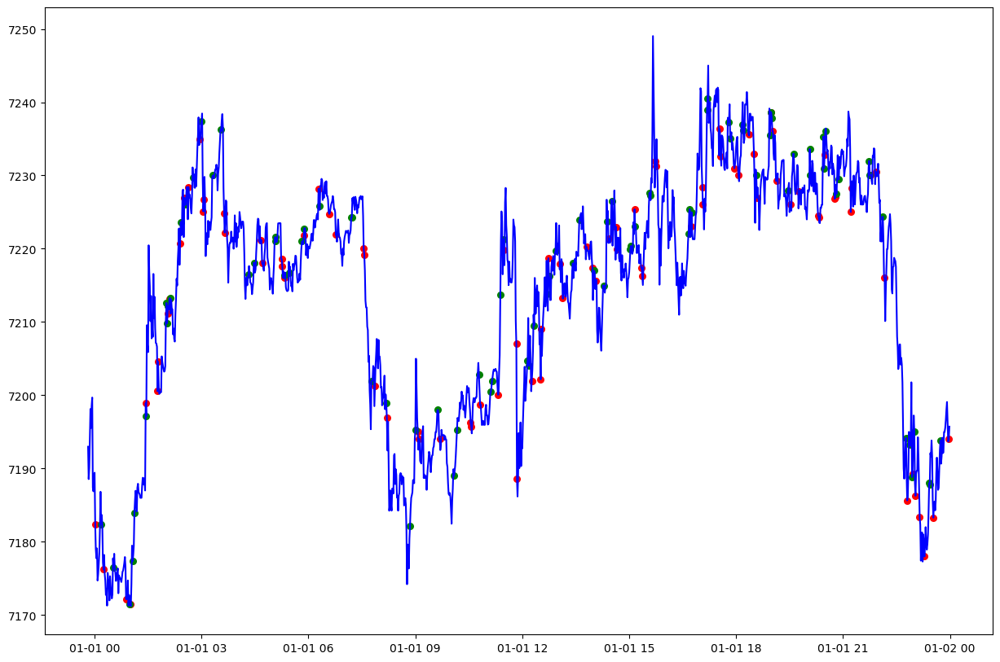

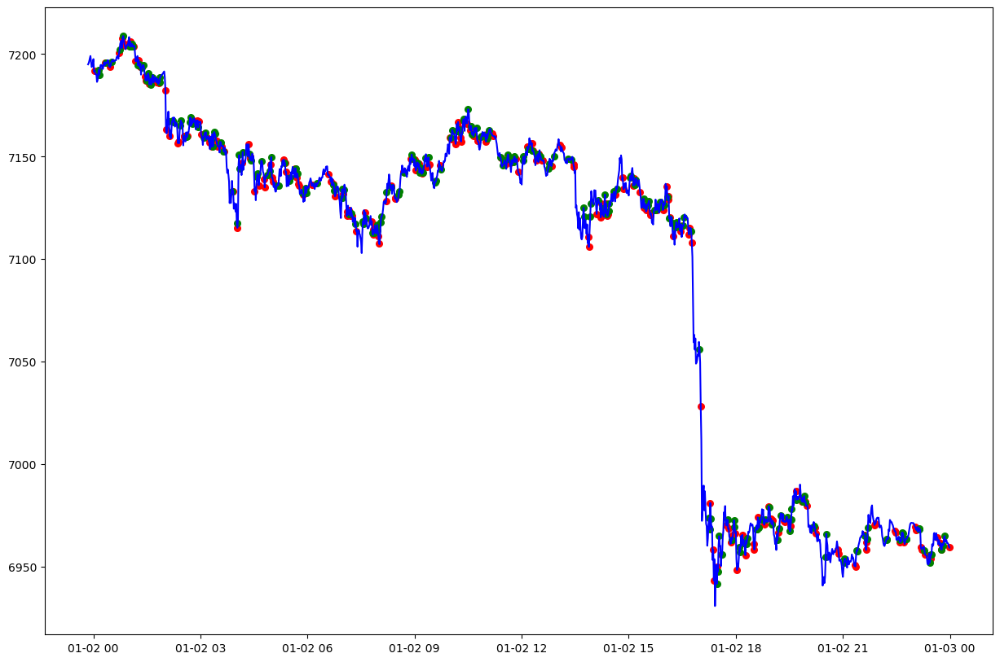

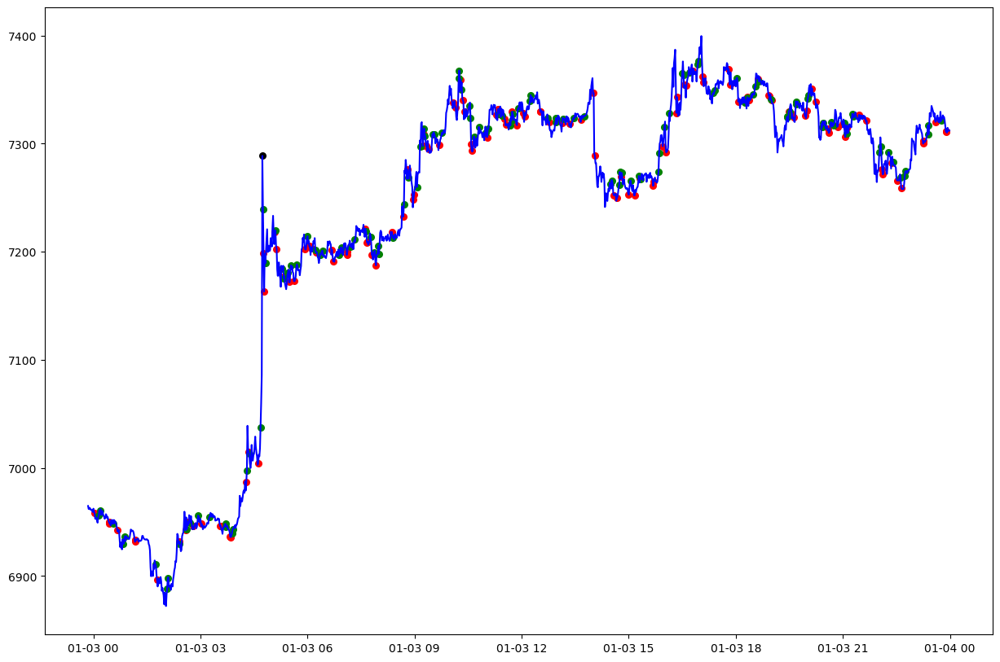

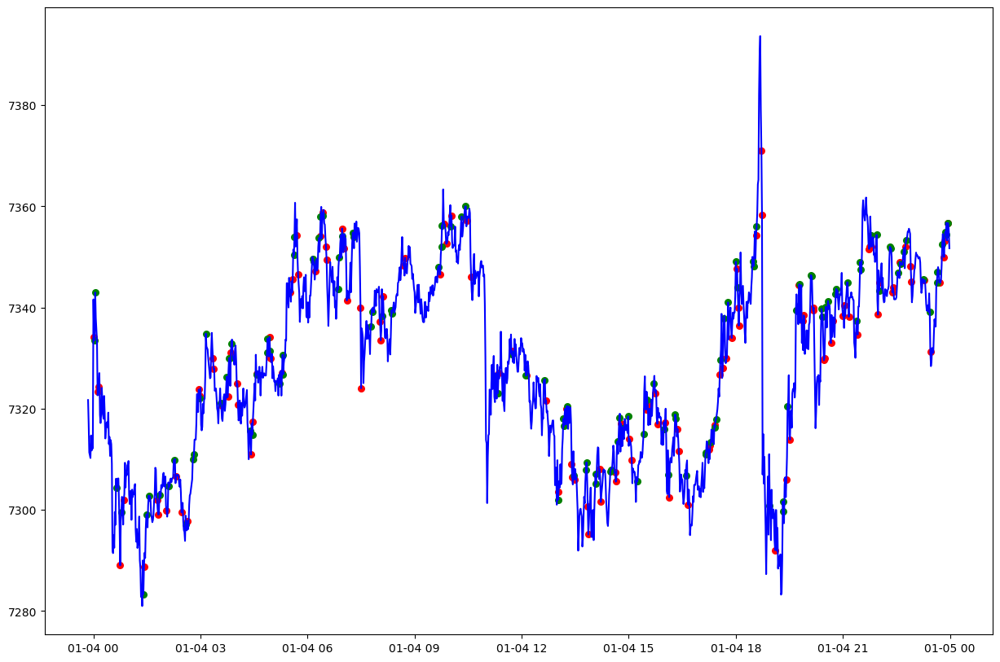

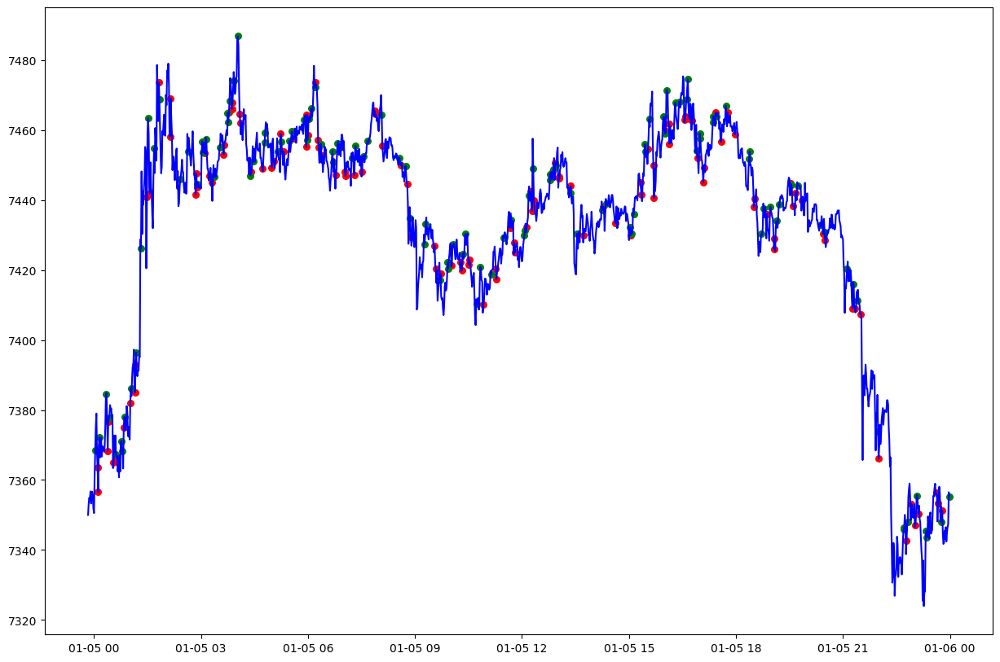

...

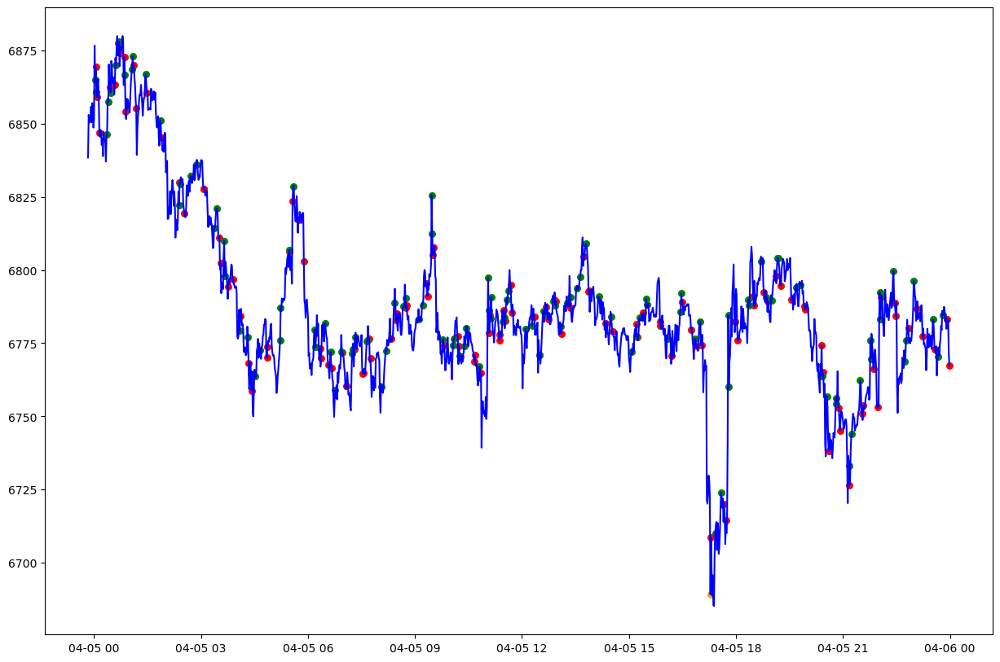

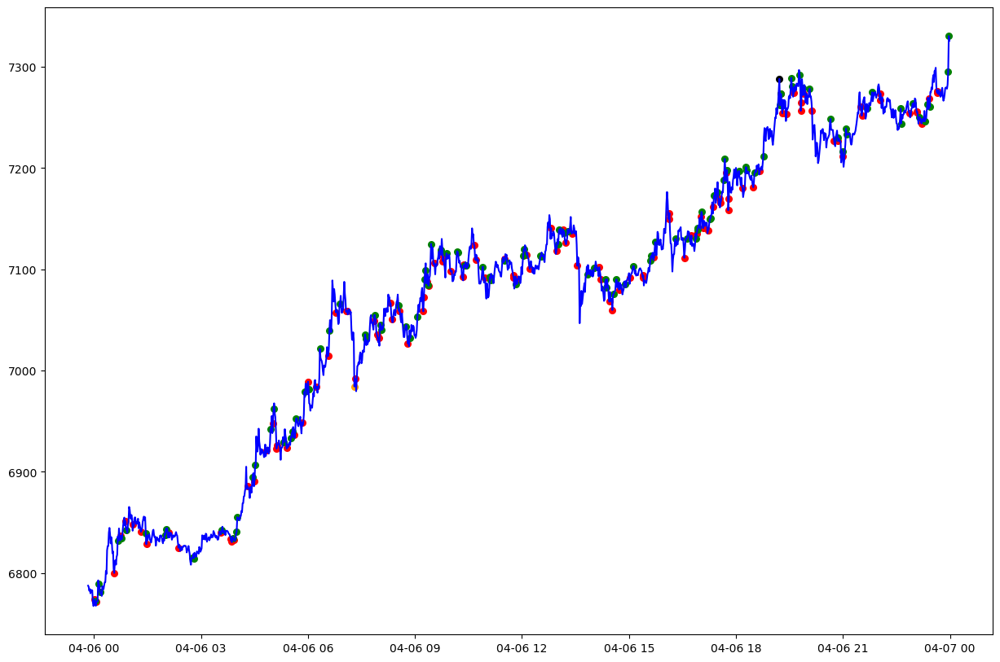

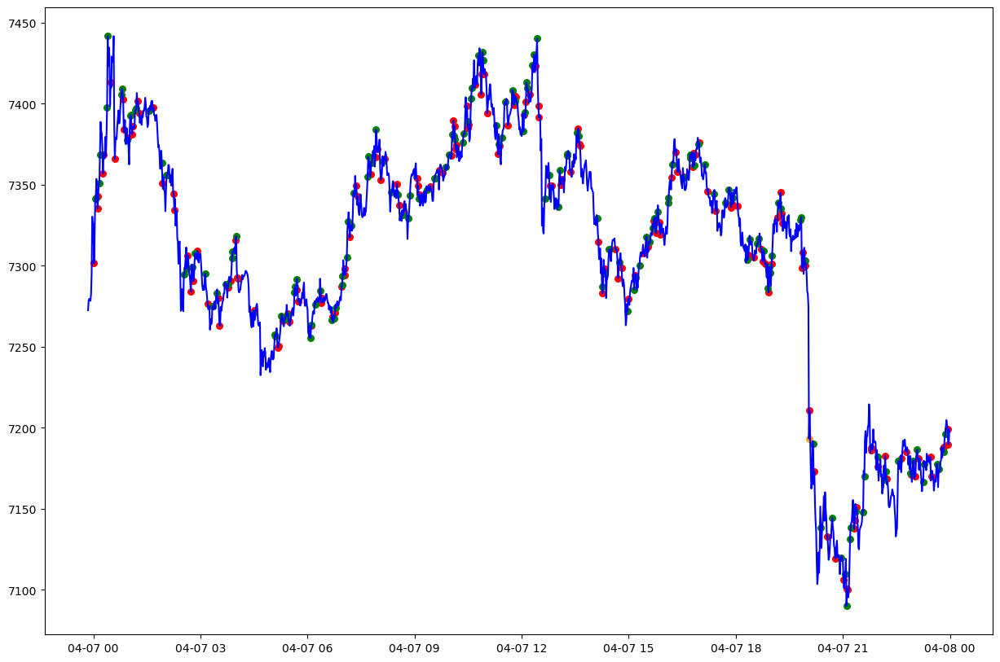

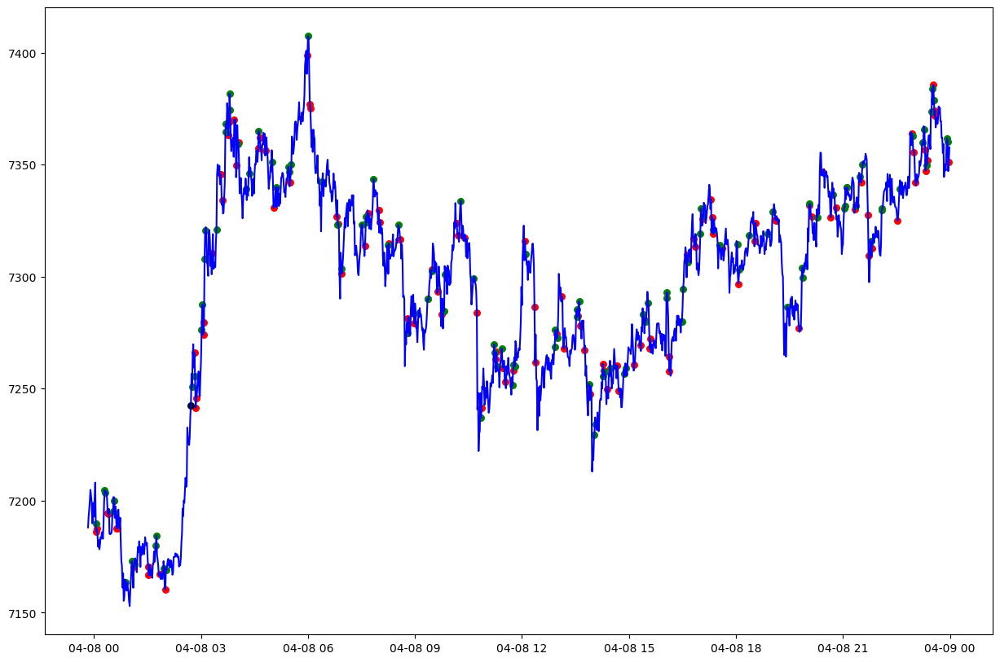

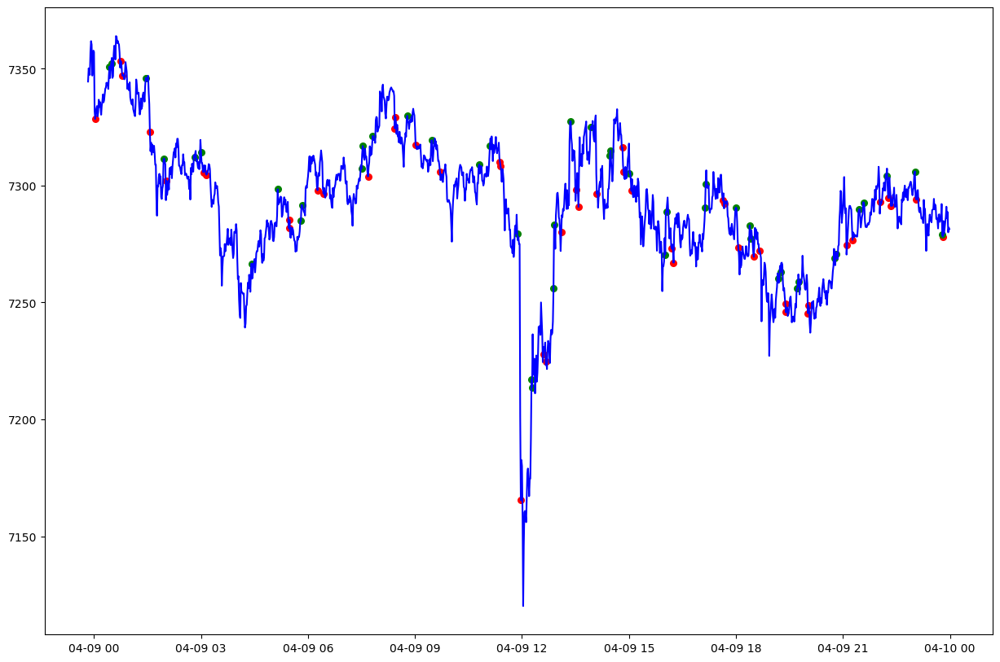

In [ ]:
learning_period_size = 1 * 1440 #3분봉, 1분봉은 1440
testing_period_size= 1 * 1440 #3분봉, 1분봉은 1440

learning_period_list = []
testing_period_list = []

learning_period_list, testing_period_list = split_dataframe(df, learning_period_size, testing_period_size)

pl_list2 = []
df_list2 = []
params_list2 = []

learning_vol_list2 = []
learning_max_diff_list2 = []
learning_mean_diff_list2 = []
learning_minmax_ratio_list2 = []

testing_vol_list2 = []
testing_max_diff_list2 = []
testing_mean_diff_list2 = []
testing_minmax_ratio_list2 = []

index_list = df.index
for i in range(365):
    df_learning = learning_period_list[-365+i]
    df_testing = testing_period_list[-365+i]
    print('learning period : ' , df_learning.index[0], ' ~ ', df_learning.index[-1])
    print('testing period : ' , df_testing.index[0], ' ~ ', df_testing.index[-1])

    tech = technical_indicator(df_learning['Close'], df_learning['Open'], df_learning['High'], df_learning['Low'], df_learning['Volume'])

    learning_vol_list2.append(tech.period_vol()[0])
    learning_max_diff_list2.append(tech.period_vol()[1])
    learning_mean_diff_list2.append(tech.period_vol()[2])
    learning_minmax_ratio_list2.append(tech.period_vol()[3])

    tech_test = technical_indicator(df_testing['Close'], df_testing['Open'], df_testing['High'], df_testing['Low'], df_testing['Volume'])

    testing_vol_list2.append(tech_test.period_vol()[0])
    testing_max_diff_list2.append(tech_test.period_vol()[1])
    testing_mean_diff_list2.append(tech_test.period_vol()[2])
    testing_minmax_ratio_list2.append(tech_test.period_vol()[3])


    #n, m, k, d, b, fsd
    init_params = [10, 10, 5, 10, 20, 2]
    dema = tech.dema(init_params[0])
    hbar = tech.hbar(init_params[1])
    iv = tech.iv(init_params[2], init_params[3])
    multiple = tech.sma(init_params[4], init_params[5])[3]
    
    upper_multiple = [i for i in multiple if i>init_params[5]]
    lower_multiple = [i for i in multiple if i<-init_params[5]]

    if (len(upper_multiple) < 2) or (len(lower_multiple) < 2):
        init_params[5] = (get_boundaries(multiple,8)[6]-get_boundaries(multiple,8)[2])/2

    e_series_initial = E_H_series_initial(dema)
    h_series_initial = E_H_series_initial(hbar)
    iv_series_initial = iV_series_initial(iv)        
    b_series_initial = B_series_initial(init_params[4], init_params[5], multiple)

    initials = [init_params[0]] + e_series_initial + [init_params[1]] + h_series_initial + [init_params[2], init_params[3]] + iv_series_initial + [init_params[4], init_params[5]] + b_series_initial

    cons = [{'type': 'ineq', 'fun': lambda parameters: parameters[8] - parameters[7]}, {'type': 'ineq', 'fun': lambda parameters: parameters[7] - parameters[6]}, {'type': 'ineq', 'fun': lambda parameters: parameters[6] - parameters[5]}, {'type': 'ineq', 'fun': lambda parameters: parameters[4] - parameters[3]},
            {'type': 'ineq', 'fun': lambda parameters: parameters[3] - parameters[2]}, {'type': 'ineq', 'fun': lambda parameters: parameters[2] - parameters[1]}, {'type': 'ineq', 'fun': lambda parameters: parameters[17] - parameters[16]}, {'type': 'ineq', 'fun': lambda parameters: parameters[16] - parameters[15]}, 
            {'type': 'ineq', 'fun': lambda parameters: parameters[15] - parameters[14]}, {'type': 'ineq', 'fun': lambda parameters: parameters[13] - parameters[12]}, {'type': 'ineq', 'fun': lambda parameters: parameters[12] - parameters[11]}, {'type': 'ineq', 'fun': lambda parameters: parameters[11] - parameters[10]},
            {'type': 'ineq', 'fun': lambda parameters: parameters[23] - parameters[22]}, {'type': 'ineq', 'fun': lambda parameters: parameters[22] - parameters[21]}, {'type': 'ineq', 'fun': lambda parameters: parameters[21] - parameters[20]}, {'type': 'ineq', 'fun': lambda parameters: parameters[33] - parameters[32]}, 
            {'type': 'ineq', 'fun': lambda parameters: parameters[32] - parameters[31]}, {'type': 'ineq', 'fun': lambda parameters: parameters[31] - parameters[30]}, {'type': 'ineq', 'fun': lambda parameters: parameters[30] - parameters[29]}, {'type': 'ineq', 'fun': lambda parameters: parameters[29] - parameters[28]}, 
            {'type': 'ineq', 'fun': lambda parameters: parameters[28] - parameters[27]}, {'type': 'ineq', 'fun': lambda parameters: parameters[27] - parameters[26]}, {'type': 'ineq', 'fun': lambda parameters: parameters[19] - parameters[18]}, {'type': 'ineq', 'fun': lambda parameters: parameters[32] - init_params[5]}, 
            {'type': 'ineq', 'fun': lambda parameters: init_params[5] - parameters[31]}, {'type': 'ineq', 'fun': lambda parameters: parameters[28] + init_params[5]}, {'type': 'ineq', 'fun': lambda parameters: - init_params[5] - parameters[27]}]

    bounds = [(0, 30), (None, 0), (None, 0), (None, 0), (None, 0), (0, None), (0, None), (0, None), (0, None),    
                (0, 30), (None, 0), (None, 0), (None, 0), (None, 0), (0, None), (0, None), (0, None), (0, None),
                (0, 30), (0, 30), (0.9, 1.1), (0, None), (0, None), (0, None),
                (0, 30), (0.9, 3.1), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None), (None, None)]

    sol = optimize.minimize(lambda x: profit_optimization(x, df_learning), initials, method = 'COBYLA', bounds=bounds, constraints=cons)
    max_period = round(min([sol.x[0], sol.x[9], sol.x[19], sol.x[24]]))
    idx_num = index_list.get_loc(df_testing.index[0])
    prior_index = index_list[idx_num-max_period]
    df_extend_testing = df.loc[prior_index:df_testing.index[-1]]
    
    pnl, df_temp = profit_calculation(list(sol.x), df_extend_testing)
    pl_list2.append(pnl)
    df_list2.append(df_temp)
    params_list2.append(list(sol.x))

In [23]:
learning_vol_list
learning_max_diff_list
learning_mean_diff_list
learning_minmax_ratio_list


testing_vol_list
testing_max_diff_list
testing_mean_diff_list
testing_minmax_ratio_list

vol_dict = {'pnl':pl_list, 'learning_vol':learning_vol_list, 'learning_max_diff':learning_max_diff_list, 'learning_mean_diff':learning_mean_diff_list, 'learning_minmax_ratio':learning_minmax_ratio_list,
            'testing_vol':testing_vol_list, 'testing_max_diff':testing_max_diff_list, 'testing_mean_diff':testing_mean_diff_list, 'testing_minmax_ratio':testing_minmax_ratio_list}

In [24]:
df_pl = pd.DataFrame(vol_dict, columns = ['pnl', 'learning_vol', 'learning_max_diff', 'learning_mean_diff', 'learning_minmax_ratio', 'testing_vol', 'testing_max_diff', 'testing_mean_diff', 'testing_minmax_ratio'])
df_pl['learnig_testing_vol_ratio'] = df_pl['testing_vol']/df_pl['learning_vol']

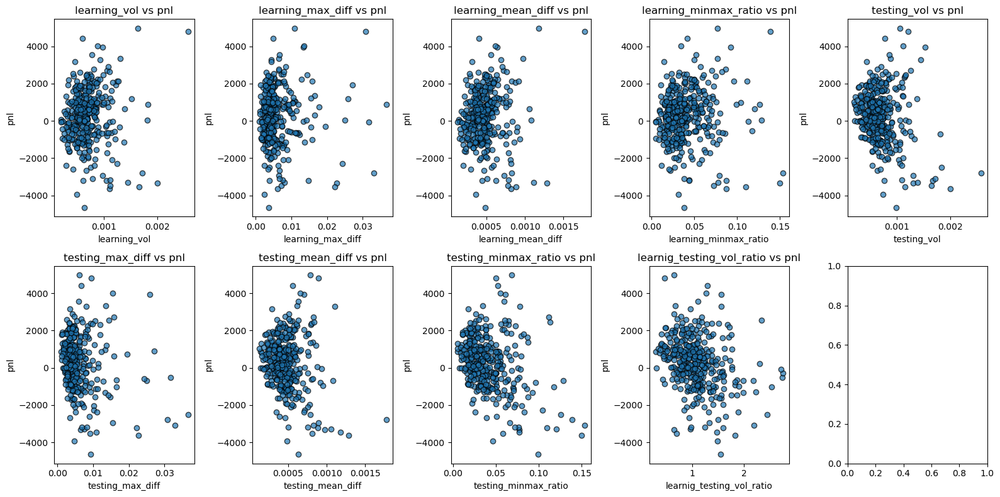

In [25]:
columns_to_compare = [col for col in df_pl.columns if col != 'pnl']  # pnl을 제외한 컬럼
fig, axes = plt.subplots(2, 5, figsize=(16, 8))  # 2행 4열의 서브플롯

for ax, col in zip(axes.flatten(), columns_to_compare):
    ax.scatter(df_pl[col], df_pl['pnl'], alpha=0.7, edgecolors='k')  # 산점도
    ax.set_title(f"{col} vs pnl")
    ax.set_xlabel(col)
    ax.set_ylabel('pnl')

plt.tight_layout()  # 레이아웃 조정
plt.show()

In [26]:
df_pl.to_excel('-5% 포지션 청산 -365.xlsx')